## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'coco-indoor' 
TRANSFORM = 'gabor'
CHANNEL = 'blue'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
blue_gabor_indoor_coco.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/michaelmurphy/Documents/GitHub/hierarchical-bayesian-model-validation/results/case-studies/coco/indoor/gabor/blue'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 65536000,
 1: 65536000,
 2: 65536000,
 3: 65536000,
 4: 65536000,
 5: 65536000,
 6: 65536000,
 7: 65536000,
 8: 65536000,
 9: 65536000,
 10: 65536000,
 11: 65536000,
 12: 65536000,
 13: 65536000,
 14: 65536000,
 15: 65536000,
 16: 65536000,
 17: 65536000,
 18: 65536000,
 19: 65536000,
 20: 65536000,
 21: 65536000,
 22: 65536000,
 23: 65536000,
 24: 65536000,
 25: 65536000,
 26: 65536000,
 27: 65536000,
 28: 65536000,
 29: 65536000,
 30: 65536000,
 31: 65536000,
 32: 65536000,
 33: 65536000,
 34: 65536000,
 35: 65536000,
 36: 65536000,
 37: 65536000,
 38: 65536000,
 39: 65536000,
 40: 65536000,
 41: 65536000}

Running 12760 CDFs


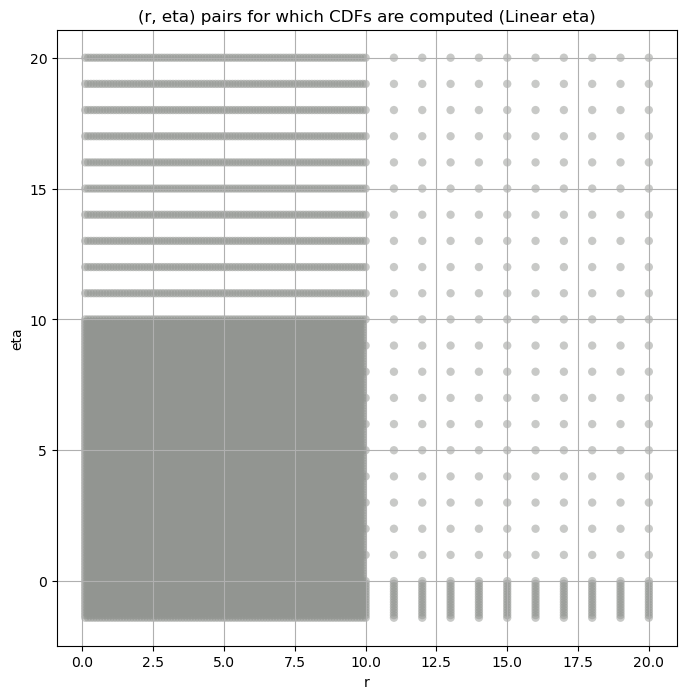

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,45245.52700,35149.957000,55858.81000,5.495759,3.202812,11.596157,65536000.0,"(2.0, 0.5, 0.044)"
1,16159.34800,12461.857000,20982.10400,7.577845,4.145749,20.689200,65536000.0,"(2.0, 0.5, 0.065)"
2,5922.31700,4530.947300,7658.35350,9.172287,4.752912,22.550383,65536000.0,"(2.0, 0.5, 0.096)"
3,2186.18210,1604.981600,2941.15360,11.885174,6.001125,31.736656,65536000.0,"(2.0, 0.5, 0.141)"
4,896.74567,626.061100,1207.41710,14.605139,7.902795,40.446873,65536000.0,"(2.0, 0.5, 0.208)"
5,319.77920,214.653400,441.71838,17.831026,8.364756,54.464200,65536000.0,"(2.0, 0.5, 0.306)"
6,201.80780,138.282550,288.14822,18.420538,9.052644,56.183180,65536000.0,"(2.0, 0.5, 0.45)"
7,62793.04300,49965.652000,79623.72000,6.657730,3.644785,17.155079,65536000.0,"(2.0, 1.0, 0.044)"
8,22699.83200,17202.203000,29541.35500,8.707811,4.386791,26.468680,65536000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,45245.52700,45245.527344,43573.046875,42438.496094,40590.914062
1,16159.34800,16159.347656,15422.288086,14945.790039,14178.371094
2,5922.31700,5922.316895,5622.443359,5425.002930,5111.093750
3,2186.18210,2186.182129,2053.139648,1966.898804,1835.305542
4,896.74567,896.745667,833.837524,795.386292,736.211975
5,319.77920,319.779205,294.960327,279.015045,255.174698
6,201.80780,201.807800,185.686508,175.468384,160.277527
7,62793.04300,62793.042969,60041.023438,58237.281250,55407.878906
8,22699.83200,22699.832031,21534.607422,20784.828125,19628.337891


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.008475029362997988 45245.527


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.008383188582020917 43573.047


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.009345153631302214 42438.496


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.010053575087719535 40590.914
Number of samples: 100000, Without approximation : 65536000.0


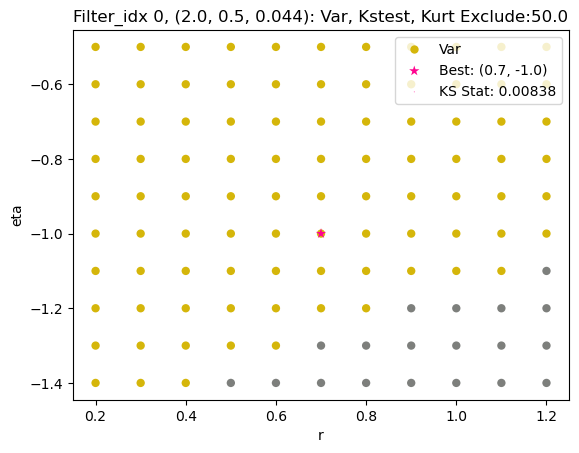

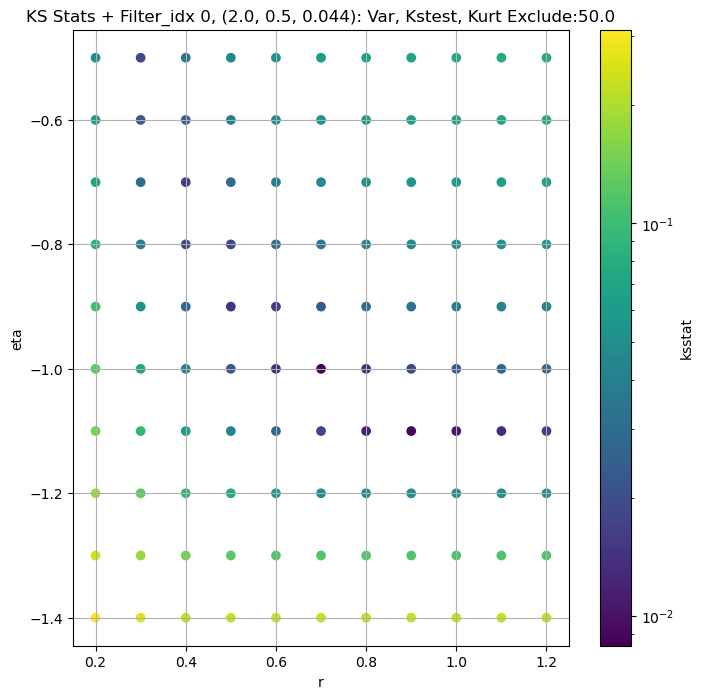

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.007420610924707471 16159.348


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.008046904242938968 15422.288


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.008485546569325986 14945.79


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.008112468280607632 14178.371
Number of samples: 100000, Without approximation : 65536000.0


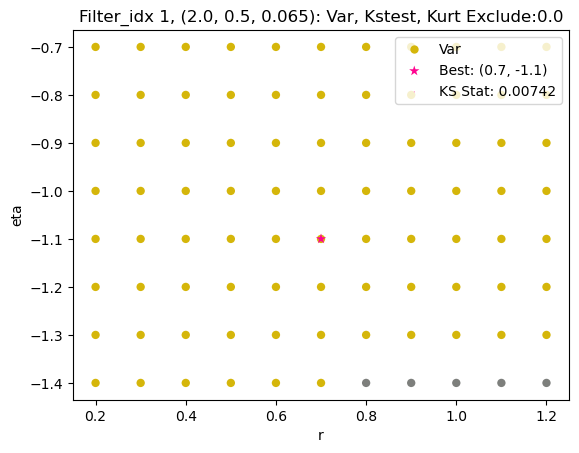

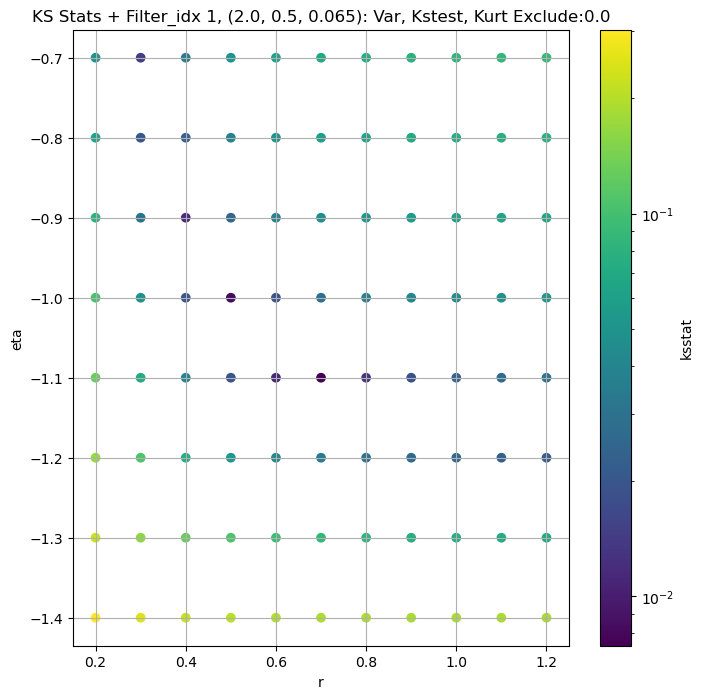

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.010210513146992894 5922.317


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.01107593833088738 5622.4434


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.01109474944487887 5425.003


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.008738316007901425 5111.0938
Number of samples: 100000, Without approximation : 65536000.0


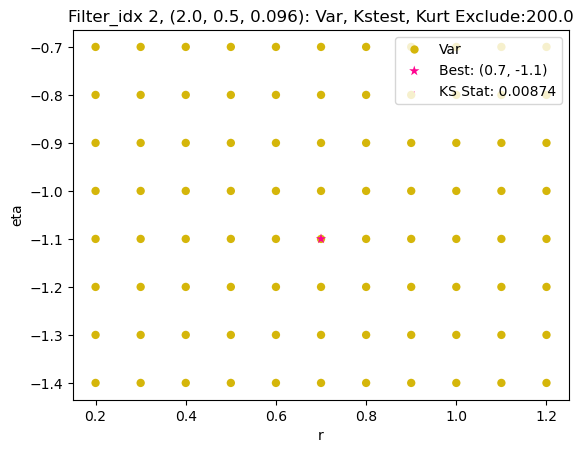

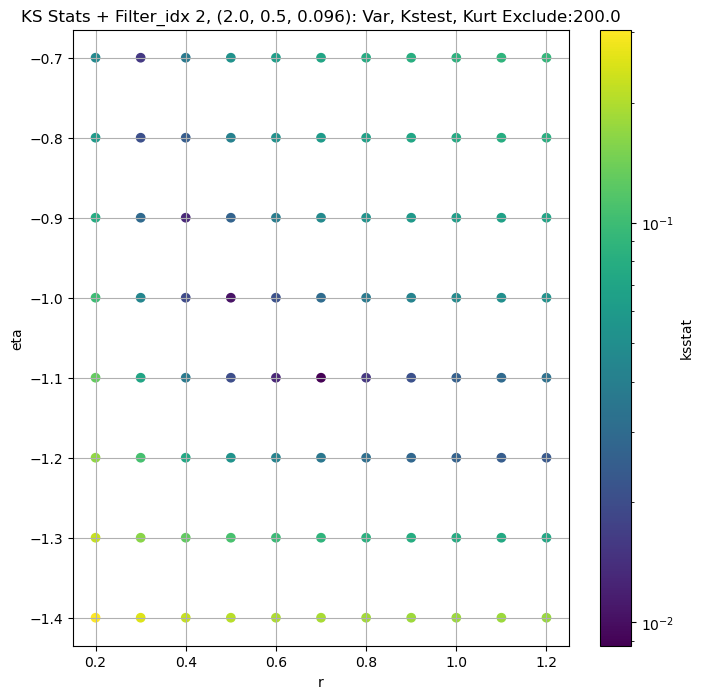

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.006203674707782714 2186.1821


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.007416700343734317 2053.1396


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.00920355378347551 1966.8988


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.009939669735170242 1835.3055
Number of samples: 100000, Without approximation : 65536000.0


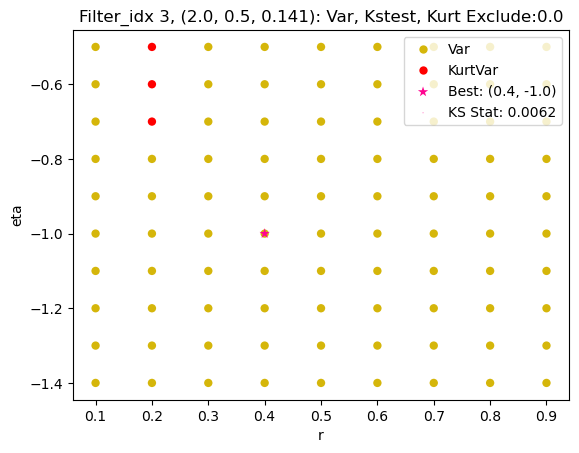

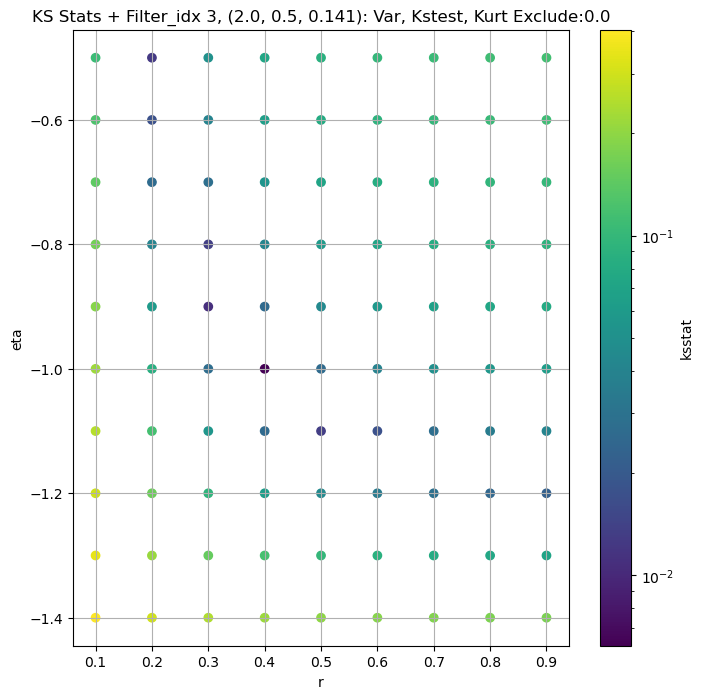

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.00637591046611008 896.74567


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.007427540174344577 833.8375


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.008738145563209787 795.3863


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.008023427039861586 736.212
Number of samples: 100000, Without approximation : 65536000.0


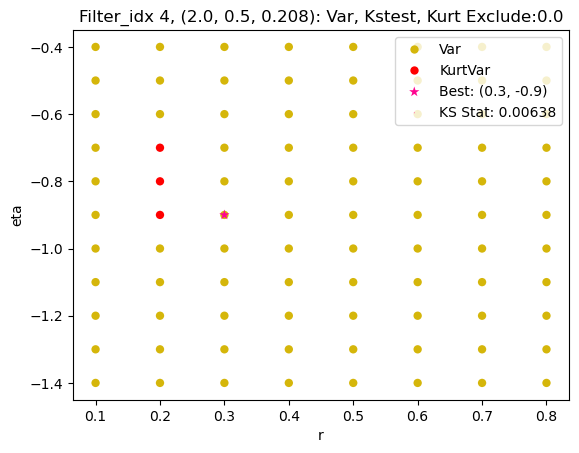

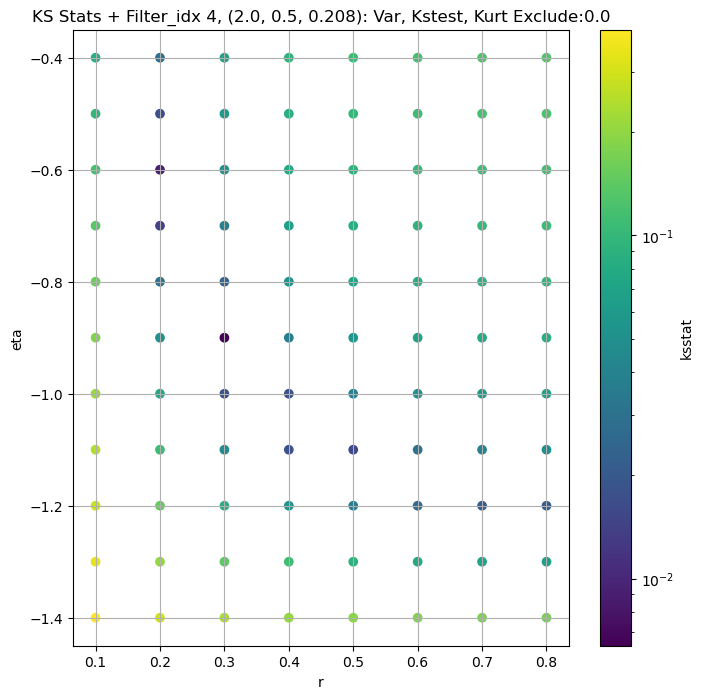

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.008144527405037794 319.7792


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.010965036665051553 294.96033


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.009797000782405973 279.01505


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.008677835345037521 255.1747
Number of samples: 100000, Without approximation : 65536000.0


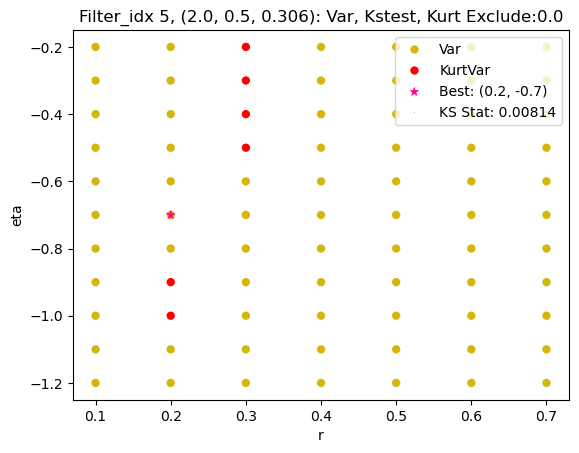

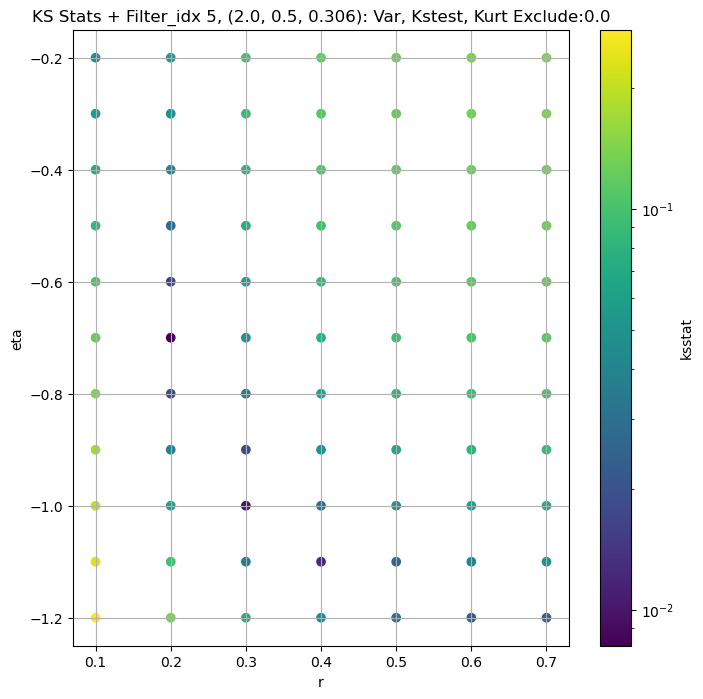

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.009421863686051024 201.8078


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.0099358848677219 185.68651


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.01219624521972984 175.46838


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.012092660839305602 160.27753
Number of samples: 100000, Without approximation : 65536000.0


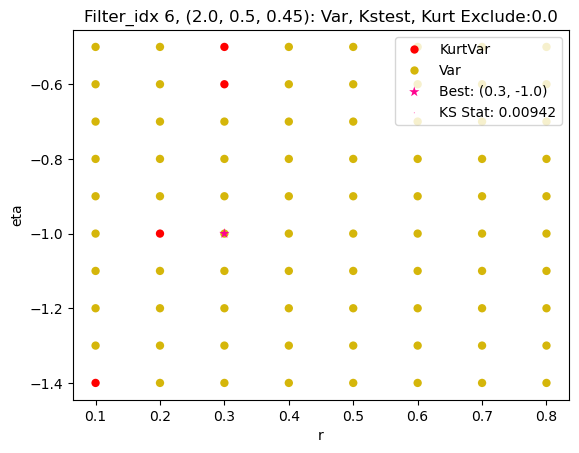

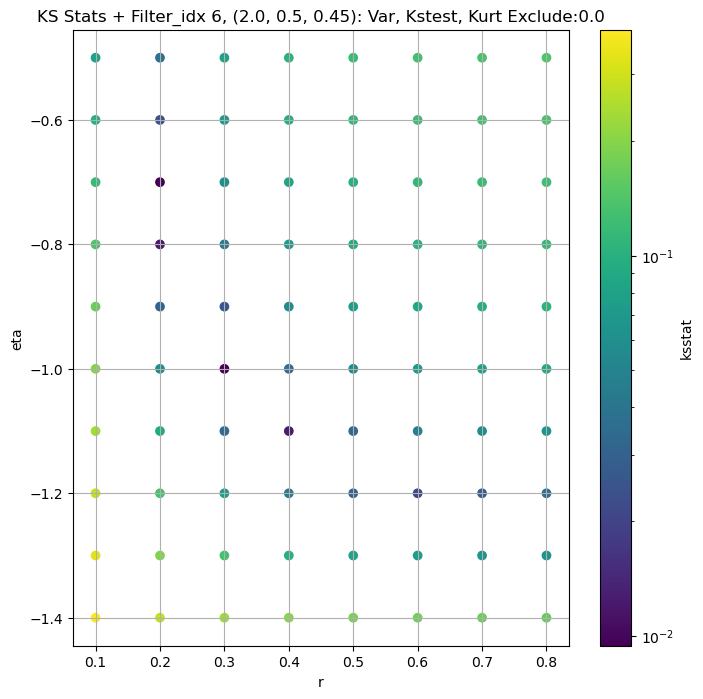

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.002729825785997335 62793.043


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.0051530740271991116 60041.023


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.004672622423077068 58237.28


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.006251457500505597 55407.88
Number of samples: 100000, Without approximation : 65536000.0


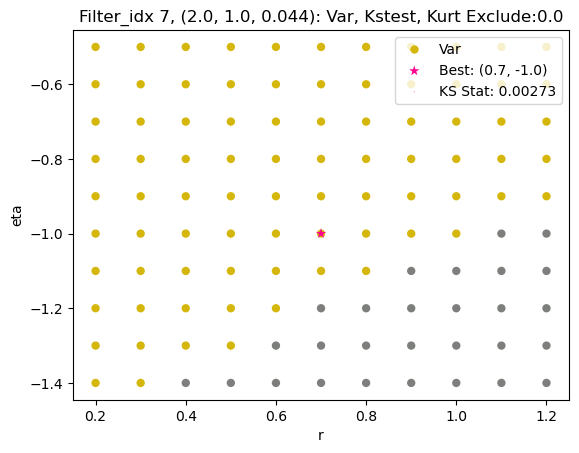

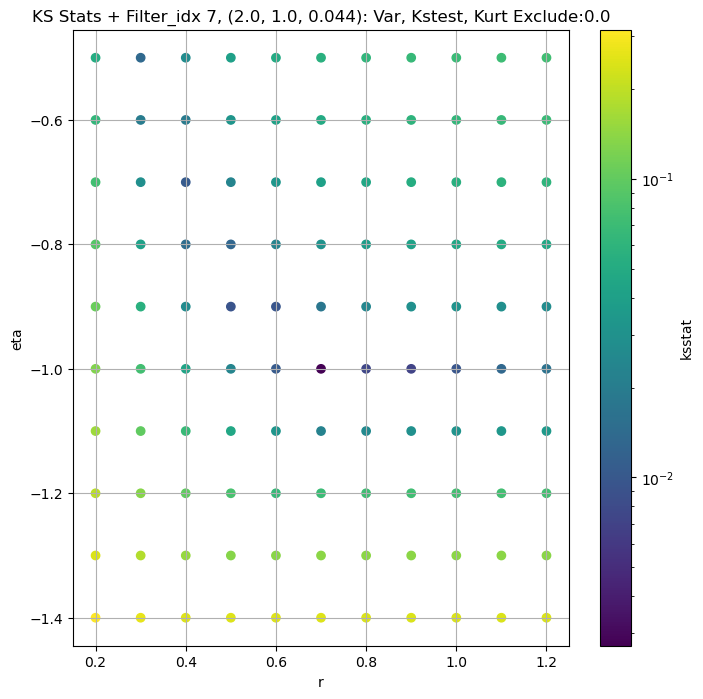

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.007108003472945379 22699.832


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.007810641192441459 21534.607


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.006086789248682334 20784.828


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.0070769515040901565 19628.338
Number of samples: 100000, Without approximation : 65536000.0


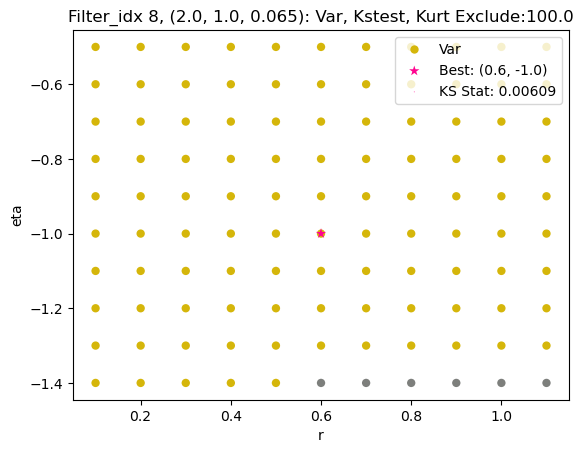

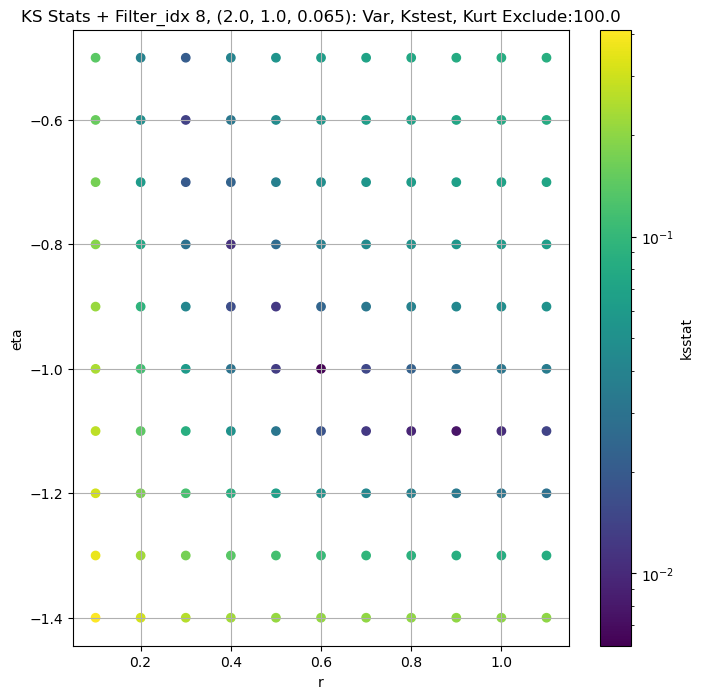

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.009020810961648085 8380.244


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.0058466698230214 7868.4546


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.006416825122060432 7552.395


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.007345380147265268 7079.177
Number of samples: 100000, Without approximation : 65536000.0


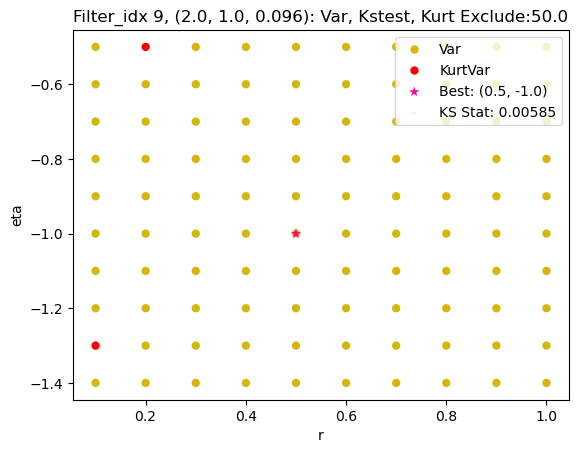

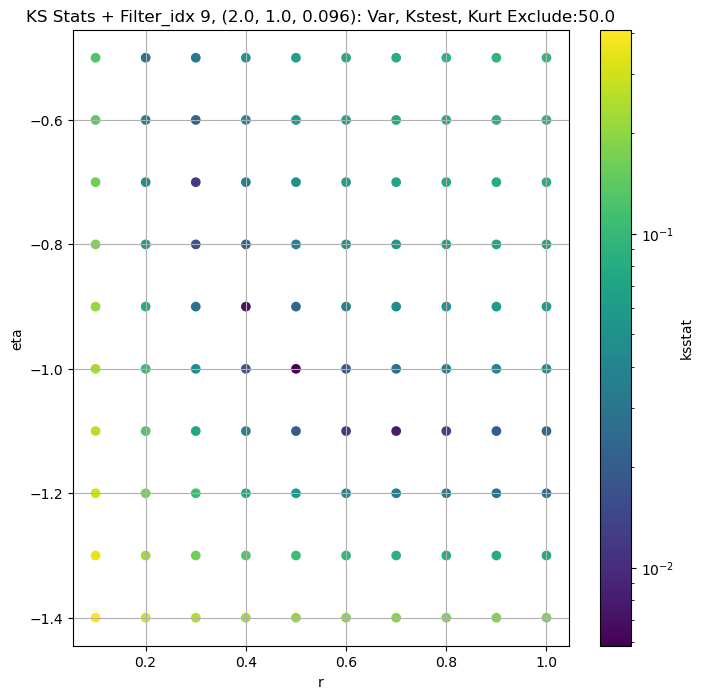

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.0057899935537146785 3242.9932


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.008156440746228788 3017.1343


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.009727478904795528 2880.775


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.009521685450743611 2678.9038
Number of samples: 100000, Without approximation : 65536000.0


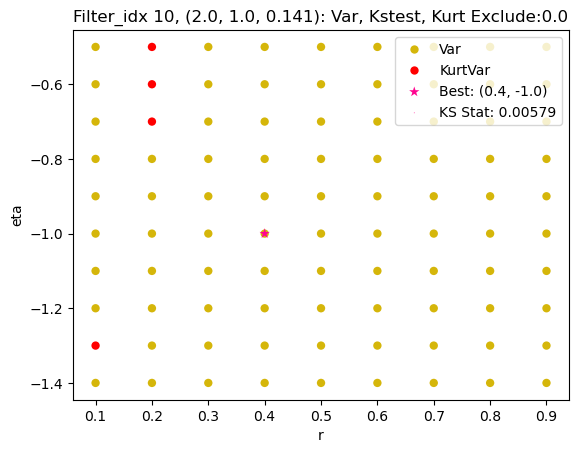

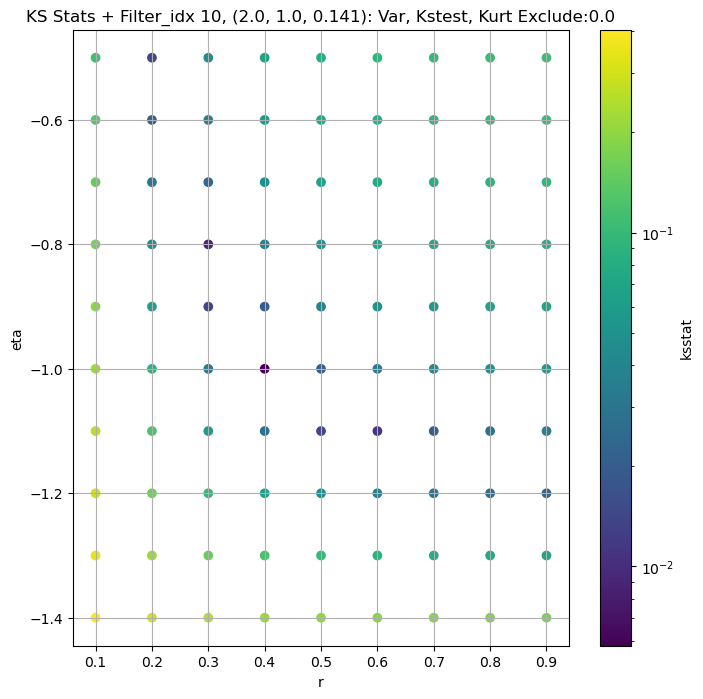

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.004231542979950348 1197.3448


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.006388931567444245 1101.5615


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0048352289180718655 1045.674


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.007891964463127323 961.31885
Number of samples: 100000, Without approximation : 65536000.0


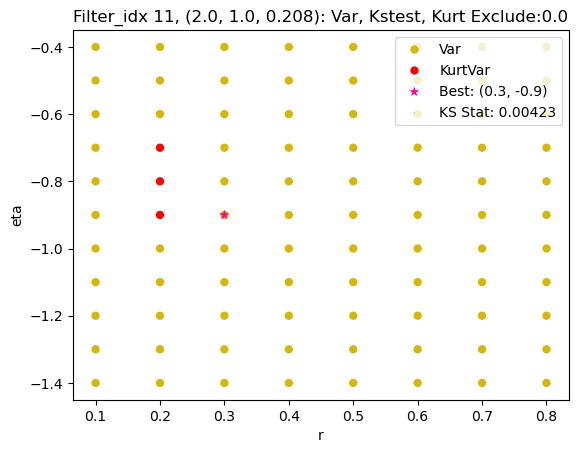

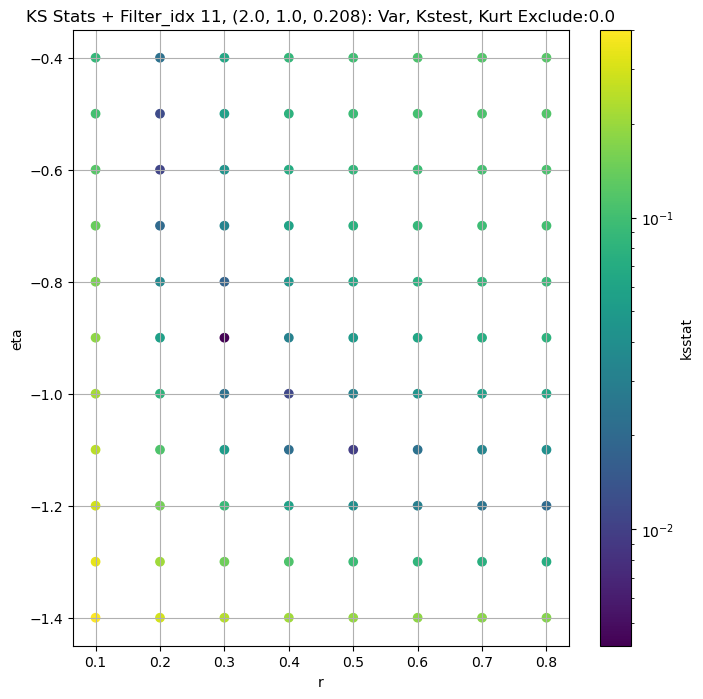

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.008365900544310412 468.3411


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.008260671186770041 423.99335


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.0059108380224865975 398.4909


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.007748512811639574 362.0592
Number of samples: 100000, Without approximation : 65536000.0


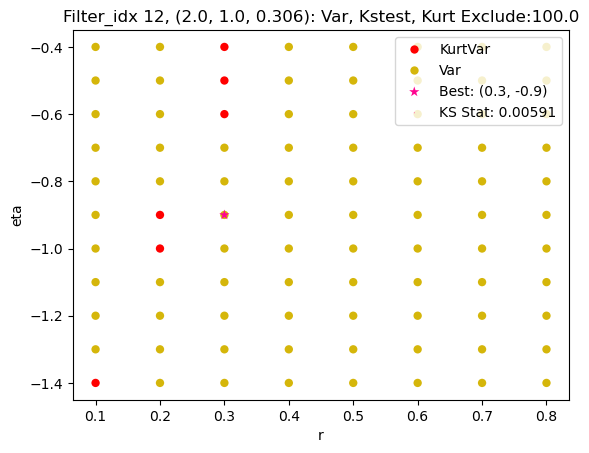

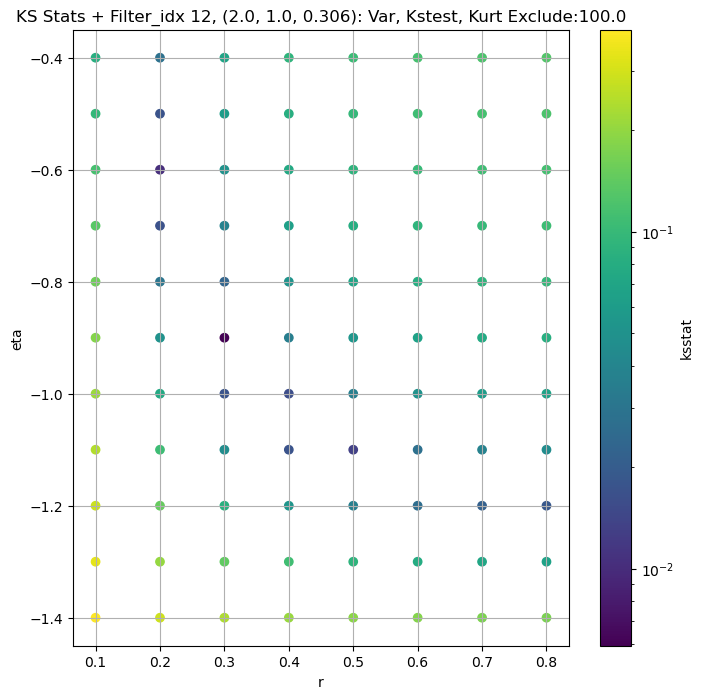

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.01104254956235573 220.53648


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.011021806800863398 196.16138


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.01100863944244379 182.75339


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.011017694746419227 163.39474
Number of samples: 100000, Without approximation : 65536000.0


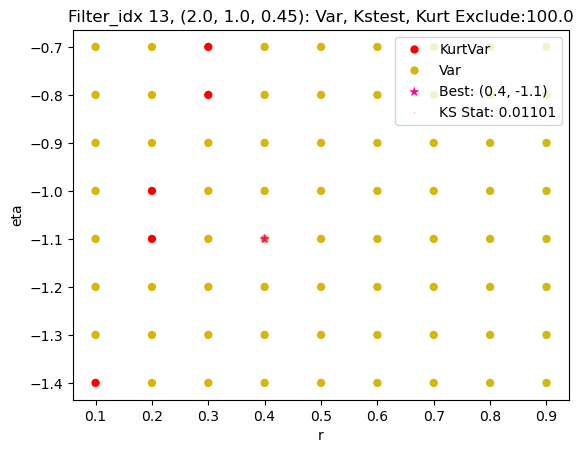

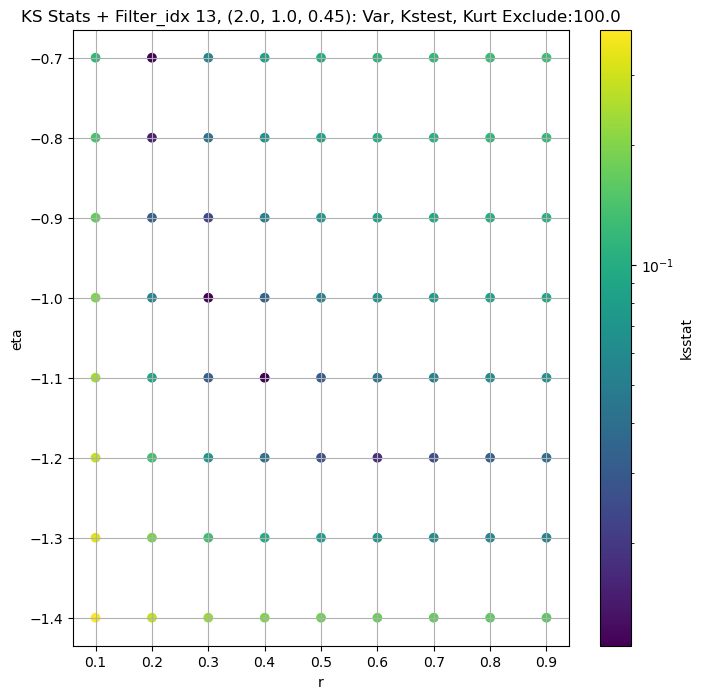

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.007128896602403456 42997.684


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.007128896602403456 41094.066


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.0071656612176901335 39875.125


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.007364811475867213 37962.227
Number of samples: 100000, Without approximation : 65536000.0


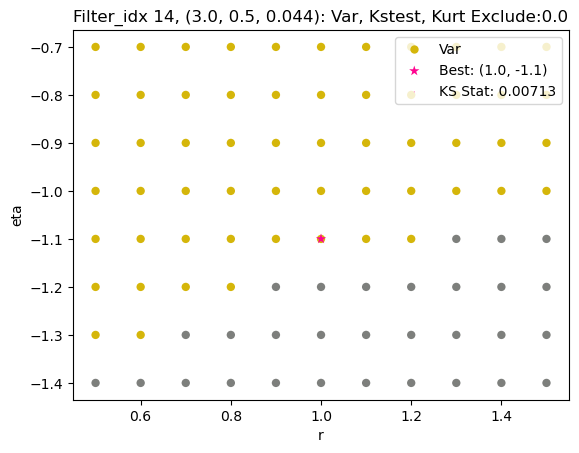

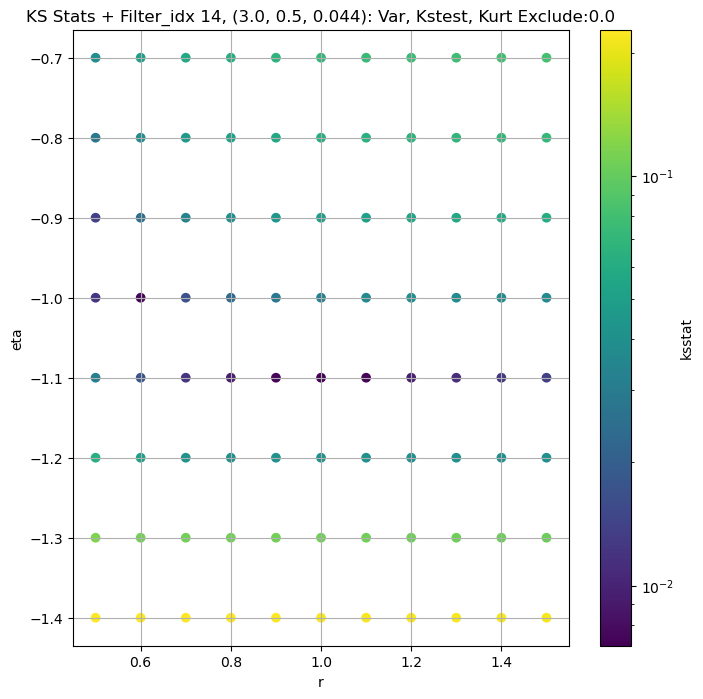

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.010537460754909134 15353.167


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.011344295676149418 14579.726


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.010395965279602404 14078.338


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.009105973571106651 13292.717
Number of samples: 100000, Without approximation : 65536000.0


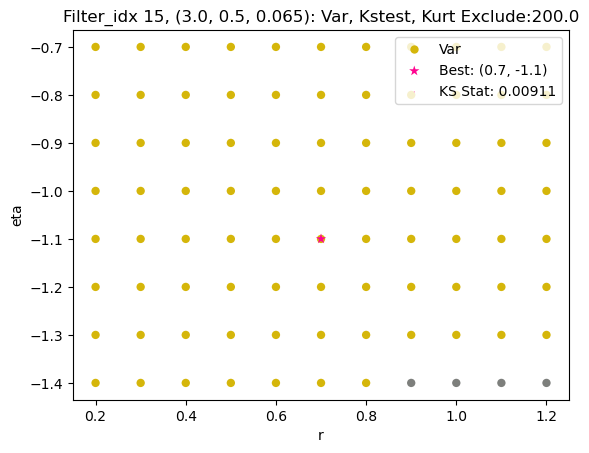

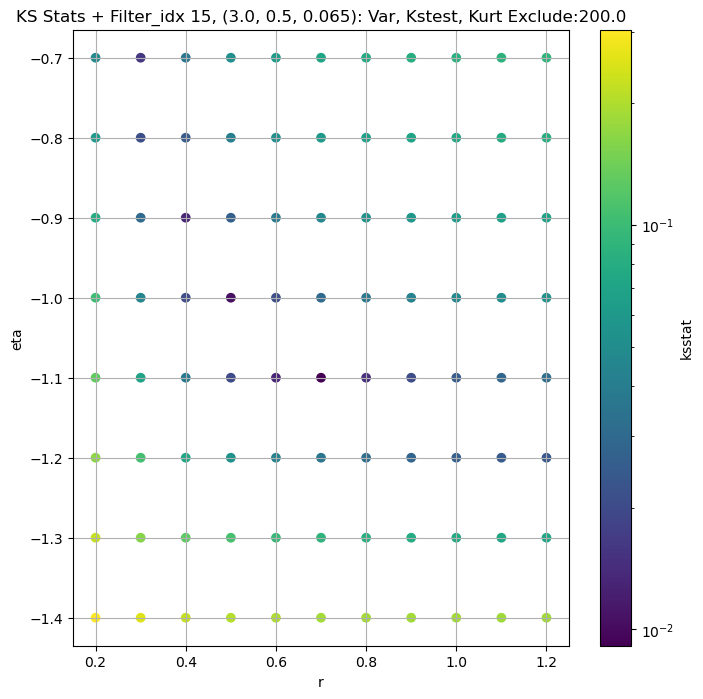

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.009383180397082858 5436.802


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.007152949342375203 5096.322


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.008075027612508334 4885.545


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.010965099900635544 4558.998
Number of samples: 100000, Without approximation : 65536000.0


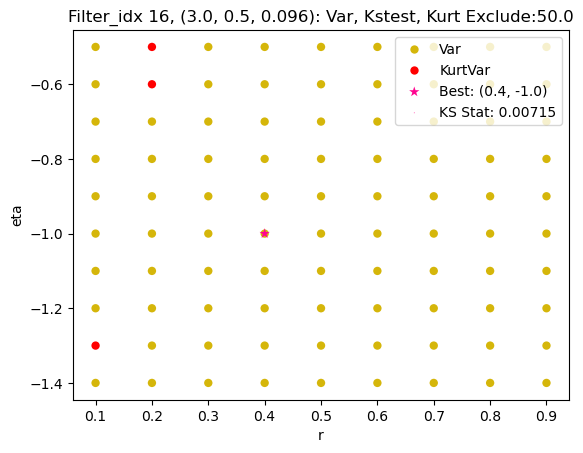

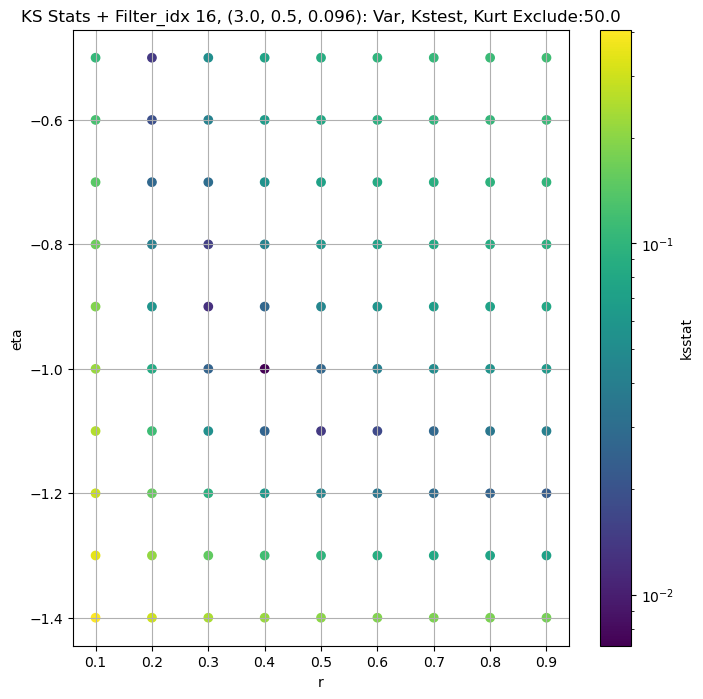

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.008961503431044071 2110.7625


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.007326445478534324 1951.2317


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.009231242380697967 1857.2955


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.009639836909740296 1714.7446
Number of samples: 100000, Without approximation : 65536000.0


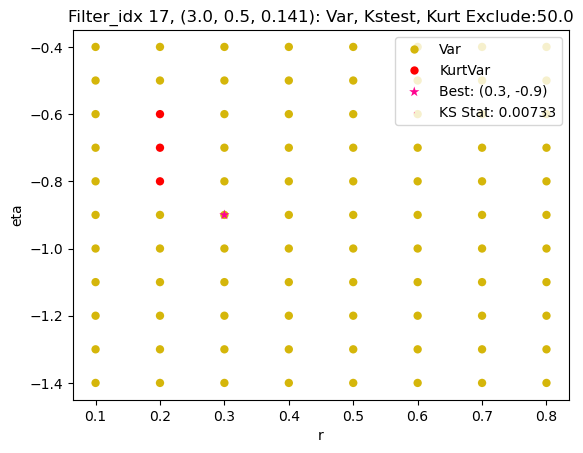

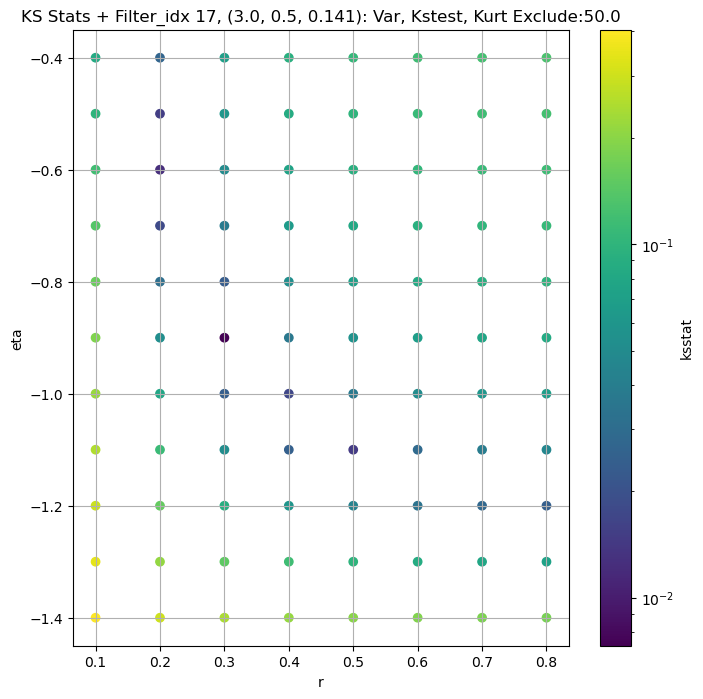

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.005875649717761999 781.5667


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.00888261829047321 713.2414


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.009416465166428134 674.3068


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.009382945276325994 615.86206
Number of samples: 100000, Without approximation : 65536000.0


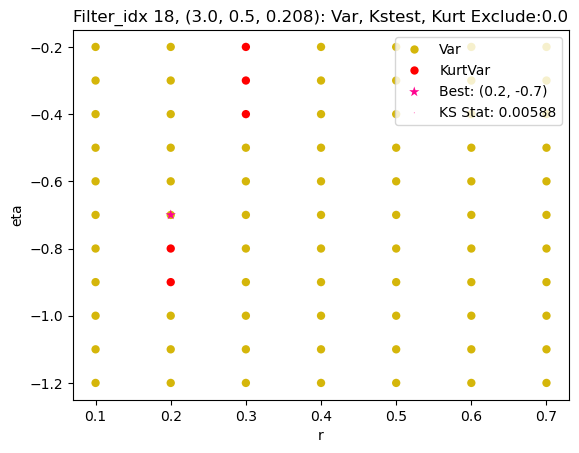

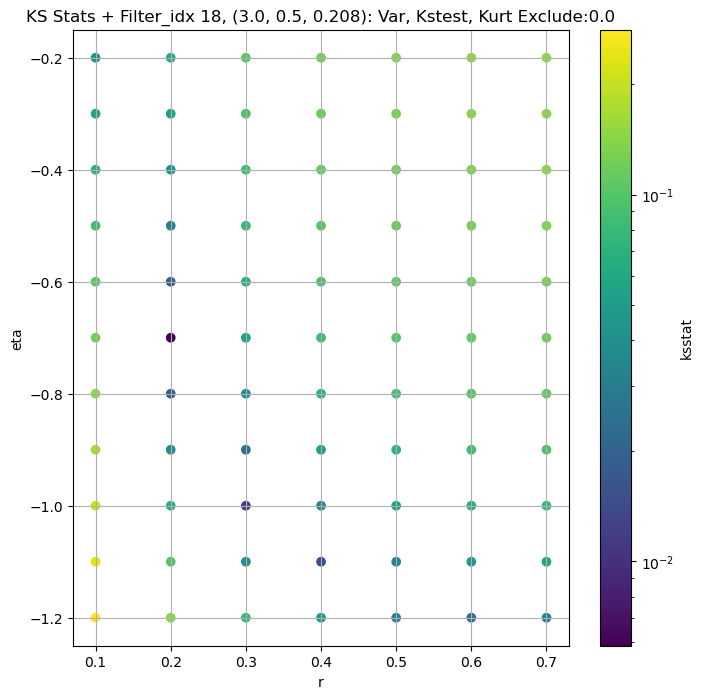

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.0067710400343412025 321.70187


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.005485466669264749 289.95035


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.00710732912967682 272.05826


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.009829433750134342 245.36401
Number of samples: 100000, Without approximation : 65536000.0


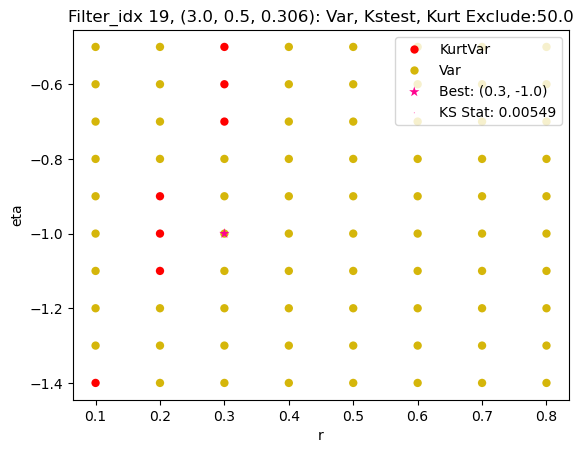

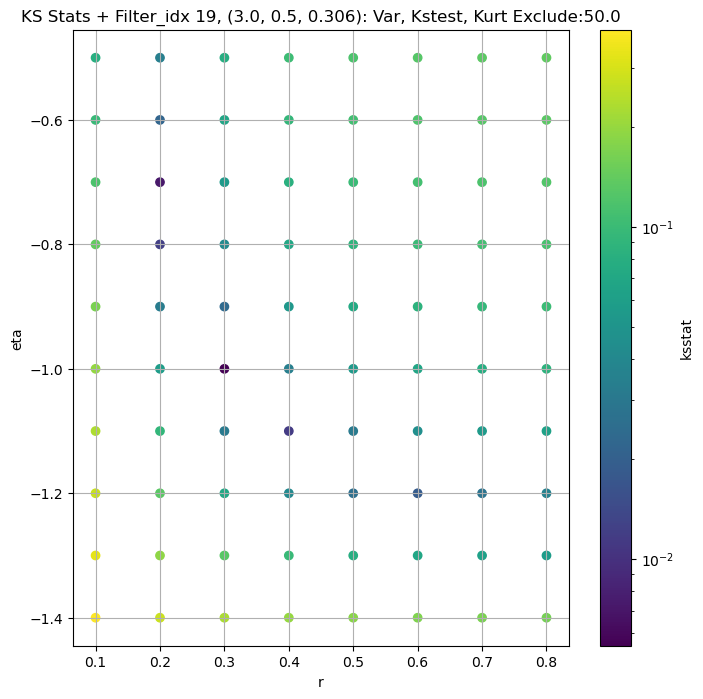

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.008194334735770026 159.4351


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.011944553922842993 141.23535


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.014572741800276123 130.93979


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.011740581808253506 116.20923
Number of samples: 100000, Without approximation : 65536000.0


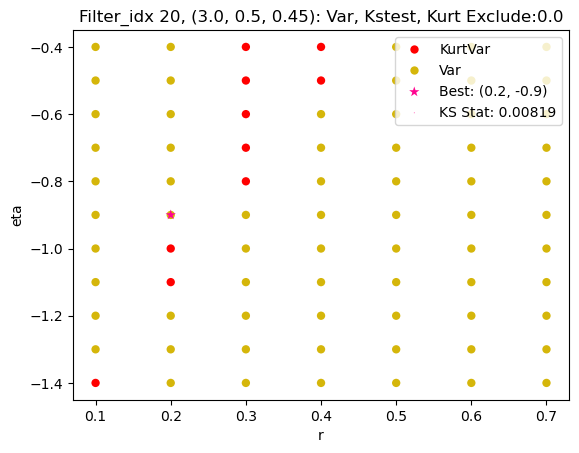

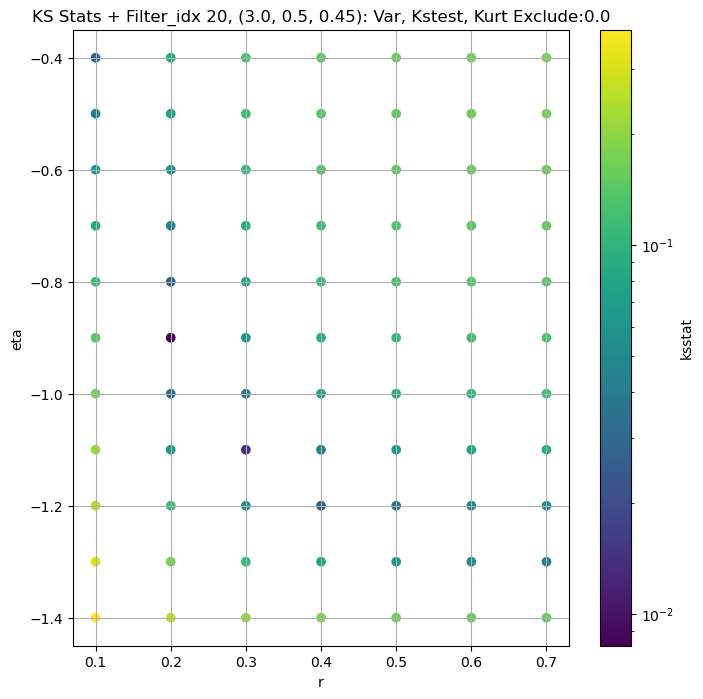

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.006755226723881541 51052.195


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.008346602204792775 47893.63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.009415983139851355 45932.48


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.007175775950807872 42953.484
Number of samples: 100000, Without approximation : 65536000.0


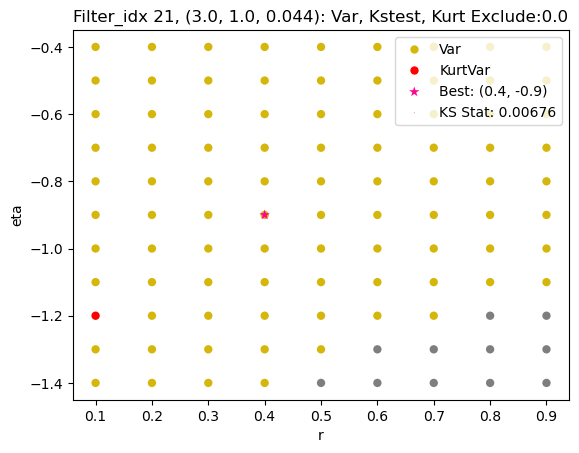

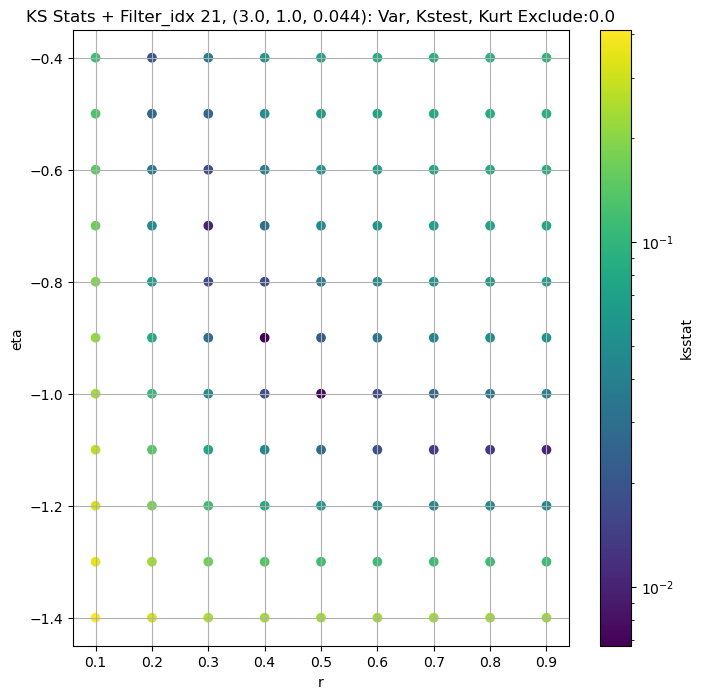

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.007569527004041454 18193.469


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.00974795943811102 16904.166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.012111188970837974 16113.608


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.009307977793317268 14933.772
Number of samples: 100000, Without approximation : 65536000.0


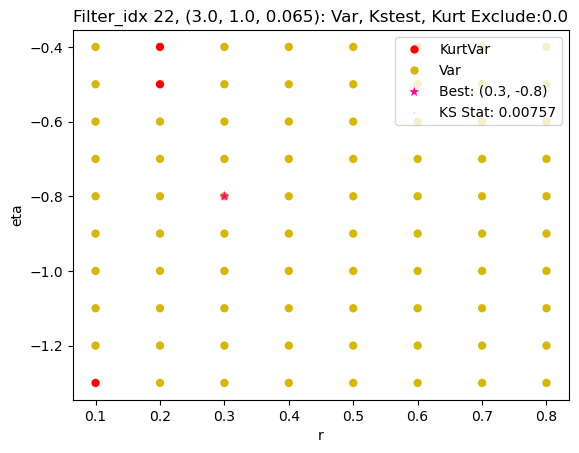

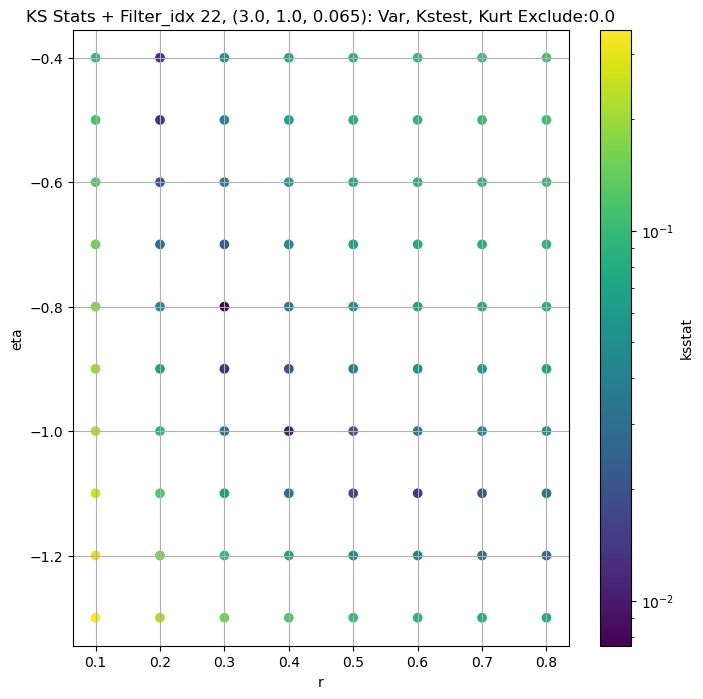

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.006757513588943775 6965.8066


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.00879678204429557 6314.319


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.00860500612005377 5955.3804


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.010325821333656782 5444.6895
Number of samples: 100000, Without approximation : 65536000.0


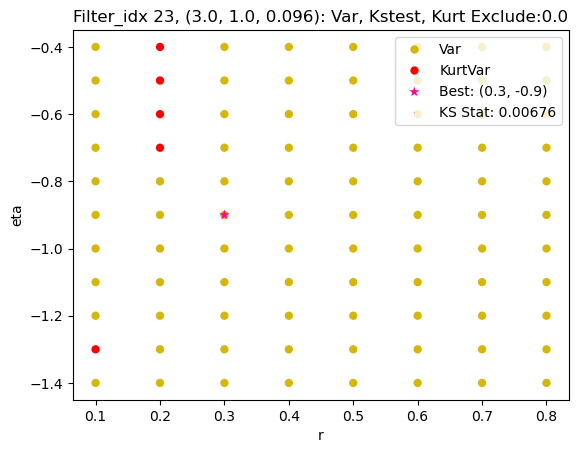

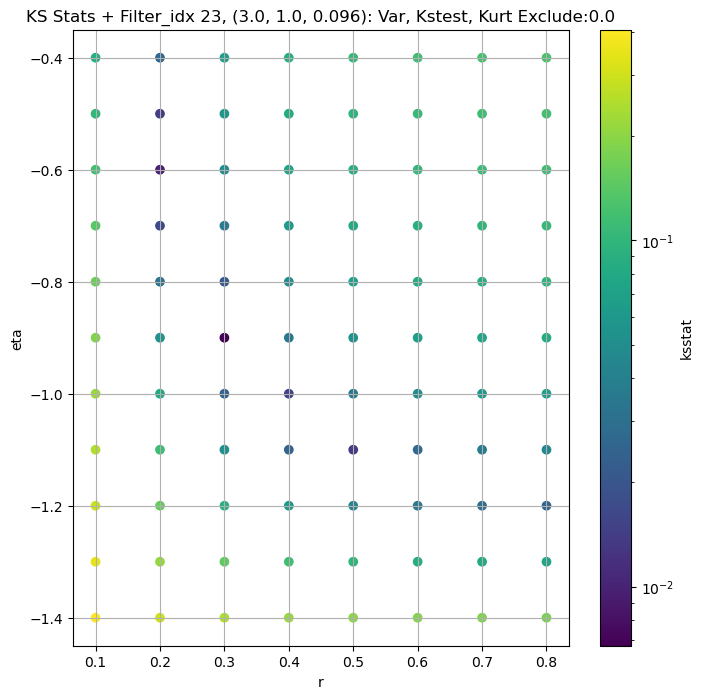

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.008693124460454782 2463.0537


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.007790284120601482 2189.194


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.006897289693441944 2046.6929


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.009752927321834165 1848.487
Number of samples: 100000, Without approximation : 65536000.0


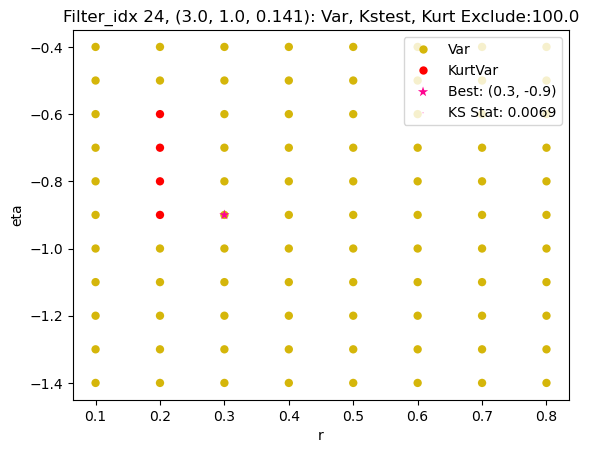

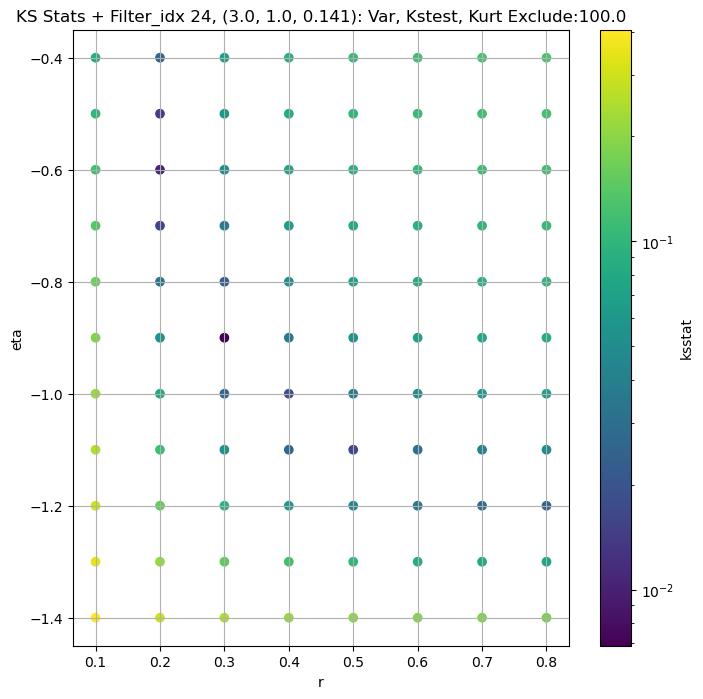

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.0072626787653526925 940.5836


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.006225958499015333 826.4288


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.009059436094078777 766.67505


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.008693704323029822 684.089
Number of samples: 100000, Without approximation : 65536000.0


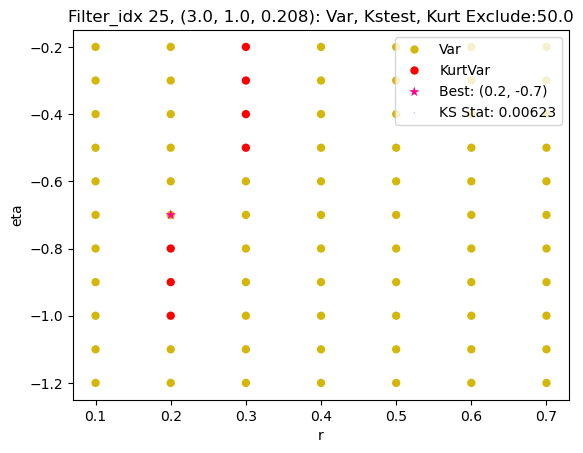

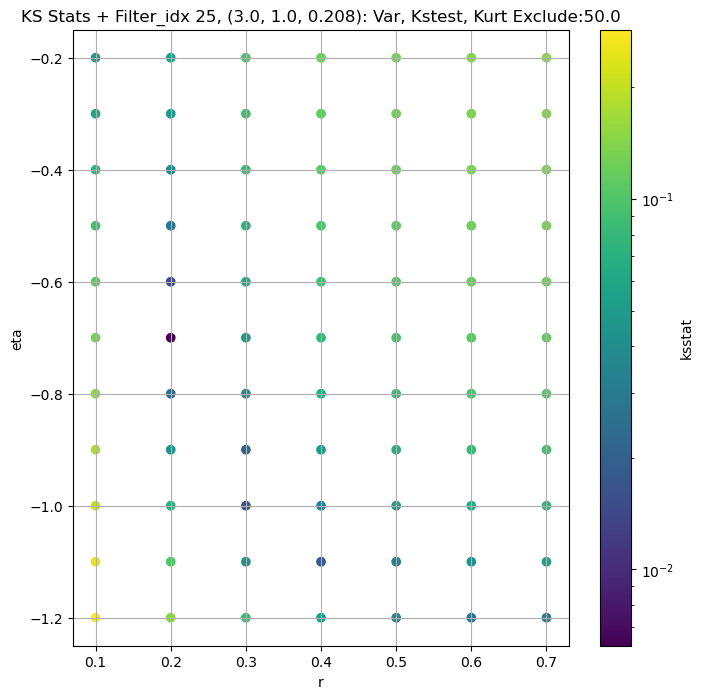

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.006597741240035759 383.1721


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.00854932361741978 328.93344


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.006757431045544271 301.04962


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.008501144547183759 264.25037
Number of samples: 100000, Without approximation : 65536000.0


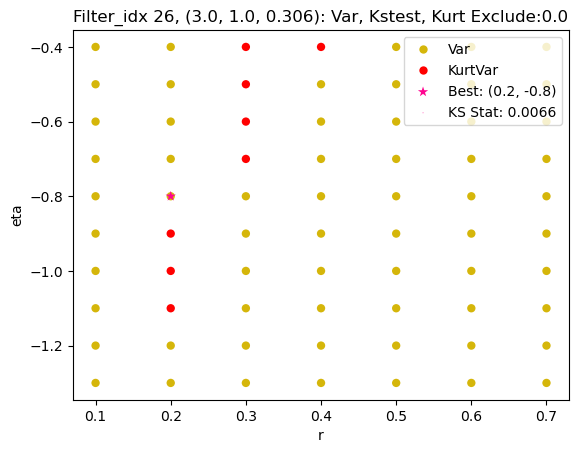

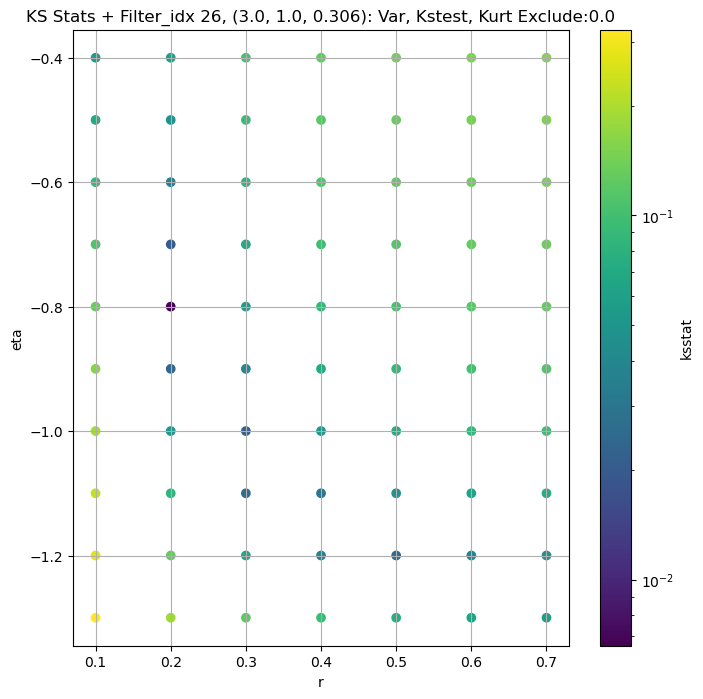

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.009355386627192486 166.43944


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.010719306262343853 141.26663


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.013054578693819763 128.35474


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.009397891521759627 111.557755
Number of samples: 100000, Without approximation : 65536000.0


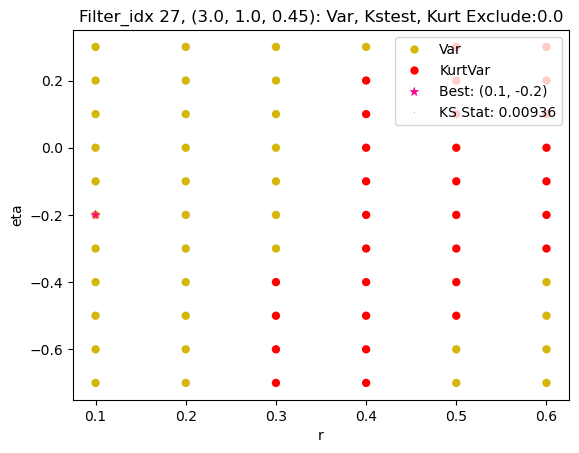

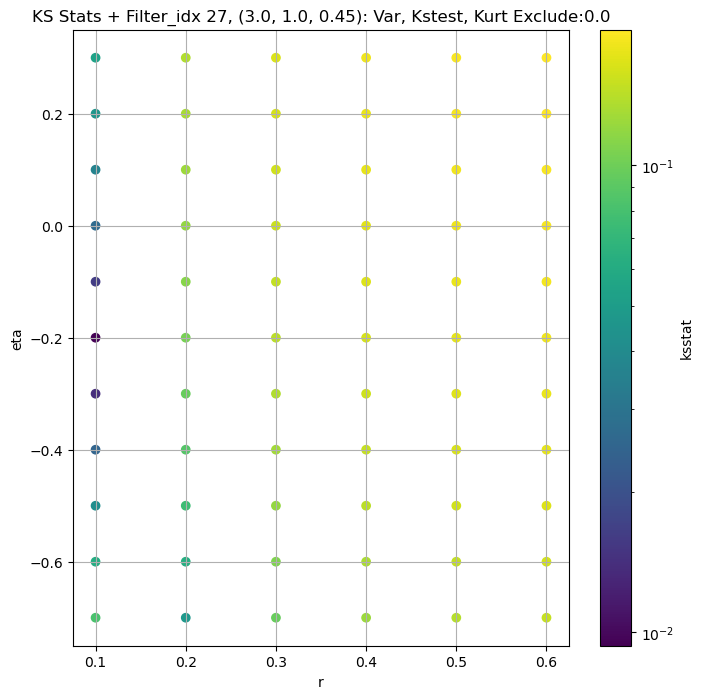

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.006730441202643725 39986.56


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.0077873237768730785 38068.21


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.006981203643749753 36867.35


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.008770417469097014 34993.215
Number of samples: 100000, Without approximation : 65536000.0


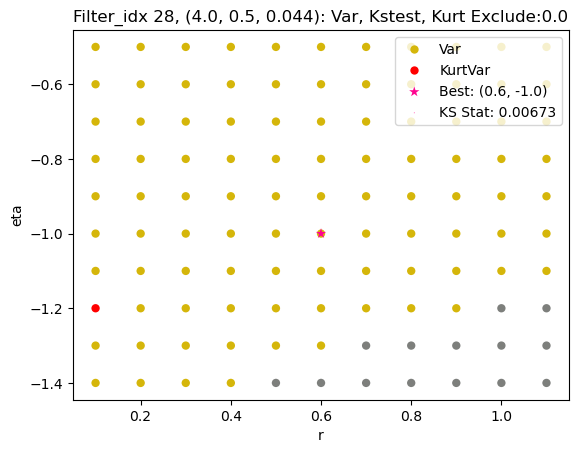

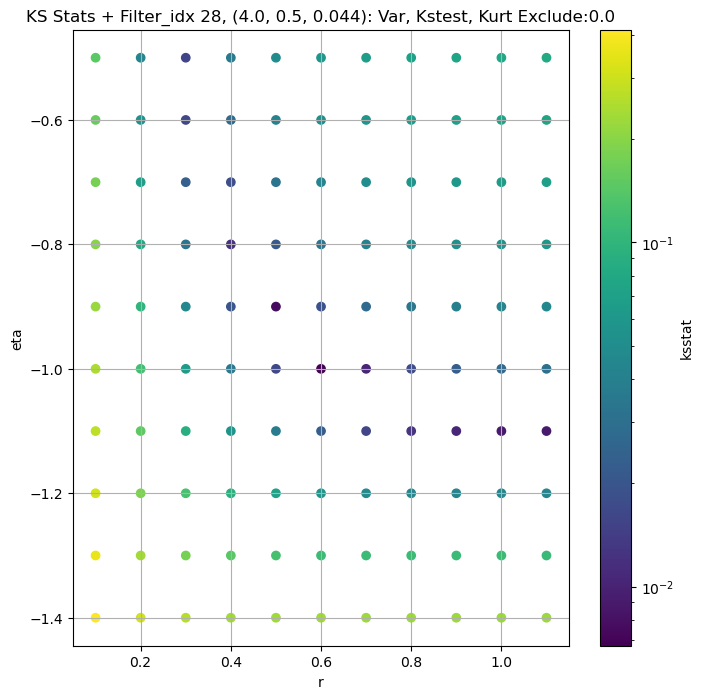

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.009855764353531693 14740.787


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.007516190943879342 13888.845


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.009447394882394544 13360.783


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.008711467932994987 12550.218
Number of samples: 100000, Without approximation : 65536000.0


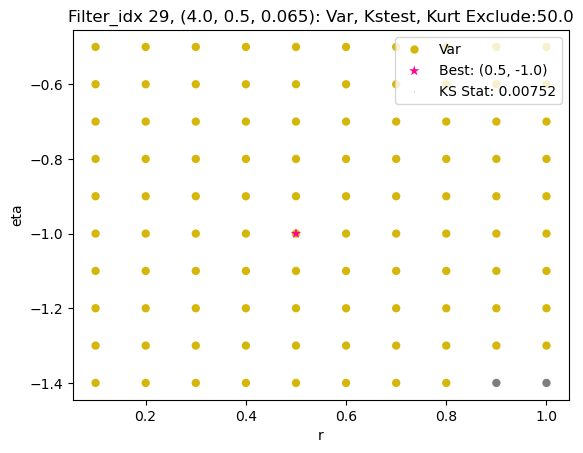

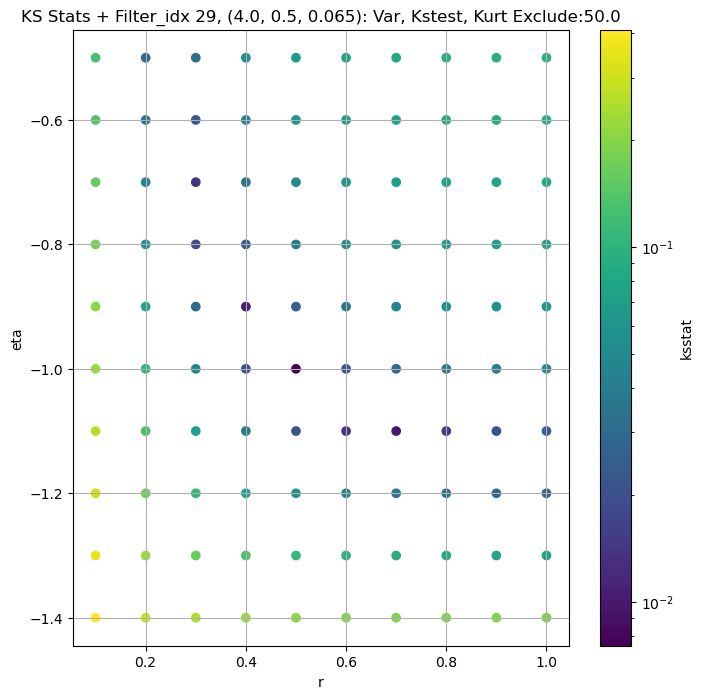

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.006808012667578689 5437.471


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.009104892984704724 5010.2925


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.010927351504712024 4789.032


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.012082017604205408 4458.888
Number of samples: 100000, Without approximation : 65536000.0


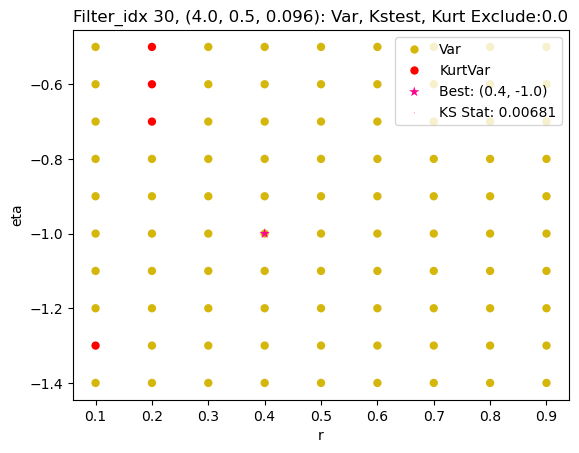

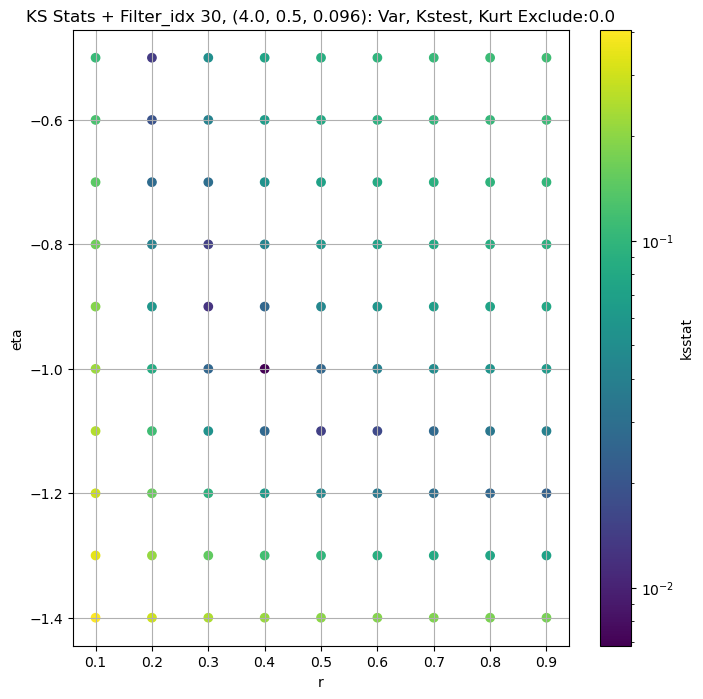

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.010201641684590146 1979.101


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.008856542297139162 1814.5084


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.010951874850784526 1721.6328


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.010840770978721048 1586.7891
Number of samples: 100000, Without approximation : 65536000.0


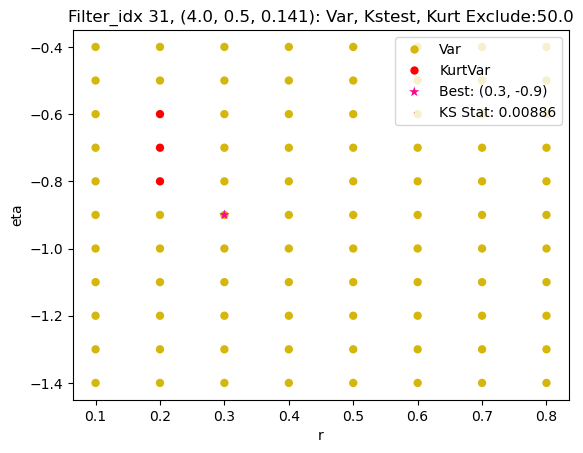

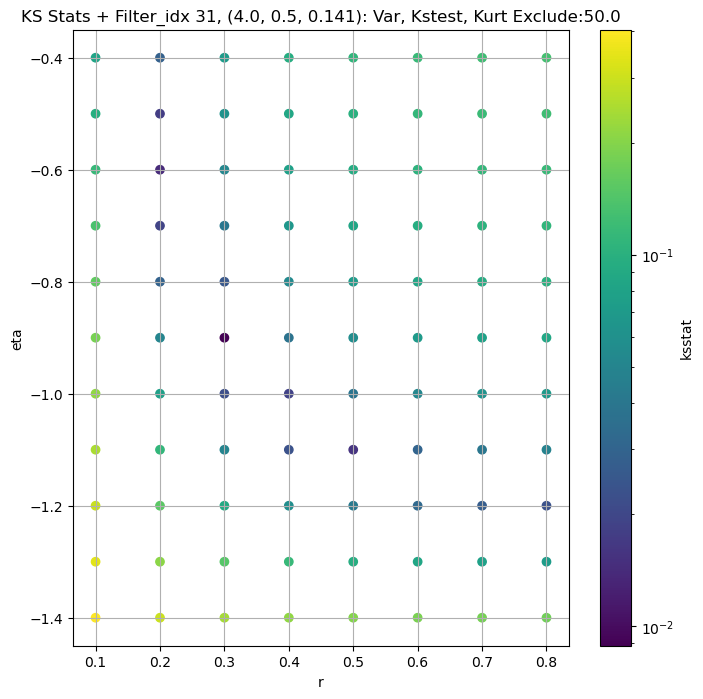

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.008175969660383253 751.4492


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.008766479361065789 680.0644


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.007129702590458226 642.43463


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.009925459044522356 587.8289
Number of samples: 100000, Without approximation : 65536000.0


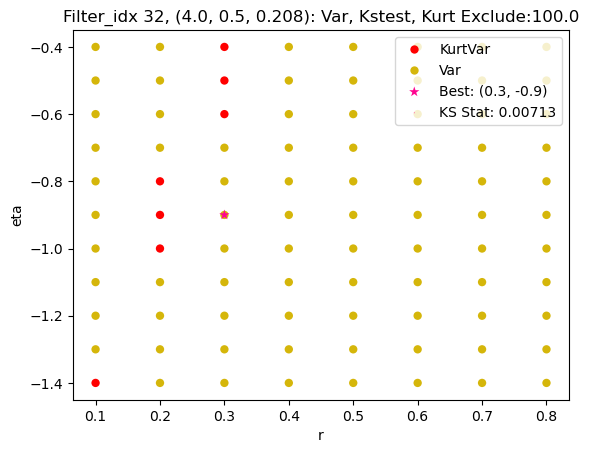

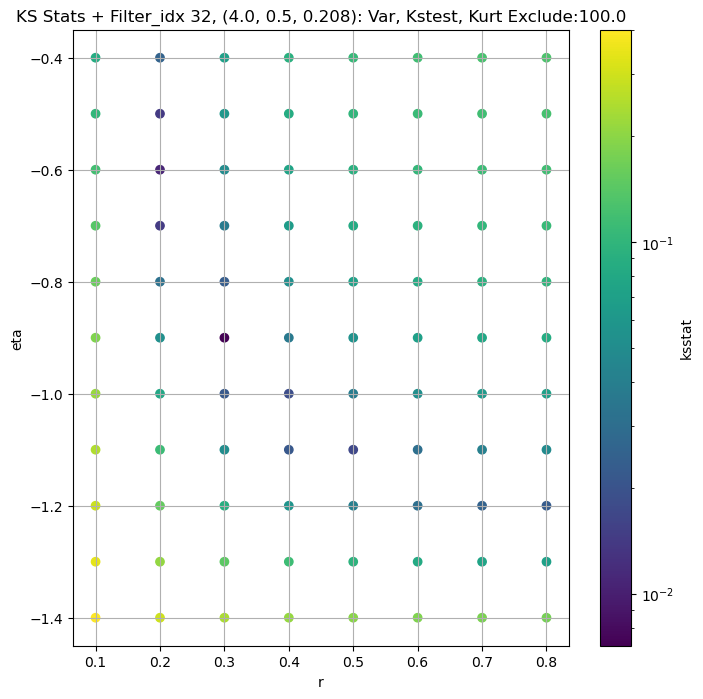

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.005031274519983309 314.1522


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.005009974074726253 278.82187


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.006667530025147417 260.2537


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.009457983442220319 234.26678
Number of samples: 100000, Without approximation : 65536000.0


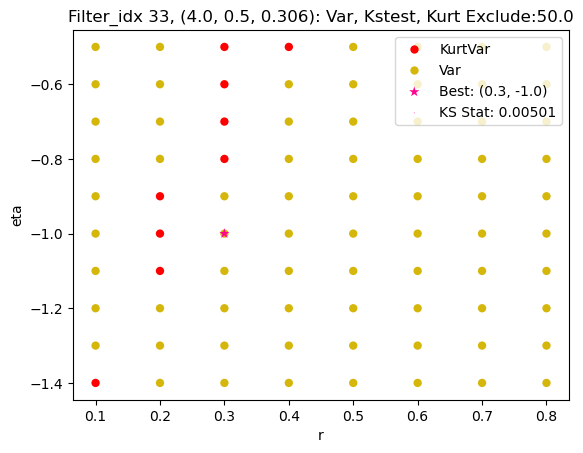

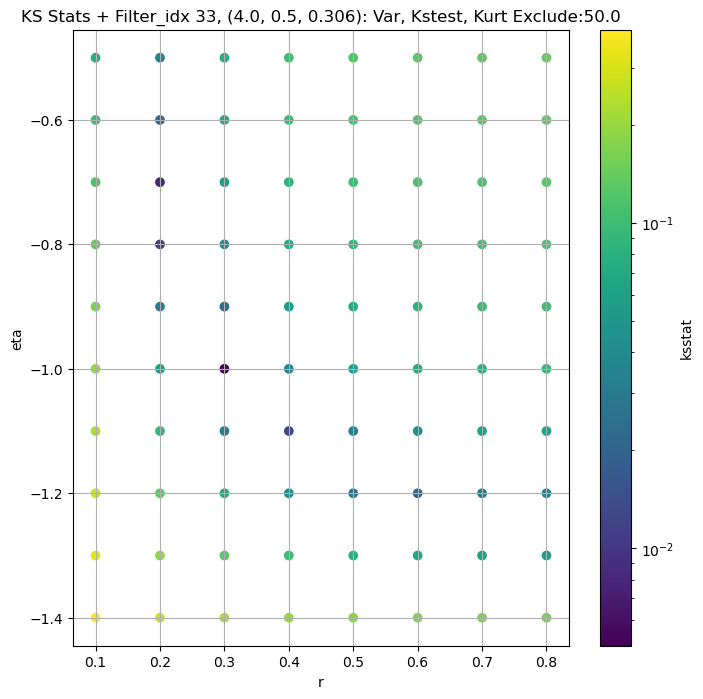

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.013471703782842681 142.66475


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.010484800142110506 123.08576


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.010966253434809392 113.898384


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.015166320379274678 100.84765
Number of samples: 100000, Without approximation : 65536000.0


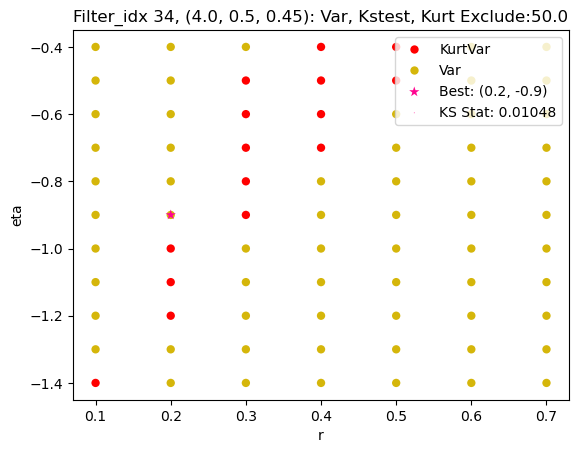

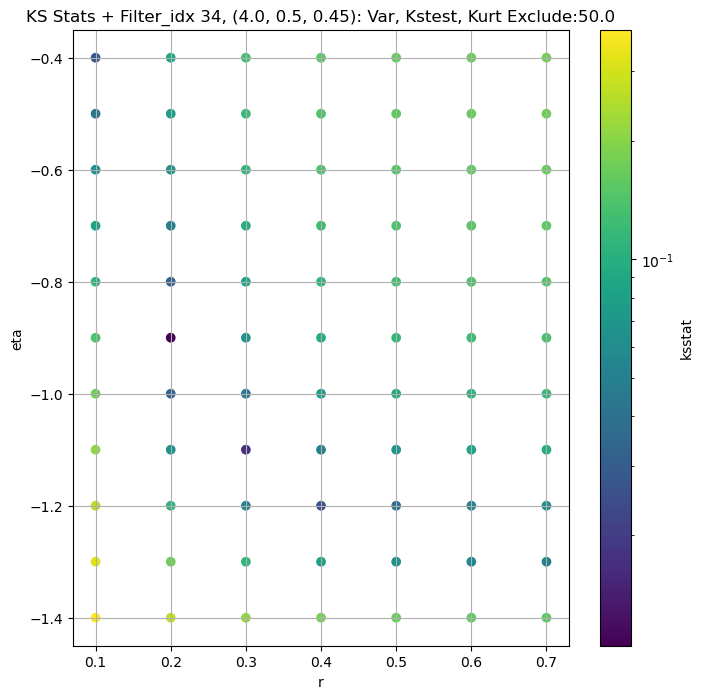

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.007870743087649679 45943.43


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.006031079739294731 42910.332


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.006051636107954339 41030.64


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.0064425852353477975 38219.062
Number of samples: 100000, Without approximation : 65536000.0


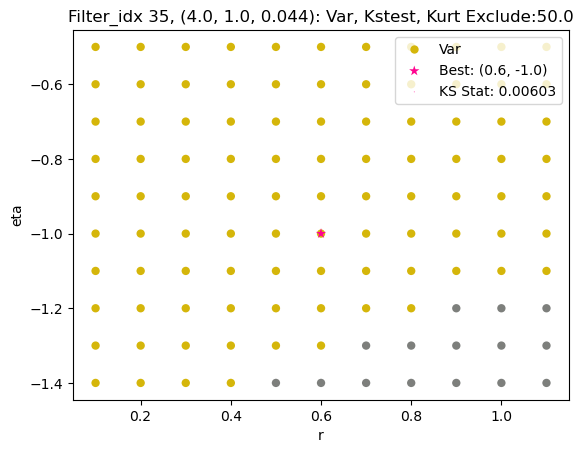

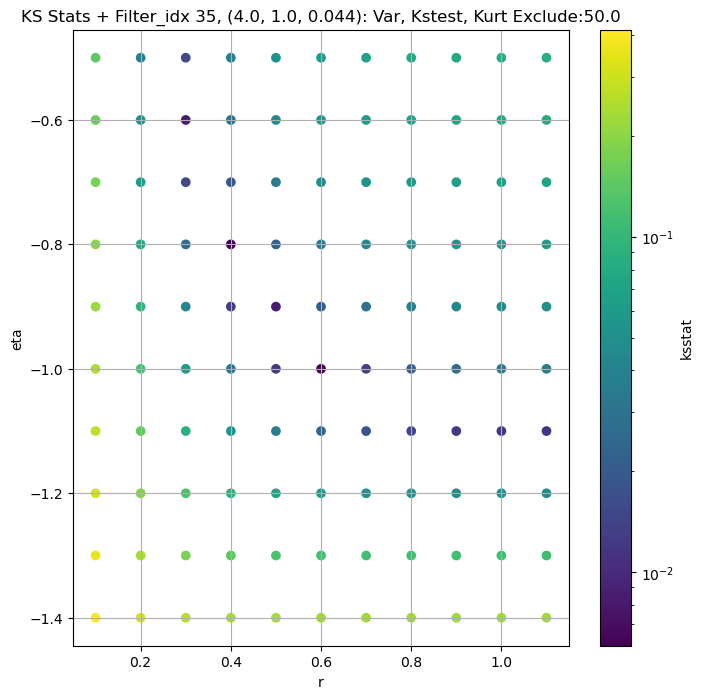

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.0034090336948562616 16675.236


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.008145785727021626 15321.55


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.007028265351453844 14521.12


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.006680096706009664 13363.678
Number of samples: 100000, Without approximation : 65536000.0


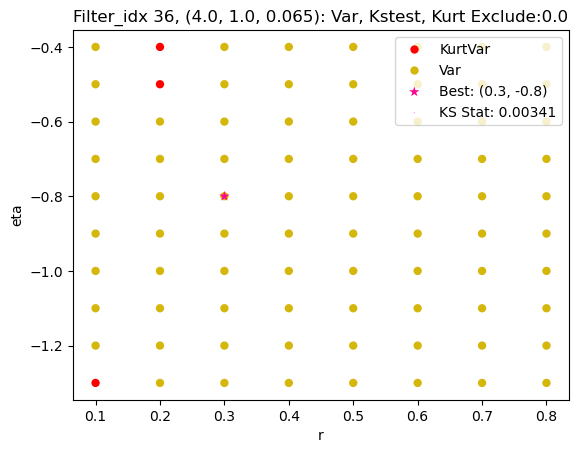

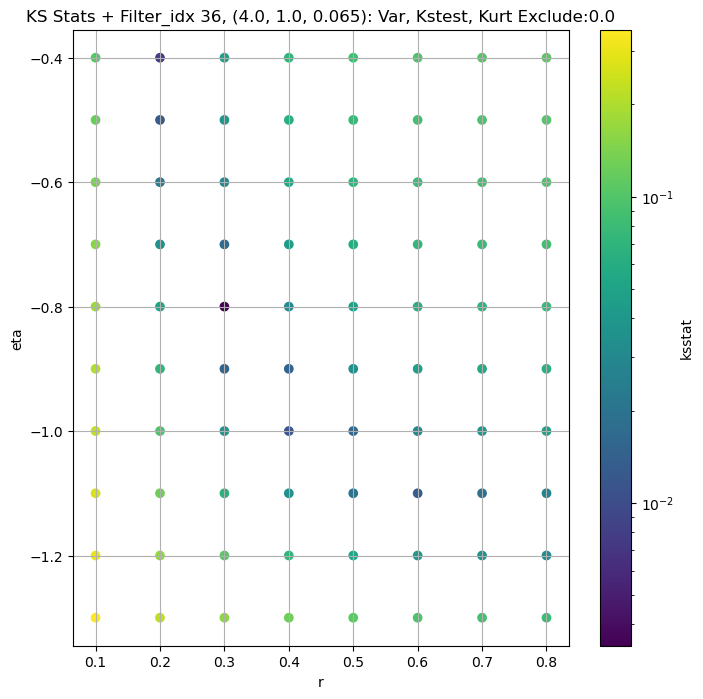

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.006410923050924333 6021.716


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.008487872208372771 5415.999


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.00850723640558948 5082.986


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.008719234333489131 4617.715
Number of samples: 100000, Without approximation : 65536000.0


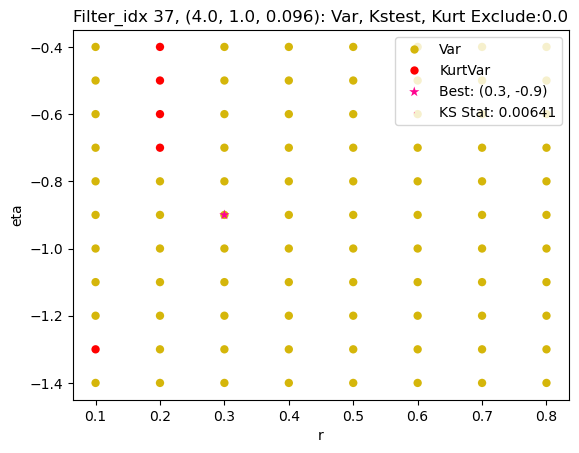

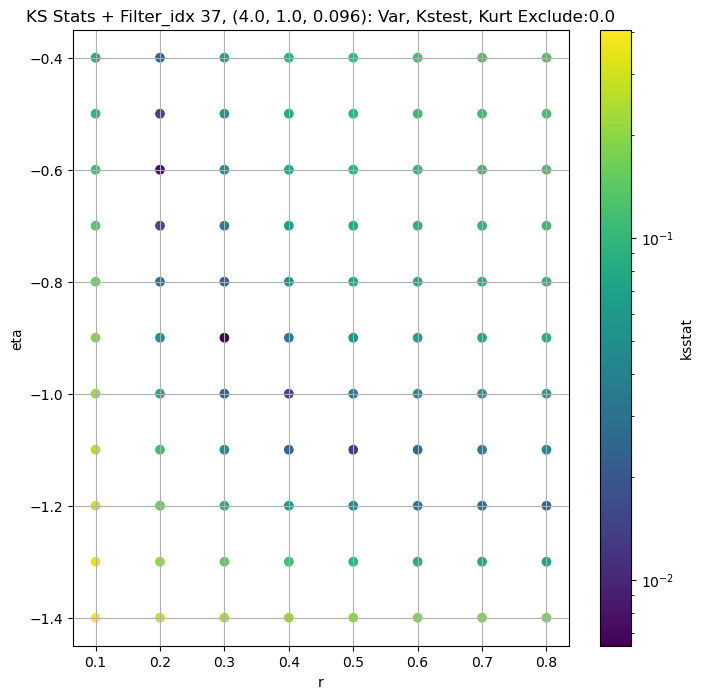

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.006092941844006106 2283.2947


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.009705880975166448 2010.3146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.008365982036654299 1867.9298


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.008050821397527885 1674.6436
Number of samples: 100000, Without approximation : 65536000.0


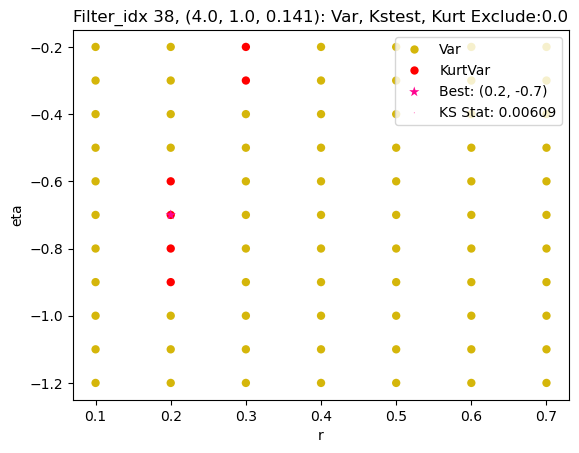

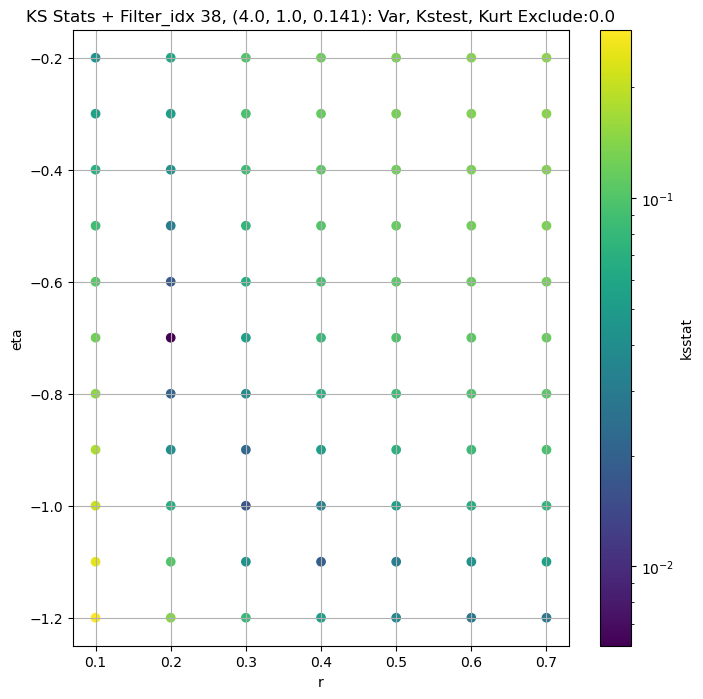

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.006185262786247703 908.6674


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.005043554757775709 785.329


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.006092110511887294 724.4099


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.007742586389660799 639.56476
Number of samples: 100000, Without approximation : 65536000.0


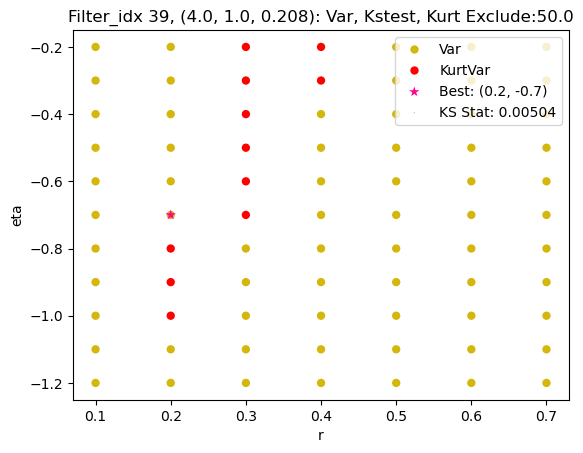

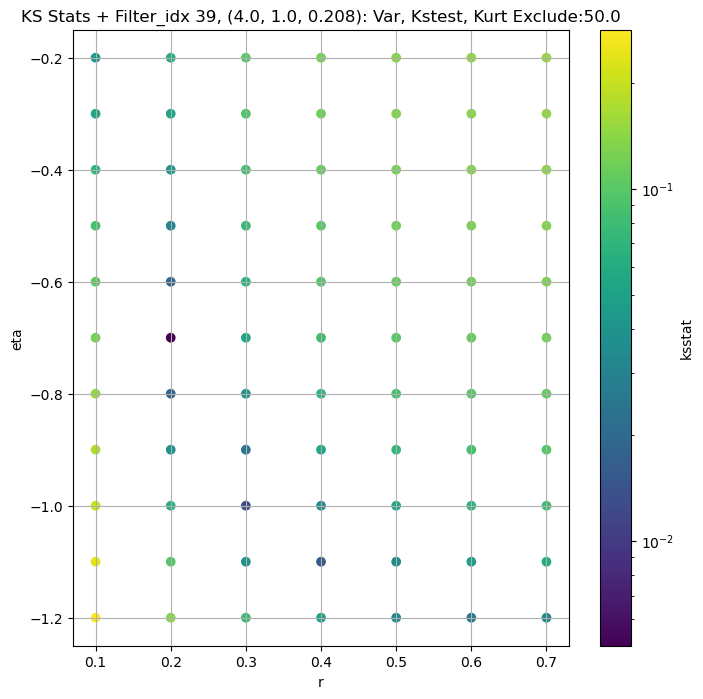

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.007166542714108326 356.08856


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.0031292553795615567 301.43317


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.006523170725500793 274.3735


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.006958235159895687 238.40907
Number of samples: 100000, Without approximation : 65536000.0


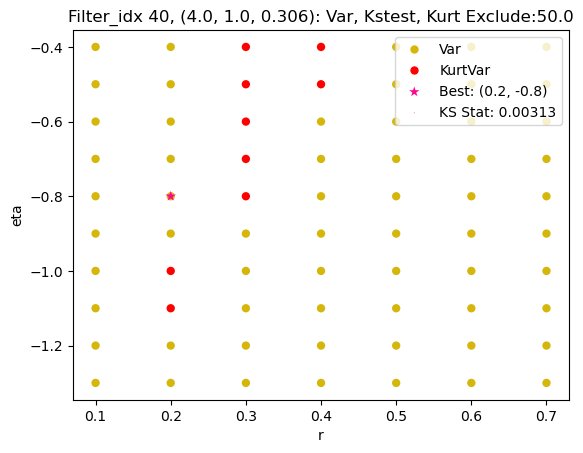

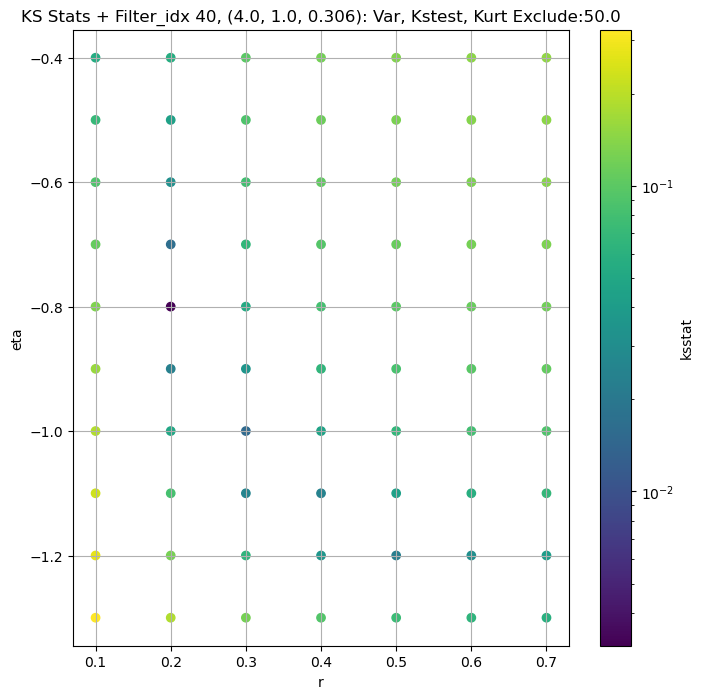

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.009056252357004746 158.14862


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.012238245871544873 128.39201


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.008185093245105635 115.11125


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.01325303363239727 98.70351
Number of samples: 100000, Without approximation : 65536000.0


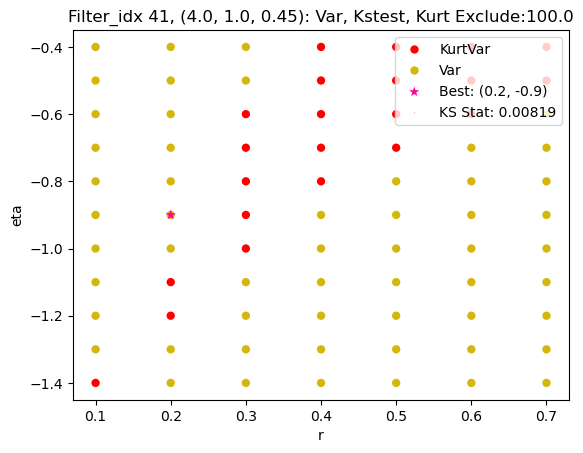

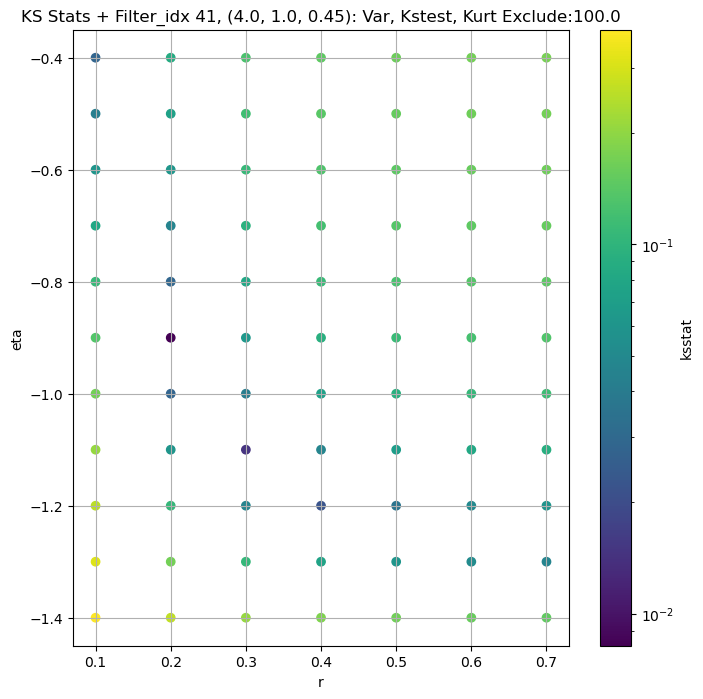

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",45245.52700,35149.957000,55858.81000,5.495759,3.202812,11.596157,65536000.0,"(2.0, 0.5, 0.044)",0.008383,0.7,-1.0,5.200671e+04,50.0,43573.04700,0.000168
1,"(2.0, 0.5, 0.065)",16159.34800,12461.857000,20982.10400,7.577845,4.145749,20.689200,65536000.0,"(2.0, 0.5, 0.065)",0.007421,0.7,-1.1,2.518565e+04,0.0,16159.34800,0.000168
2,"(2.0, 0.5, 0.096)",5922.31700,4530.947300,7658.35350,9.172287,4.752912,22.550383,65536000.0,"(2.0, 0.5, 0.096)",0.008738,0.7,-1.1,7.966054e+03,200.0,5111.09380,0.000168
3,"(2.0, 0.5, 0.141)",2186.18210,1604.981600,2941.15360,11.885174,6.001125,31.736656,65536000.0,"(2.0, 0.5, 0.141)",0.006204,0.4,-1.0,4.480140e+02,0.0,2186.18210,0.000168
4,"(2.0, 0.5, 0.208)",896.74567,626.061100,1207.41710,14.605139,7.902795,40.446873,65536000.0,"(2.0, 0.5, 0.208)",0.006376,0.3,-0.9,2.234660e+01,0.0,896.74567,0.000168
5,"(2.0, 0.5, 0.306)",319.77920,214.653400,441.71838,17.831026,8.364756,54.464200,65536000.0,"(2.0, 0.5, 0.306)",0.008145,0.2,-0.7,4.758619e-02,0.0,319.77920,0.000168
6,"(2.0, 0.5, 0.45)",201.80780,138.282550,288.14822,18.420538,9.052644,56.183180,65536000.0,"(2.0, 0.5, 0.45)",0.009422,0.3,-1.0,7.590877e+00,0.0,201.80780,0.000168
7,"(2.0, 1.0, 0.044)",62793.04300,49965.652000,79623.72000,6.657730,3.644785,17.155079,65536000.0,"(2.0, 1.0, 0.044)",0.002730,0.7,-1.0,7.494678e+04,0.0,62793.04300,0.000168
8,"(2.0, 1.0, 0.065)",22699.83200,17202.203000,29541.35500,8.707811,4.386791,26.468680,65536000.0,"(2.0, 1.0, 0.065)",0.006087,0.6,-1.0,1.764909e+04,100.0,20784.82800,0.000168


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 50.0 + 100 = 150, ksstat: 0.007116061296264353, var: 41467.56640625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 50.0 + 75 = 125, ksstat: 0.006529432980897587, var: 41938.12109375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 50.0 + 50 = 100, ksstat: 0.006469288461539491, var: 42438.49609375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 50.0 + 25 = 75, ksstat: 0.0064185948605263166, var: 42979.23046875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 50.0 + 0 = 50, ksstat: 0.005932929934406195, var: 43573.046875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 50.0 + -25 = 25, ksstat: 0.005198232297383365, var: 44255.62109375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 0, 50.0 + -50 = 0, ksstat: 0.005341085454710237, var: 45245.52734375
Number of samples: 100000, Without approximation : 65536000.0


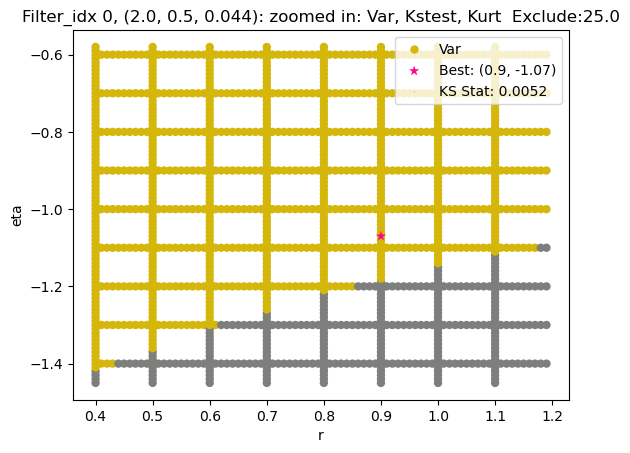

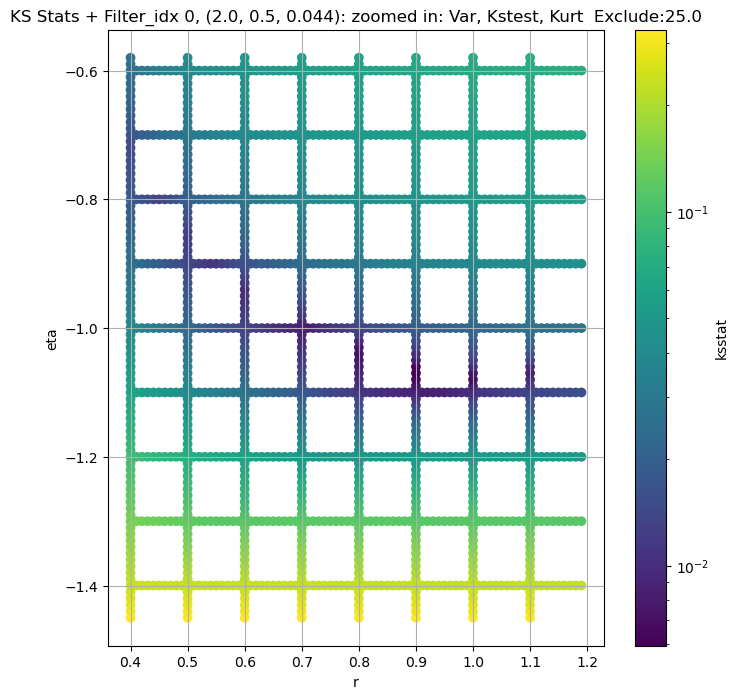

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.006762664383660244, var: 14945.7900390625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.006786389632689294, var: 15171.6748046875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.006466055122281267, var: 15422.2880859375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.006433859050218094, var: 15712.2236328125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.005916269866360957, var: 16159.34765625
Number of samples: 100000, Without approximation : 65536000.0


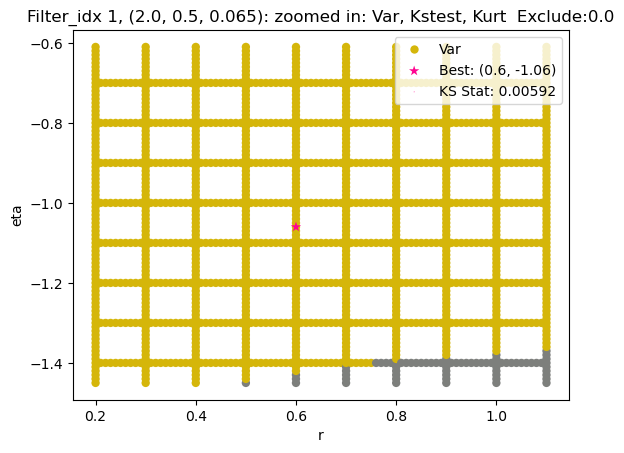

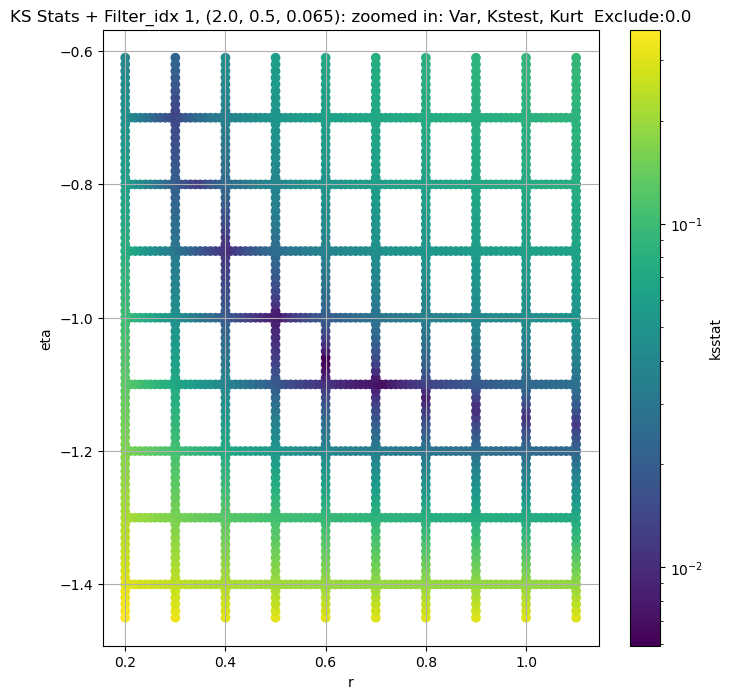

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 100 = 300, ksstat: 0.008620221998118405, var: 4854.966796875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 75 = 275, ksstat: 0.008450576611478633, var: 4915.0927734375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 50 = 250, ksstat: 0.00854293492302527, var: 4977.68017578125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 25 = 225, ksstat: 0.008638761969387454, var: 5042.958984375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + 0 = 200, ksstat: 0.00849292439411043, var: 5111.09375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -25 = 175, ksstat: 0.008181560370810581, var: 5182.74072265625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -50 = 150, ksstat: 0.007574575230227601, var: 5258.3662109375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -75 = 125, ksstat: 0.007755022257395383, var: 5338.58251953125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 2, 200.0 + -100 = 100, ksstat: 0.008086111697990117, var: 5425.0029296875
Number of samples: 100000, Without approximation : 65536000.0


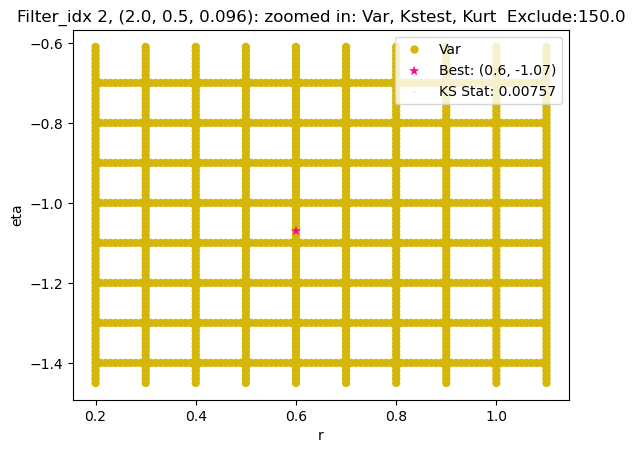

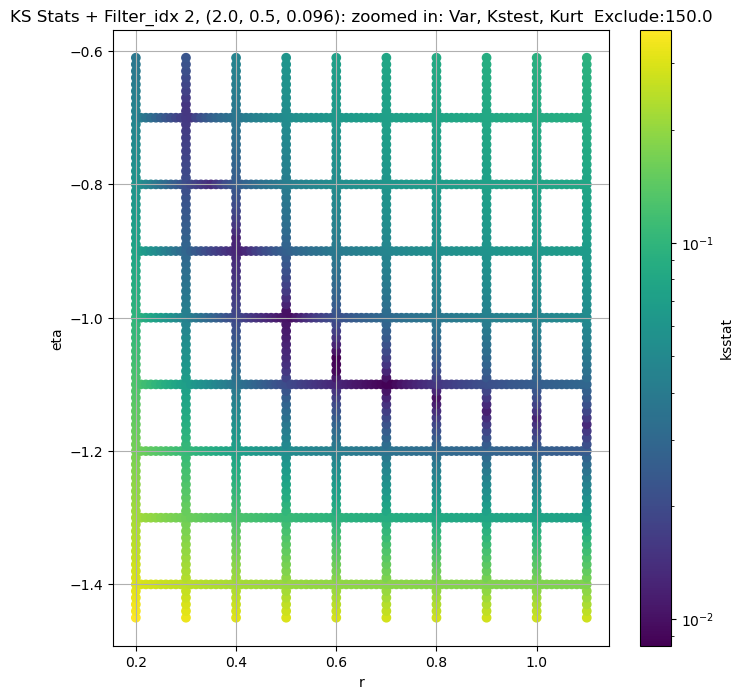

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.0073760749227264055, var: 1966.8988037109375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.007093964329885072, var: 2007.562255859375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.006779452526236018, var: 2053.1396484375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.006191582094336956, var: 2105.97265625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.006203674707782714, var: 2186.18212890625
Number of samples: 100000, Without approximation : 65536000.0


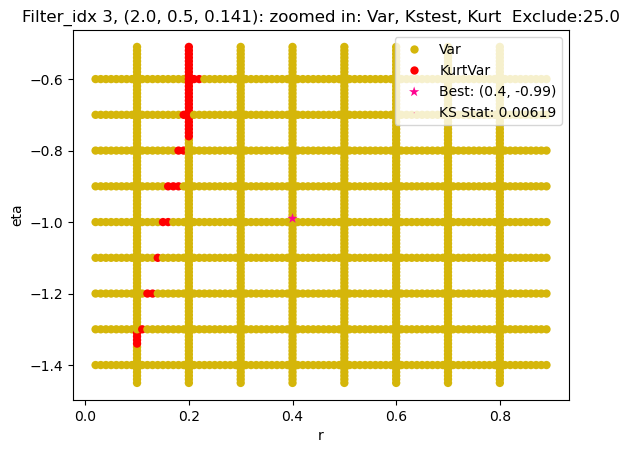

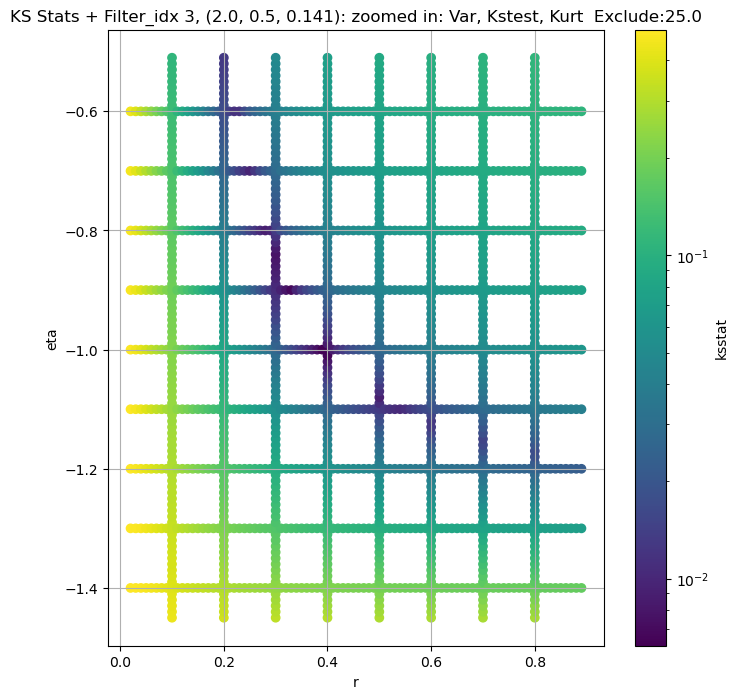

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 0.0 + 100 = 100, ksstat: 0.00619404660028286, var: 795.3862915039062


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 0.0 + 75 = 75, ksstat: 0.0056473879161402785, var: 813.41943359375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 0.0 + 50 = 50, ksstat: 0.005592848574686199, var: 833.8375244140625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 0.0 + 25 = 25, ksstat: 0.00528204701063939, var: 858.4689331054688


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 0.0 + 0 = 0, ksstat: 0.005281590129525504, var: 896.7456665039062
Number of samples: 100000, Without approximation : 65536000.0


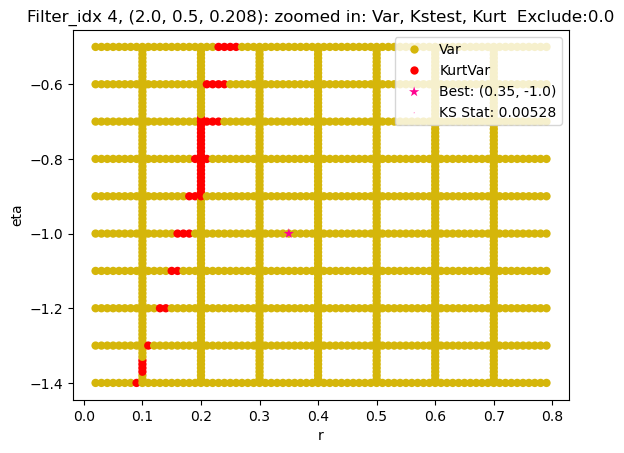

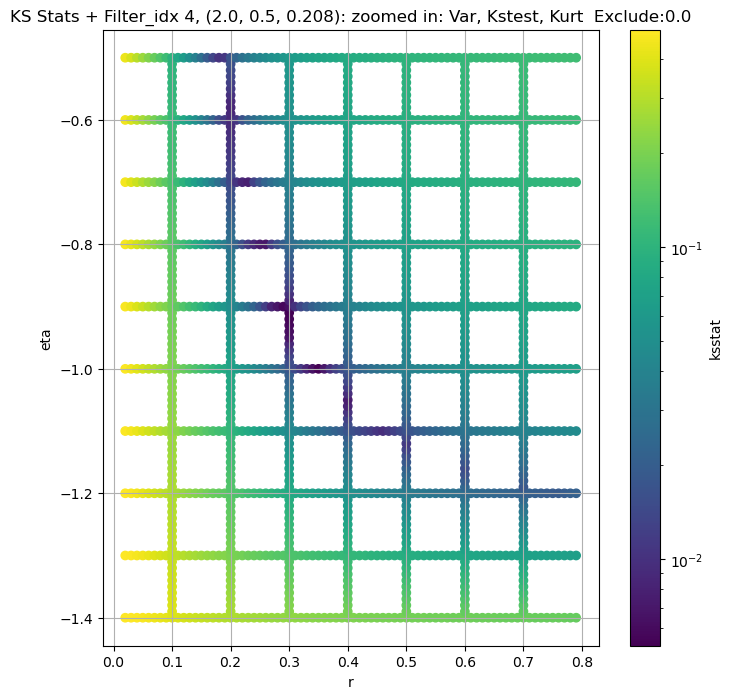

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 5, 0.0 + 100 = 100, ksstat: 0.008125744038839255, var: 279.0150451660156


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 5, 0.0 + 75 = 75, ksstat: 0.008124107385893753, var: 286.4807434082031


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 5, 0.0 + 50 = 50, ksstat: 0.008124741753953724, var: 294.9603271484375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 5, 0.0 + 25 = 25, ksstat: 0.008125312742877089, var: 304.75140380859375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 5, 0.0 + 0 = 0, ksstat: 0.008124025980158822, var: 319.7792053222656
Number of samples: 100000, Without approximation : 65536000.0


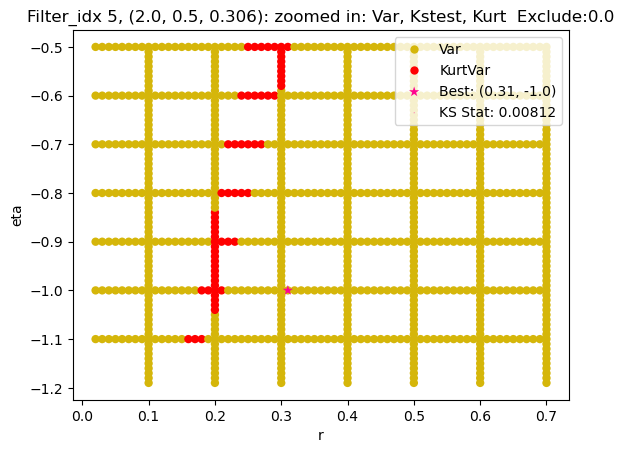

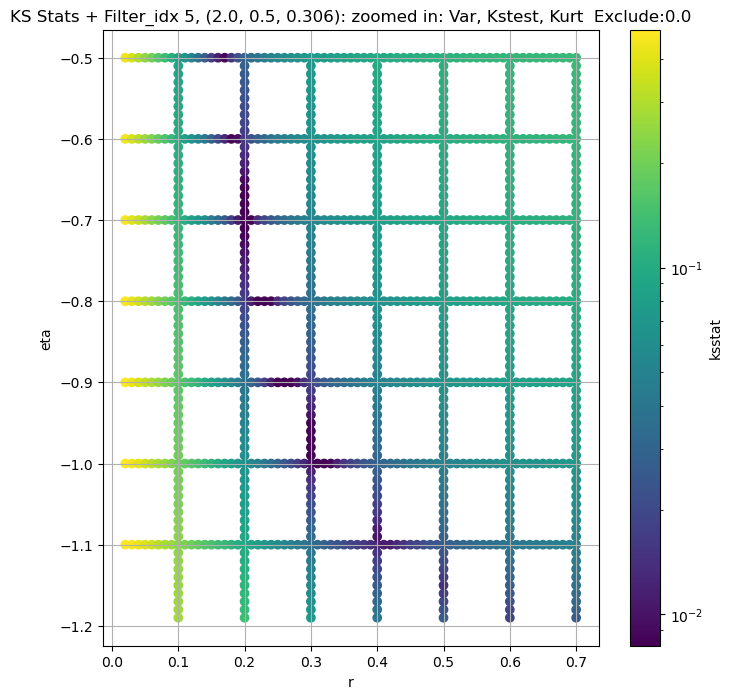

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 6, 0.0 + 100 = 100, ksstat: 0.009419635890945854, var: 175.4683837890625


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 6, 0.0 + 75 = 75, ksstat: 0.009420041450164396, var: 180.25144958496094


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 6, 0.0 + 50 = 50, ksstat: 0.009418642506405783, var: 185.68650817871094


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 6, 0.0 + 25 = 25, ksstat: 0.009419159886511652, var: 191.96922302246094


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 6, 0.0 + 0 = 0, ksstat: 0.009419921015976773, var: 201.80780029296875
Number of samples: 100000, Without approximation : 65536000.0


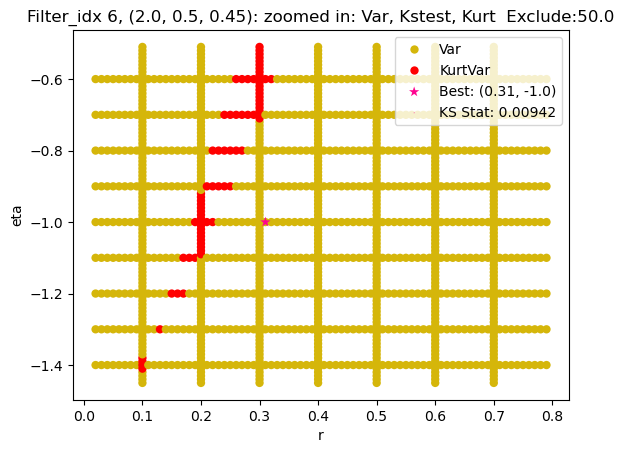

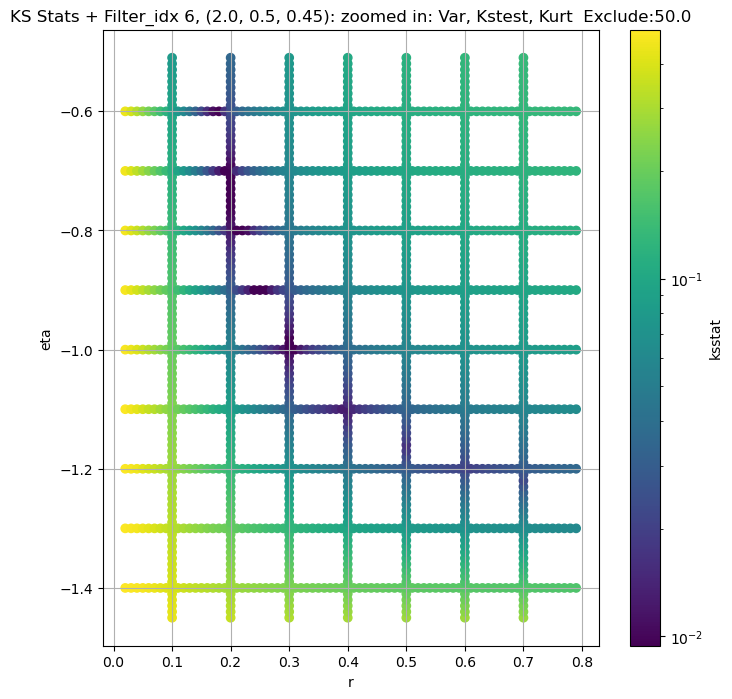

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.004565389330885794, var: 58237.28125


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.004147821067673647, var: 59089.76171875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.0034584535851592824, var: 60041.0234375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.0029698103090397554, var: 61151.640625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.0024050639909340976, var: 62793.04296875
Number of samples: 100000, Without approximation : 65536000.0


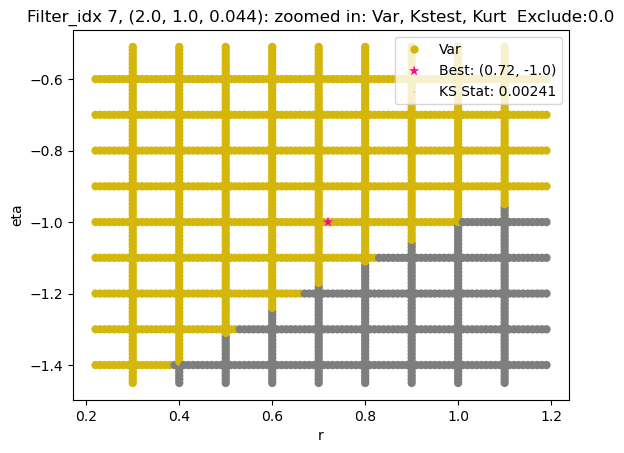

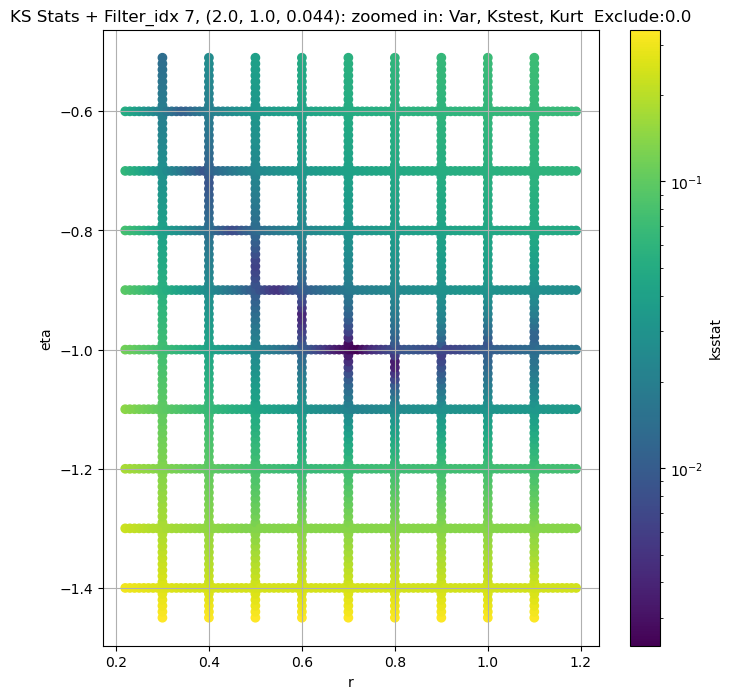

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + 100 = 200, ksstat: 0.005767332828203742, var: 19628.337890625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + 75 = 175, ksstat: 0.005543554684640073, var: 19888.890625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + 50 = 150, ksstat: 0.005489141748417303, var: 20166.0703125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + 25 = 125, ksstat: 0.005041423254765087, var: 20463.099609375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + 0 = 100, ksstat: 0.004599269717576404, var: 20784.828125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + -25 = 75, ksstat: 0.004978832711809877, var: 21138.49609375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + -50 = 50, ksstat: 0.0044033523054411855, var: 21534.607421875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + -75 = 25, ksstat: 0.004385514988877681, var: 21998.82421875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 100.0 + -100 = 0, ksstat: 0.003523286307304932, var: 22699.83203125
Number of samples: 100000, Without approximation : 65536000.0


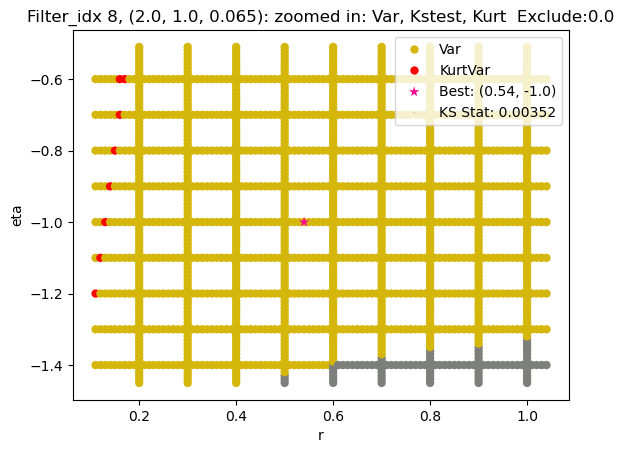

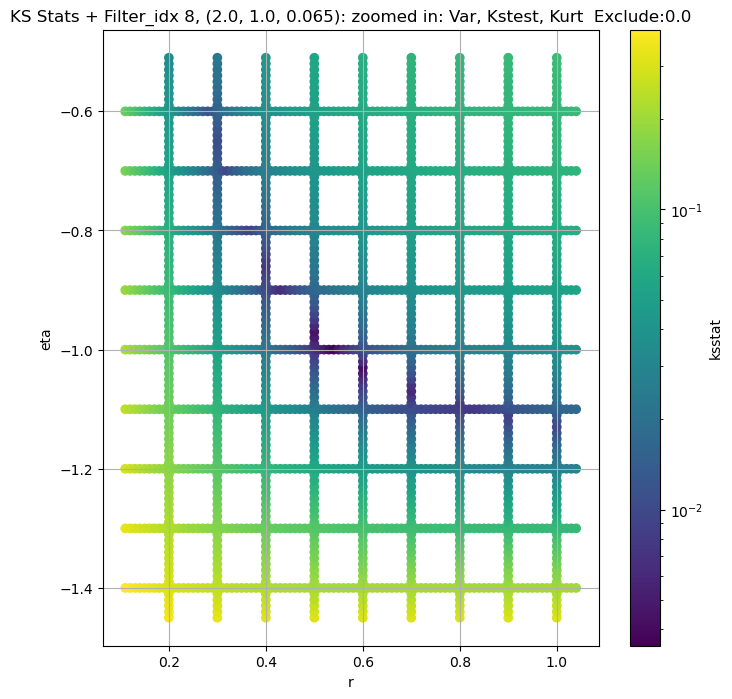

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 50.0 + 100 = 150, ksstat: 0.005683717860452964, var: 7297.96044921875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 50.0 + 75 = 125, ksstat: 0.005030769338668528, var: 7419.716796875


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 50.0 + 50 = 100, ksstat: 0.005690830519776591, var: 7552.39501953125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 50.0 + 25 = 75, ksstat: 0.005469371477774376, var: 7699.78125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 50.0 + 0 = 50, ksstat: 0.00485586405871756, var: 7868.45458984375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 50.0 + -25 = 25, ksstat: 0.004395310702921984, var: 8069.36962890625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 9, 50.0 + -50 = 0, ksstat: 0.003956499552881909, var: 8380.244140625
Number of samples: 100000, Without approximation : 65536000.0


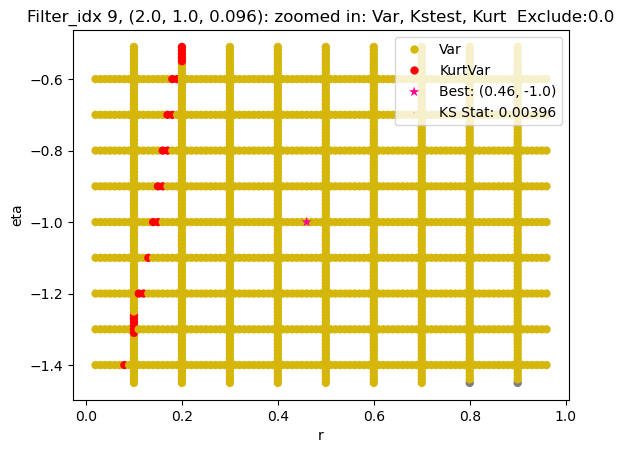

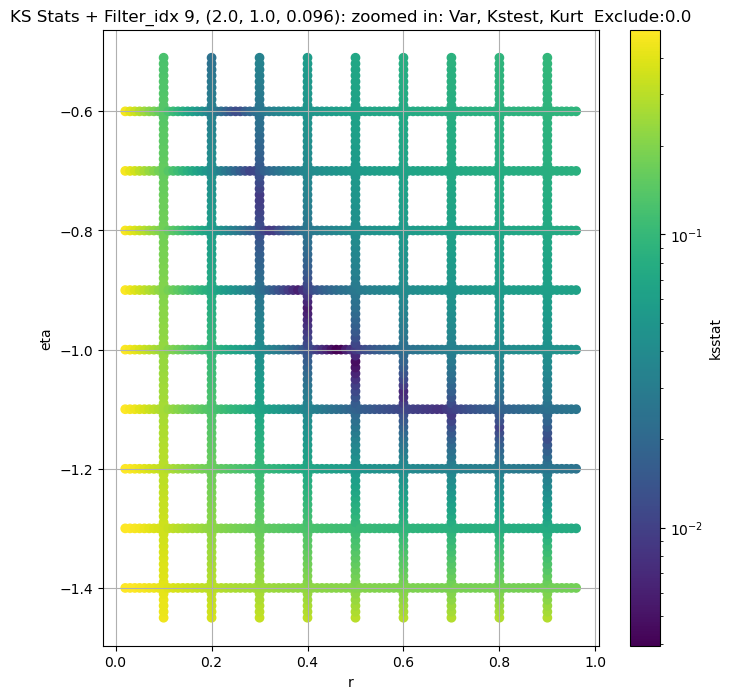

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.005295964659458585, var: 2880.77490234375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.0052052287811807235, var: 2944.32568359375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.004785987798095276, var: 3017.13427734375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.004460475707150399, var: 3104.64599609375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.004436725909516492, var: 3242.9931640625
Number of samples: 100000, Without approximation : 65536000.0


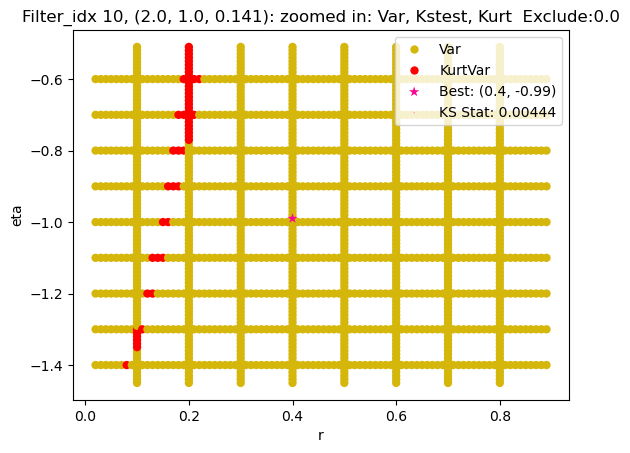

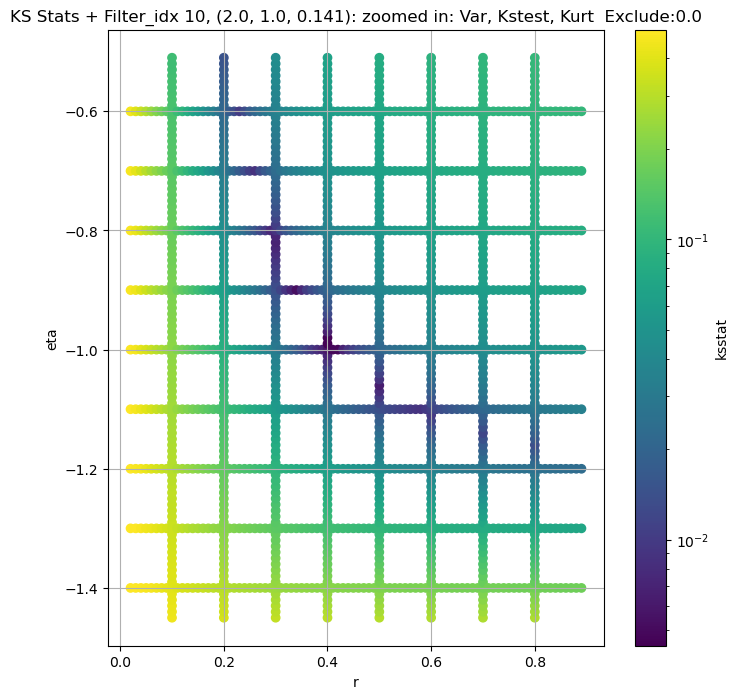

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.0048352289180718655, var: 1045.6739501953125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.004385215829345146, var: 1071.8175048828125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.003884631654738735, var: 1101.5615234375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.004132234362432152, var: 1137.6712646484375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.0037528086362525886, var: 1197.3448486328125
Number of samples: 100000, Without approximation : 65536000.0


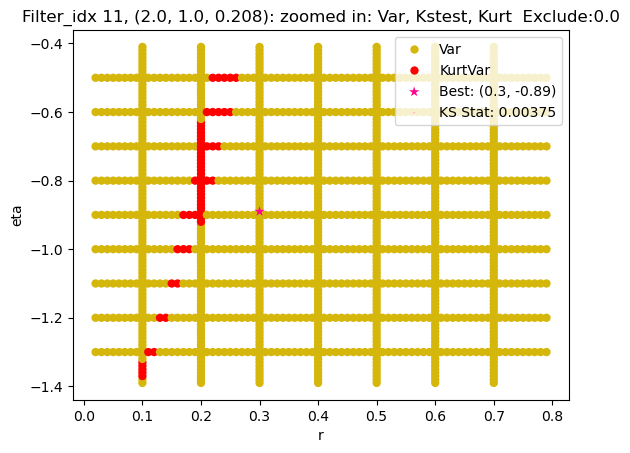

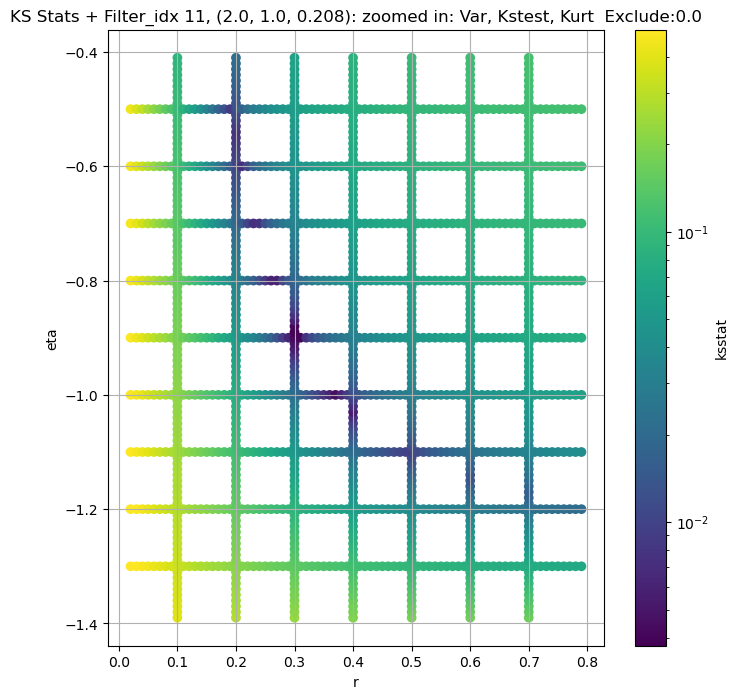

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + 100 = 200, ksstat: 0.0059001454107285856, var: 362.0592041015625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + 75 = 175, ksstat: 0.0058989155699070706, var: 370.0962219238281


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + 50 = 150, ksstat: 0.005898852769855634, var: 378.738525390625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + 25 = 125, ksstat: 0.005898105482745941, var: 388.1039733886719


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + 0 = 100, ksstat: 0.005898392709843436, var: 398.49090576171875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + -25 = 75, ksstat: 0.005897615621569485, var: 410.2613220214844


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + -50 = 50, ksstat: 0.0058979810843449165, var: 423.99334716796875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + -75 = 25, ksstat: 0.005897228639505037, var: 440.85882568359375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 12, 100.0 + -100 = 0, ksstat: 0.005897906839526013, var: 468.3410949707031
Number of samples: 100000, Without approximation : 65536000.0


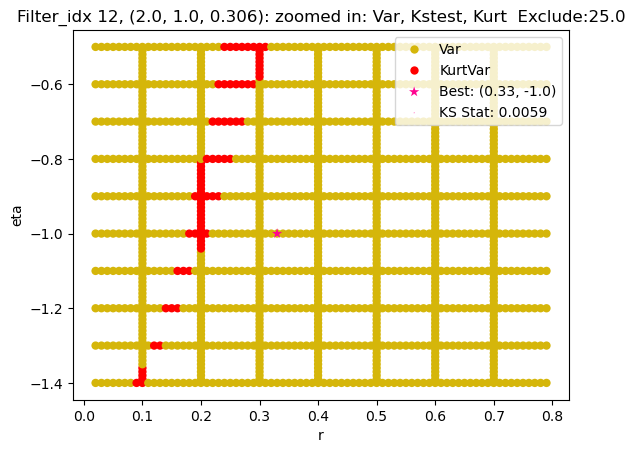

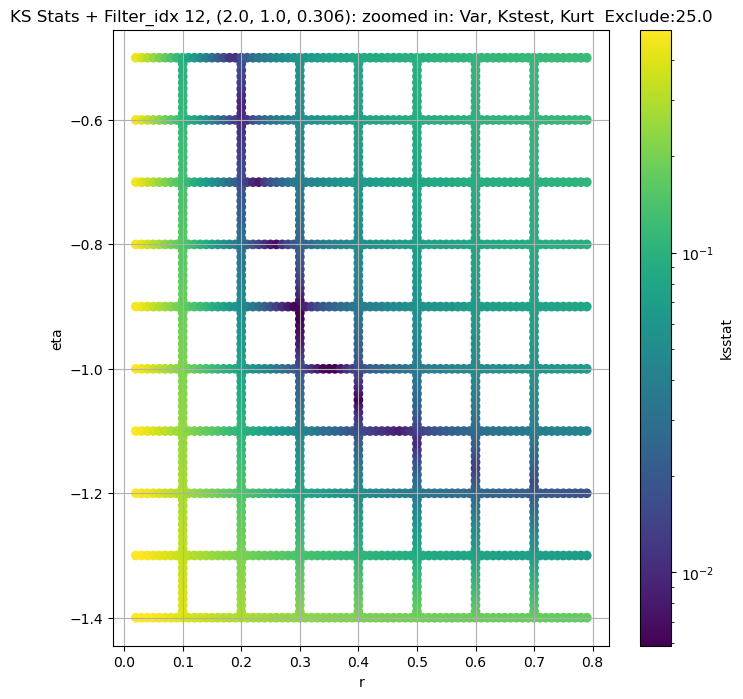

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + 100 = 200, ksstat: 0.010992102913590651, var: 163.39474487304688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + 75 = 175, ksstat: 0.010992959445046635, var: 167.59683227539062


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + 50 = 150, ksstat: 0.010993855916548556, var: 172.17086791992188


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + 25 = 125, ksstat: 0.010989406848431527, var: 177.18492126464844


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + 0 = 100, ksstat: 0.010990490580646883, var: 182.75338745117188


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + -25 = 75, ksstat: 0.010988625714843547, var: 188.98025512695312


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + -50 = 50, ksstat: 0.010989944253707085, var: 196.161376953125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + -75 = 25, ksstat: 0.010988292866908778, var: 205.2013397216797


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 100.0 + -100 = 0, ksstat: 0.01098738265605459, var: 220.53648376464844
Number of samples: 100000, Without approximation : 65536000.0


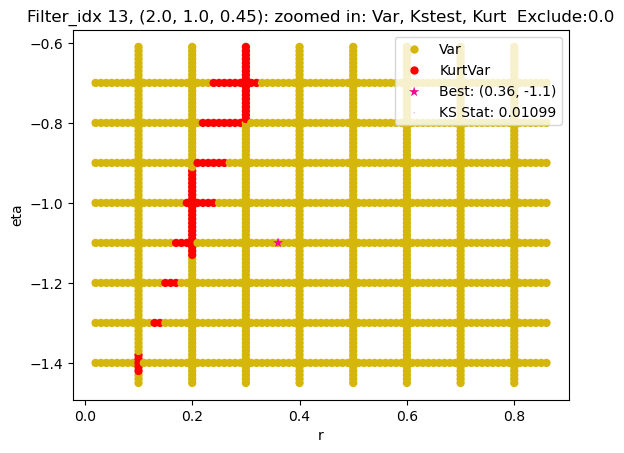

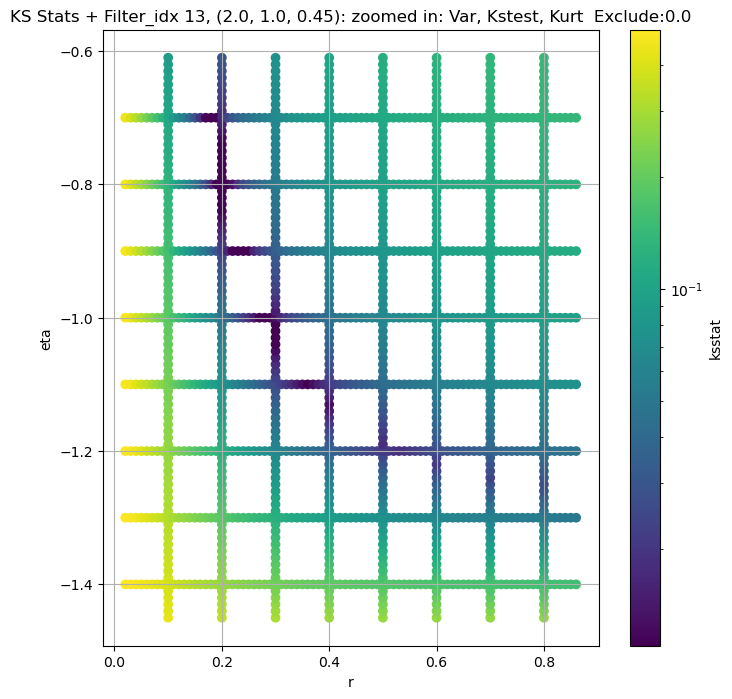

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.0062252776767131035, var: 39875.125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.005617711840597228, var: 40450.69140625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.005944483088112018, var: 41094.06640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.005421491306286552, var: 41847.640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.005680630968881328, var: 42997.68359375
Number of samples: 100000, Without approximation : 65536000.0


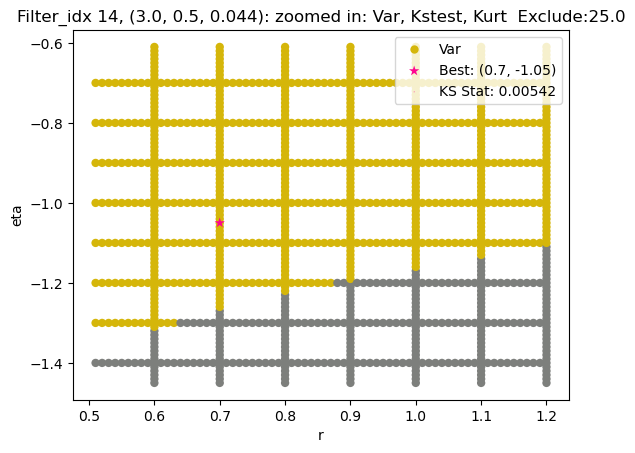

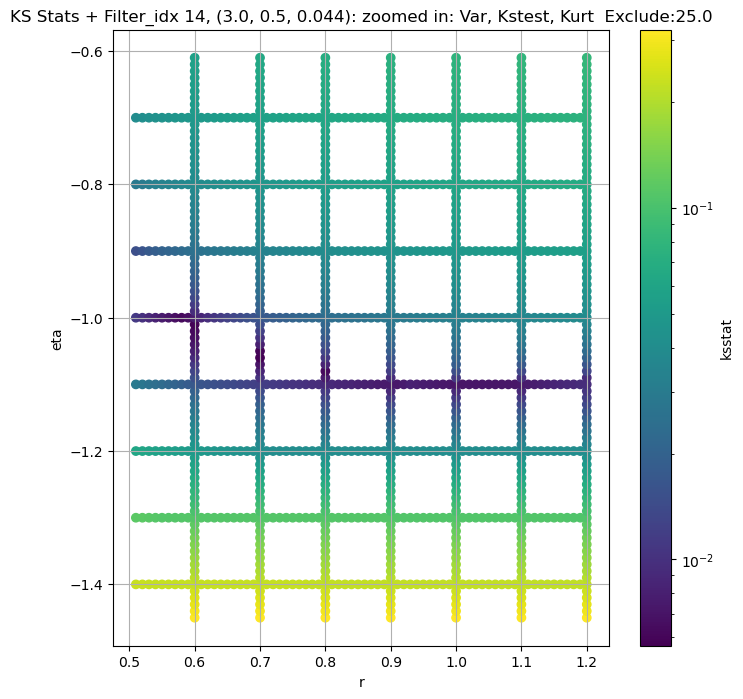

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + 100 = 300, ksstat: 0.008788111201720628, var: 12654.921875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + 75 = 275, ksstat: 0.008565237144170013, var: 12804.77734375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + 50 = 250, ksstat: 0.008478714361971895, var: 12960.6279296875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + 25 = 225, ksstat: 0.008738132471407256, var: 13122.8427734375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + 0 = 200, ksstat: 0.008786852267686718, var: 13292.716796875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + -25 = 175, ksstat: 0.008248354844964445, var: 13471.443359375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + -50 = 150, ksstat: 0.007924870010474358, var: 13660.0830078125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + -75 = 125, ksstat: 0.007338249403764263, var: 13861.34375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 200.0 + -100 = 100, ksstat: 0.008110028498457156, var: 14078.337890625
Number of samples: 100000, Without approximation : 65536000.0


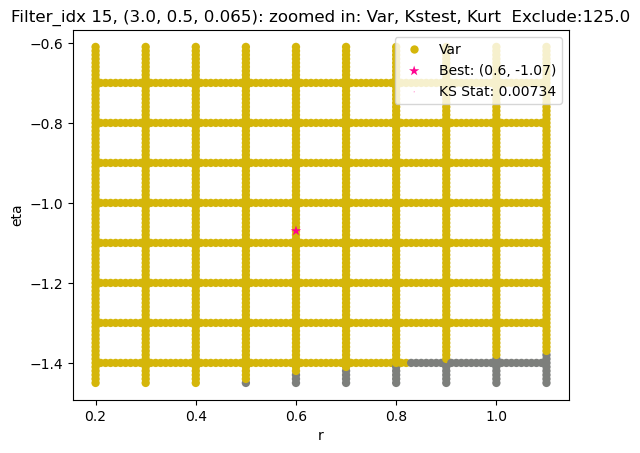

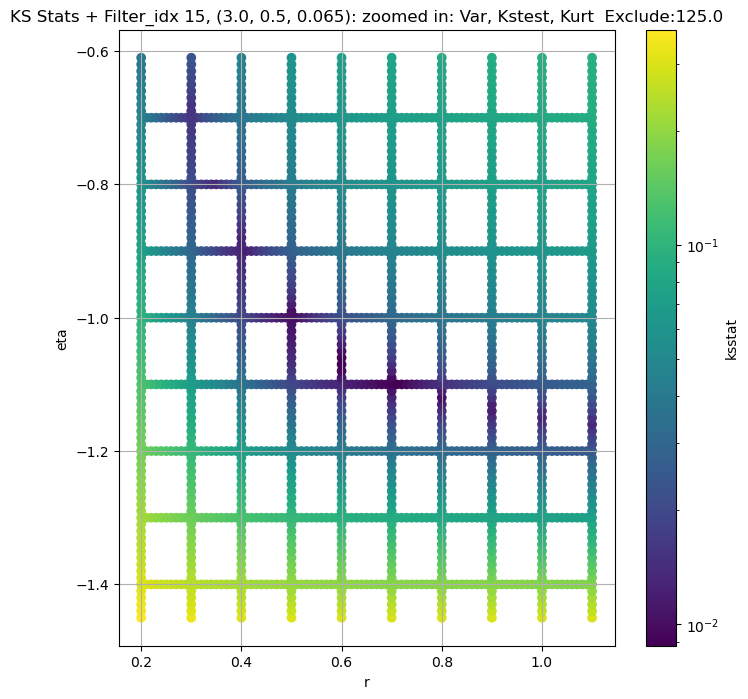

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 16, 50.0 + 100 = 150, ksstat: 0.008361260281631089, var: 4711.42236328125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 16, 50.0 + 75 = 125, ksstat: 0.008208562914128865, var: 4795.29052734375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 16, 50.0 + 50 = 100, ksstat: 0.0075239018973918895, var: 4885.544921875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 16, 50.0 + 25 = 75, ksstat: 0.0073056714972303816, var: 4984.8056640625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 16, 50.0 + 0 = 50, ksstat: 0.007152949342375203, var: 5096.32177734375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 16, 50.0 + -25 = 25, ksstat: 0.0067837066039661, var: 5228.177734375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 16, 50.0 + -50 = 0, ksstat: 0.007240778095135458, var: 5436.8017578125
Number of samples: 100000, Without approximation : 65536000.0


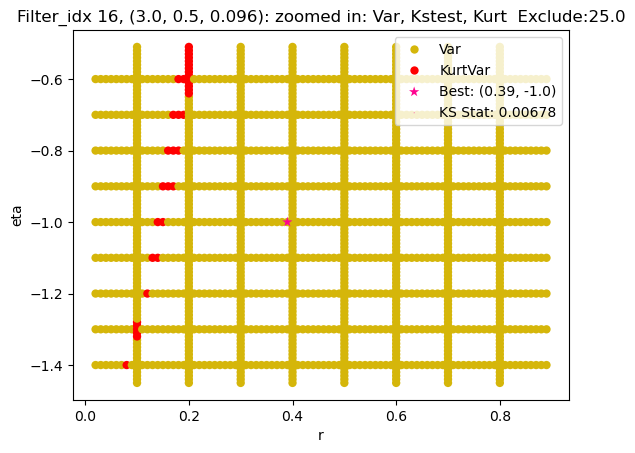

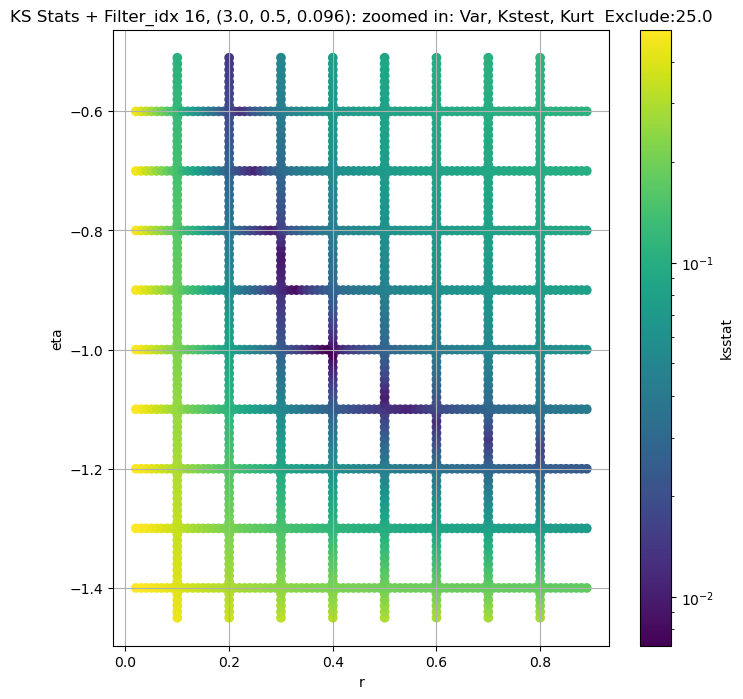

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 50.0 + 100 = 150, ksstat: 0.008877362113568377, var: 1780.7979736328125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 50.0 + 75 = 125, ksstat: 0.008603897372186142, var: 1817.51953125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 50.0 + 50 = 100, ksstat: 0.008194817601564708, var: 1857.2955322265625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 50.0 + 25 = 75, ksstat: 0.007966967397247116, var: 1901.1685791015625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 50.0 + 0 = 50, ksstat: 0.007326445478534324, var: 1951.231689453125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 50.0 + -25 = 25, ksstat: 0.006731382165709898, var: 2010.8909912109375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 50.0 + -50 = 0, ksstat: 0.006661887305507763, var: 2110.762451171875
Number of samples: 100000, Without approximation : 65536000.0


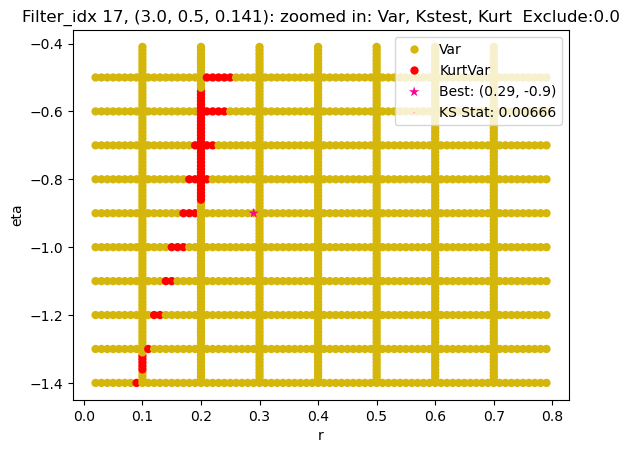

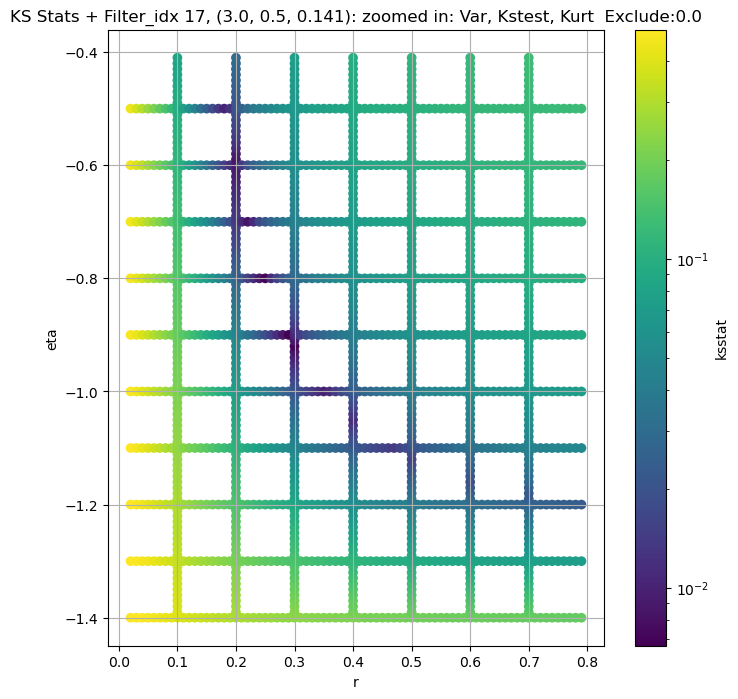

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 0.0 + 100 = 100, ksstat: 0.006432224268514197, var: 674.3068237304688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 0.0 + 75 = 75, ksstat: 0.006594654023175606, var: 692.3715209960938


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 0.0 + 50 = 50, ksstat: 0.006190103701426697, var: 713.2413940429688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 0.0 + 25 = 25, ksstat: 0.006153294067402837, var: 738.9658203125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 0.0 + 0 = 0, ksstat: 0.005660690798287682, var: 781.5667114257812
Number of samples: 100000, Without approximation : 65536000.0


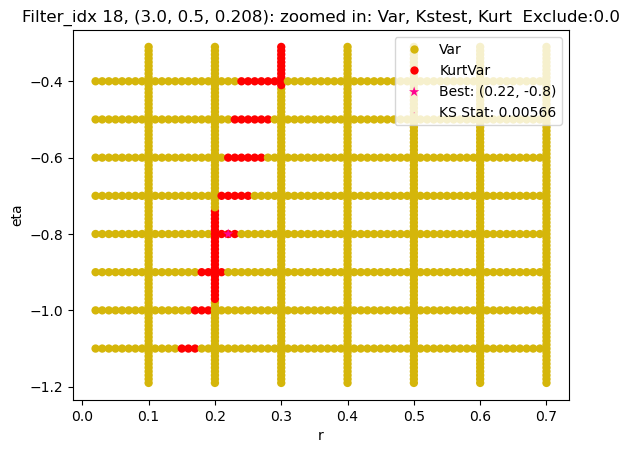

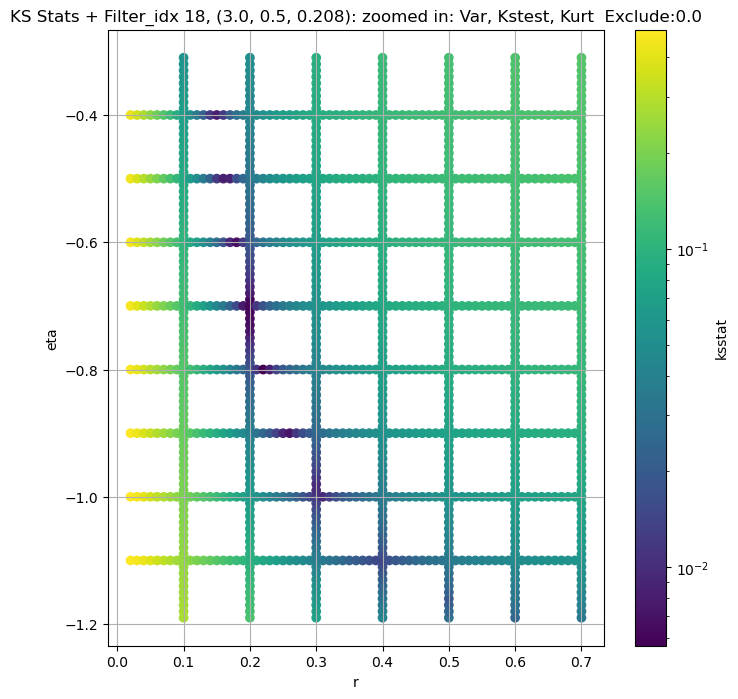

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 50.0 + 100 = 150, ksstat: 0.005715301042647385, var: 257.60369873046875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 50.0 + 75 = 125, ksstat: 0.005068304740414864, var: 264.4961242675781


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 50.0 + 50 = 100, ksstat: 0.004823031982962078, var: 272.0582580566406


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 50.0 + 25 = 75, ksstat: 0.0048032741292372005, var: 280.43927001953125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 50.0 + 0 = 50, ksstat: 0.005015236185675898, var: 289.9503479003906


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 50.0 + -25 = 25, ksstat: 0.005238557265108079, var: 301.7064208984375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 19, 50.0 + -50 = 0, ksstat: 0.005080732040773528, var: 321.7018737792969
Number of samples: 100000, Without approximation : 65536000.0


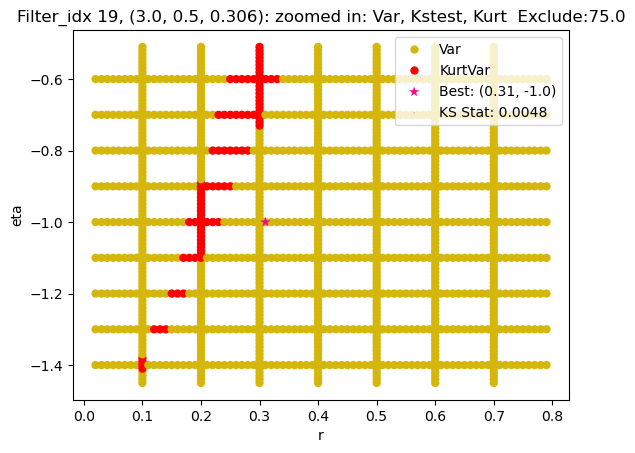

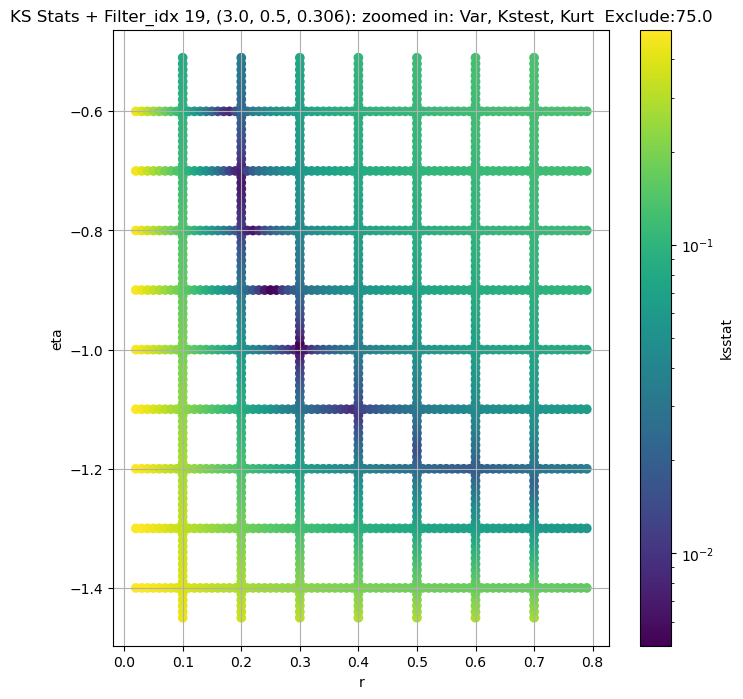

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.009428923976230297, var: 130.93978881835938


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.008684790291538382, var: 135.7166290283203


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.00769689665786083, var: 141.2353515625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.007769368089748485, var: 147.78135681152344


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.008194334735770026, var: 159.4351043701172
Number of samples: 100000, Without approximation : 65536000.0


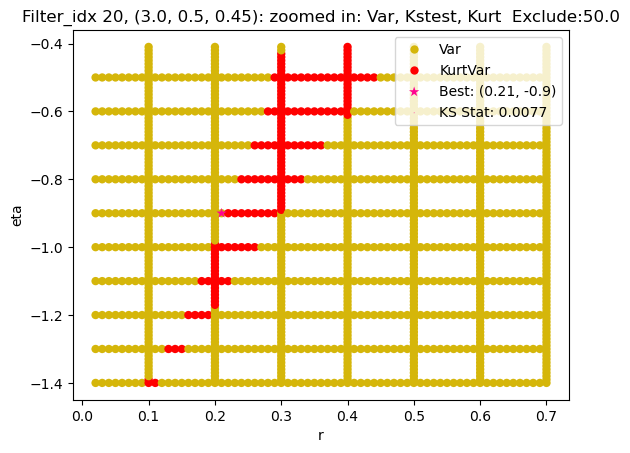

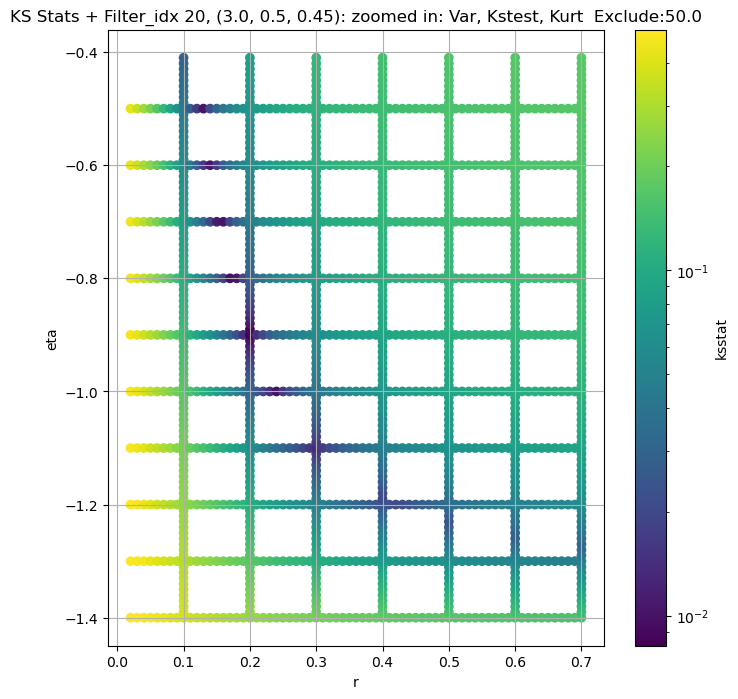

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 0.0 + 100 = 100, ksstat: 0.005712642580062766, var: 45932.48046875


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 0.0 + 75 = 75, ksstat: 0.005875726978950946, var: 46850.640625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 0.0 + 50 = 50, ksstat: 0.0052360614238949055, var: 47893.62890625


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 0.0 + 25 = 25, ksstat: 0.005483742042927564, var: 49135.5859375


  0%|          | 0/1600 [00:00<?, ?it/s]

Finding Minimum after computing 1600 CDFs
filter_idx 21, 0.0 + 0 = 0, ksstat: 0.005617084867626909, var: 51052.1953125
Number of samples: 100000, Without approximation : 65536000.0


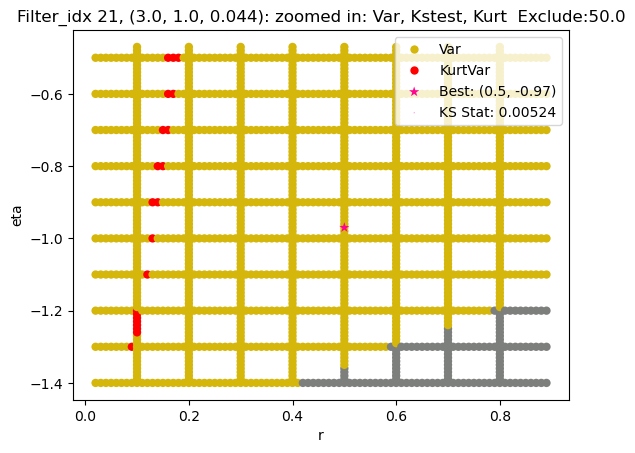

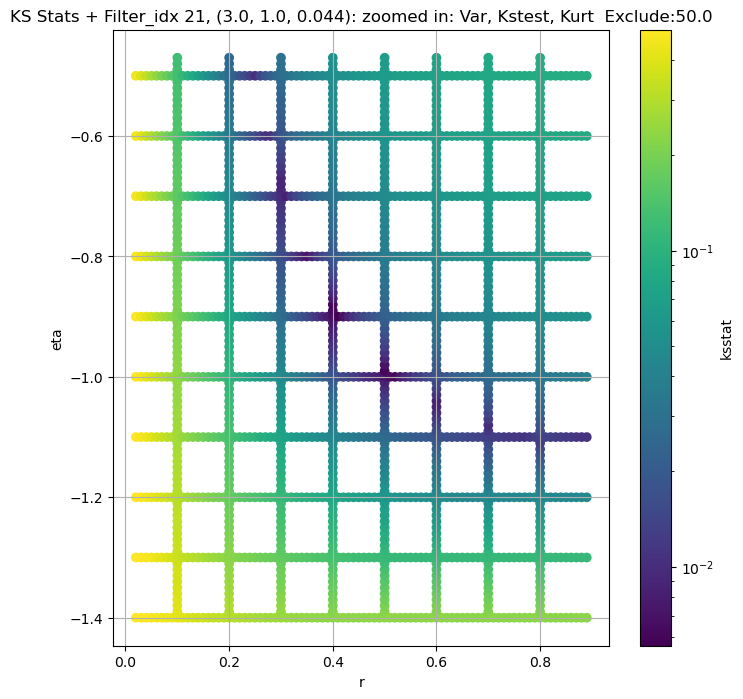

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.006947457532667012, var: 16113.6083984375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.006650998173089784, var: 16482.193359375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.005920295748349194, var: 16904.166015625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.0063667358641074645, var: 17404.0546875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.0056584213306571235, var: 18193.46875
Number of samples: 100000, Without approximation : 65536000.0


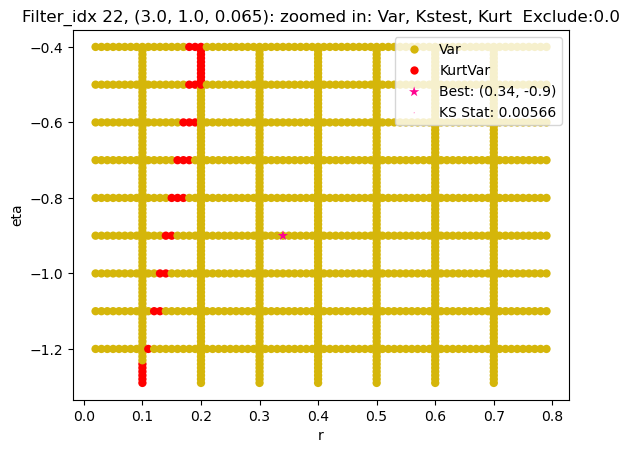

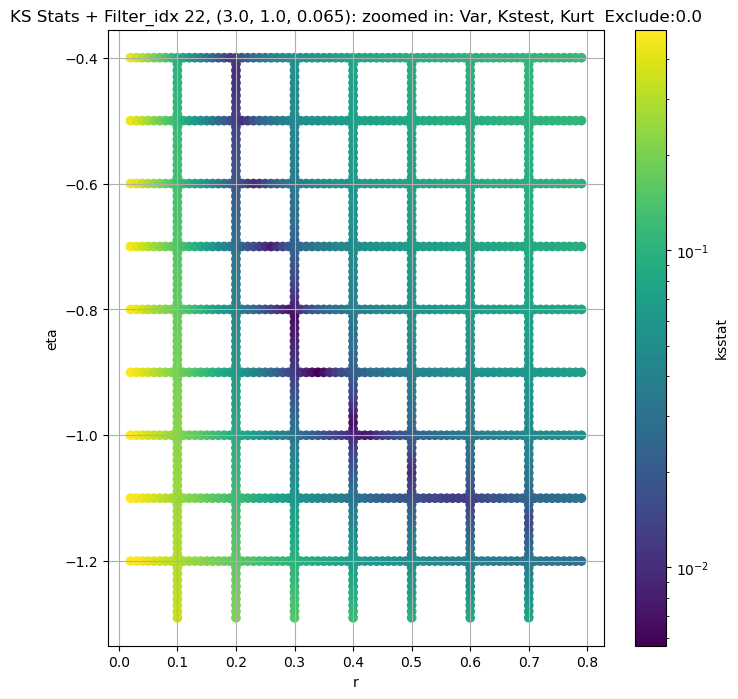

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.007396194290372679, var: 5955.38037109375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.007239213828590052, var: 6121.00732421875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.005991590555909365, var: 6314.31884765625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.005914756850039948, var: 6552.78564453125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.005703472552291755, var: 6965.806640625
Number of samples: 100000, Without approximation : 65536000.0


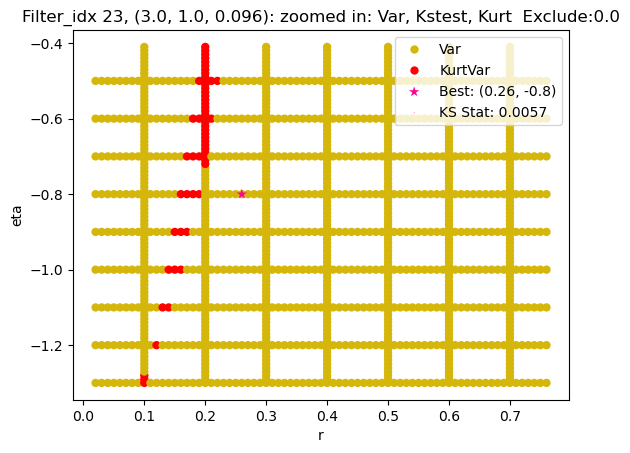

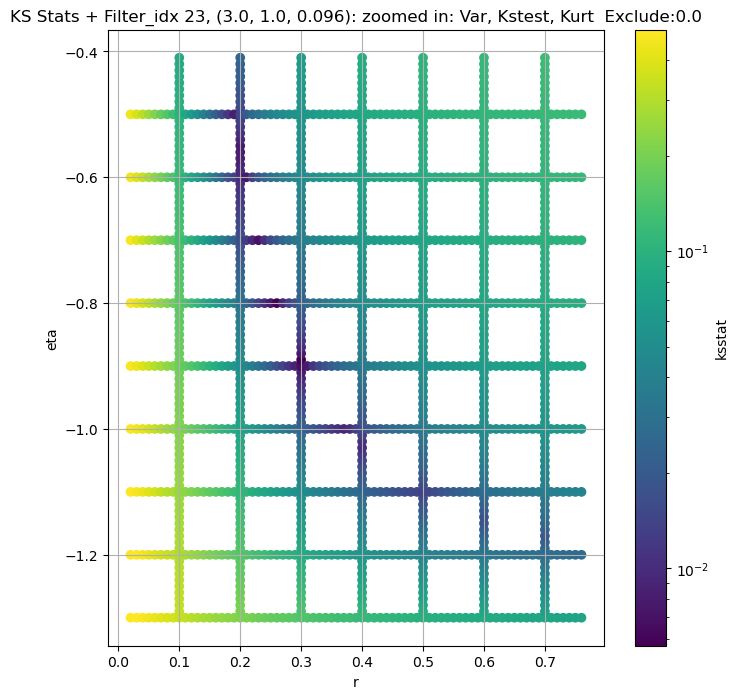

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + 100 = 200, ksstat: 0.008108917775046298, var: 1848.487060546875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + 75 = 175, ksstat: 0.008046619947162825, var: 1891.49072265625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + 50 = 150, ksstat: 0.007220781162049716, var: 1938.26123046875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + 25 = 125, ksstat: 0.0068626904286750445, var: 1989.6141357421875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + 0 = 100, ksstat: 0.006897289693441944, var: 2046.69287109375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + -25 = 75, ksstat: 0.007353198687030396, var: 2111.747802734375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + -50 = 50, ksstat: 0.006078168795067687, var: 2189.194091796875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + -75 = 25, ksstat: 0.006744879342662394, var: 2287.508544921875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 24, 100.0 + -100 = 0, ksstat: 0.005051487956183043, var: 2463.0537109375
Number of samples: 100000, Without approximation : 65536000.0


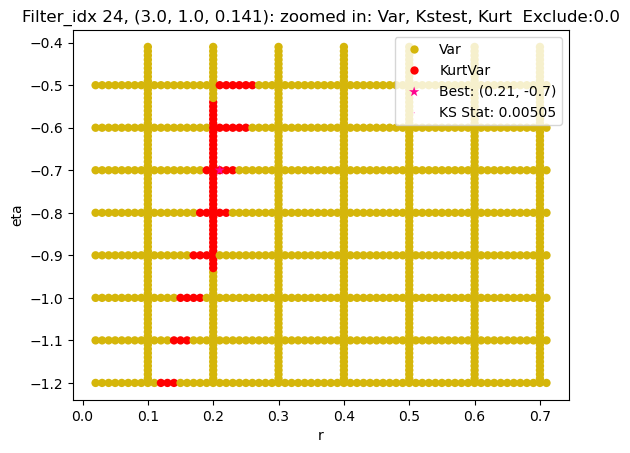

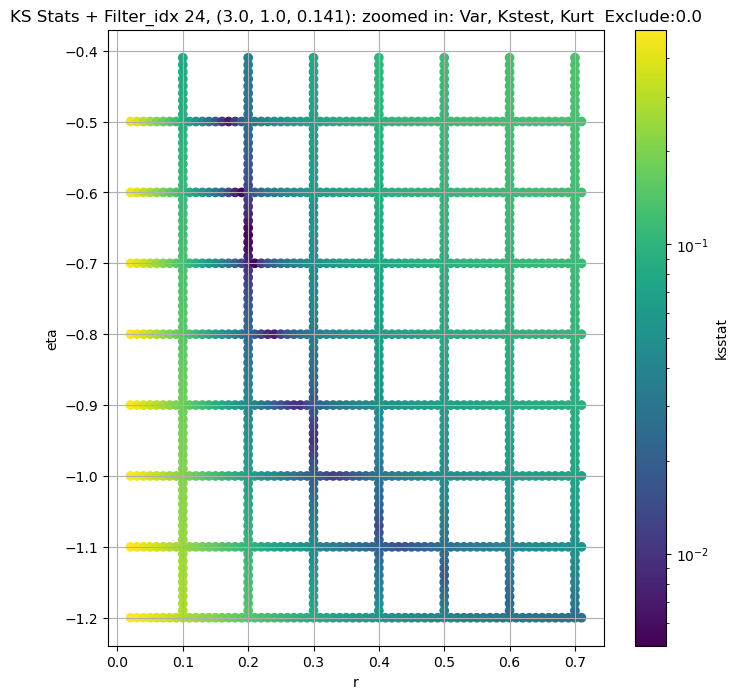

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 100 = 150, ksstat: 0.006917365324456748, var: 721.172607421875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 75 = 125, ksstat: 0.006555499484632299, var: 742.5982055664062


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 50 = 100, ksstat: 0.006023601753559253, var: 766.675048828125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 25 = 75, ksstat: 0.006091096636601796, var: 794.2332763671875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 0 = 50, ksstat: 0.005546986396208875, var: 826.4287719726562


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + -25 = 25, ksstat: 0.0047773004674189976, var: 867.38427734375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + -50 = 0, ksstat: 0.004463246621537631, var: 940.5836181640625
Number of samples: 100000, Without approximation : 65536000.0


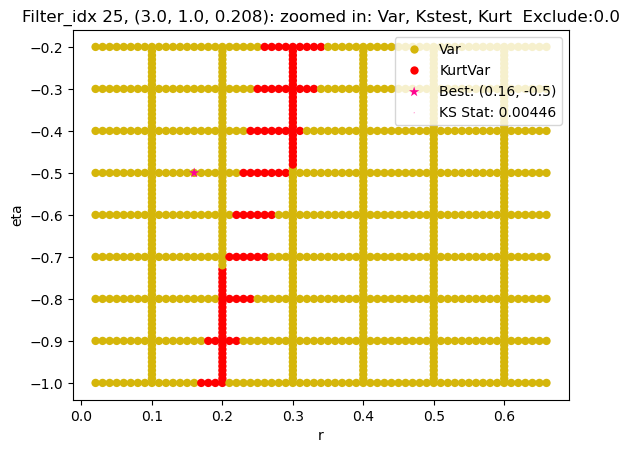

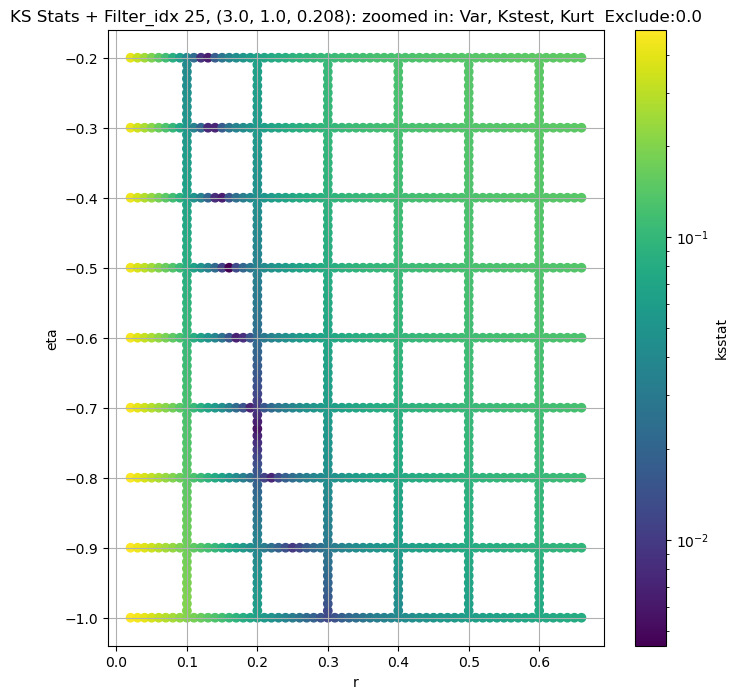

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.00478254231865205, var: 301.04962158203125


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.0051516208727634405, var: 313.7166442871094


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.005247673524428342, var: 328.9334411621094


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.005320524314587294, var: 348.5884094238281


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.005365159208496395, var: 383.1720886230469
Number of samples: 100000, Without approximation : 65536000.0


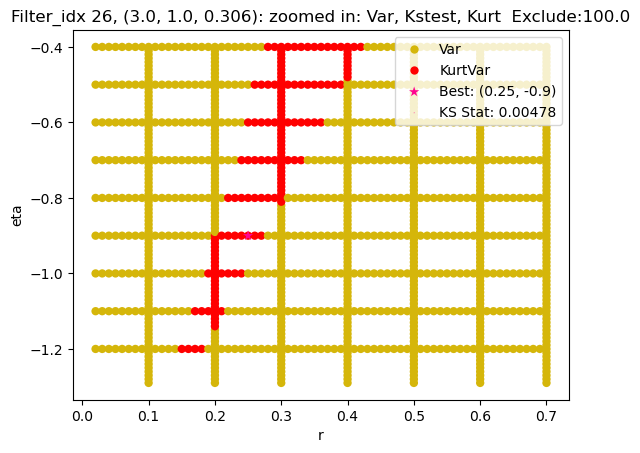

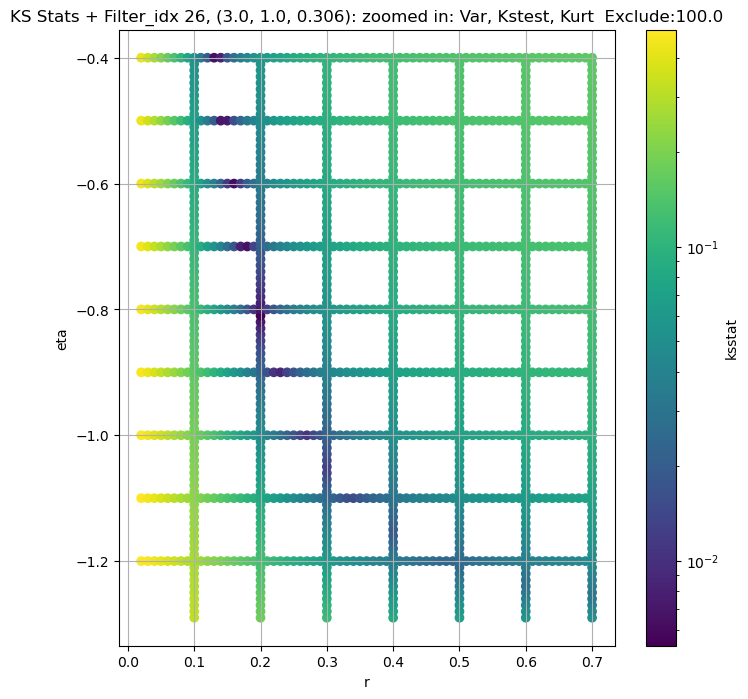

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/895 [00:00<?, ?it/s]

Finding Minimum after computing 895 CDFs
filter_idx 27, 0.0 + 100 = 100, ksstat: 0.008402333031544973, var: 128.354736328125


  0%|          | 0/895 [00:00<?, ?it/s]

Finding Minimum after computing 895 CDFs
filter_idx 27, 0.0 + 75 = 75, ksstat: 0.008774341860952828, var: 134.19552612304688


  0%|          | 0/895 [00:00<?, ?it/s]

Finding Minimum after computing 895 CDFs
filter_idx 27, 0.0 + 50 = 50, ksstat: 0.007446153171270176, var: 141.26663208007812


  0%|          | 0/895 [00:00<?, ?it/s]

Finding Minimum after computing 895 CDFs
filter_idx 27, 0.0 + 25 = 25, ksstat: 0.0077424011601859855, var: 150.39419555664062


  0%|          | 0/895 [00:00<?, ?it/s]

Finding Minimum after computing 895 CDFs
filter_idx 27, 0.0 + 0 = 0, ksstat: 0.006586504881032518, var: 166.43943786621094
Number of samples: 100000, Without approximation : 65536000.0


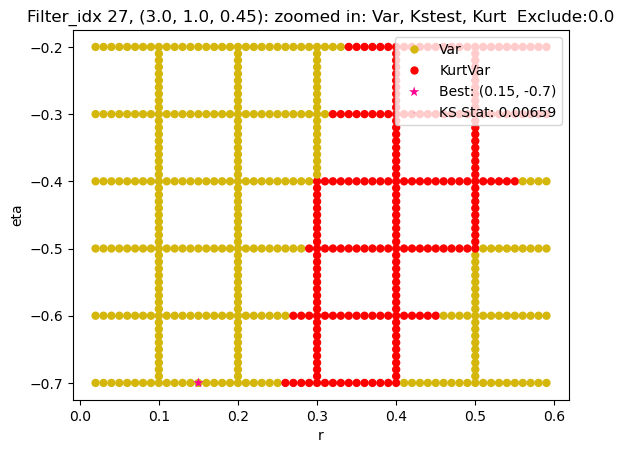

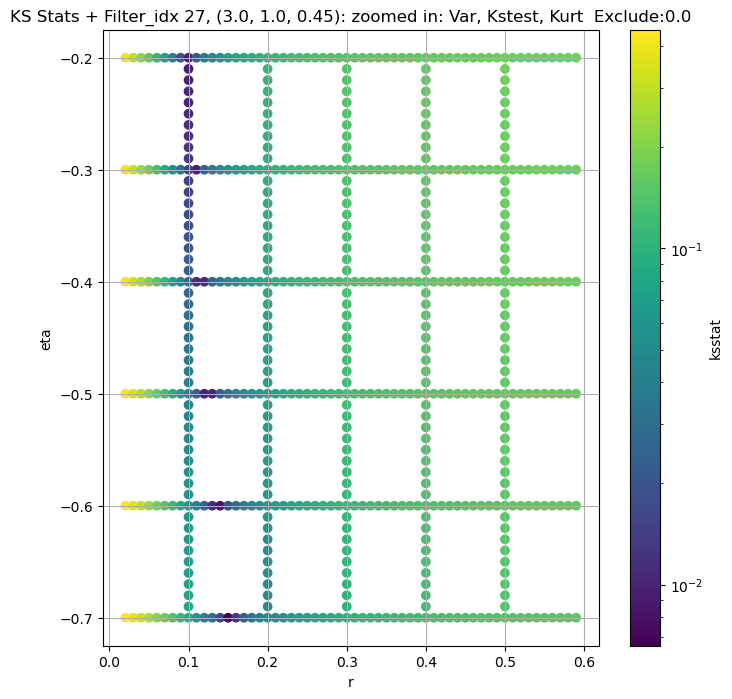

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.005788125523600862, var: 36867.3515625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.0055588754622662995, var: 37434.796875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.005594974865061497, var: 38068.2109375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.004968058448098334, var: 38801.0078125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.0047712300714266576, var: 39986.55859375
Number of samples: 100000, Without approximation : 65536000.0


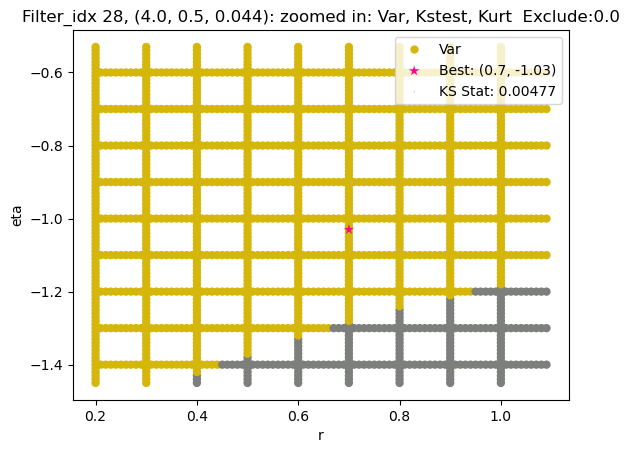

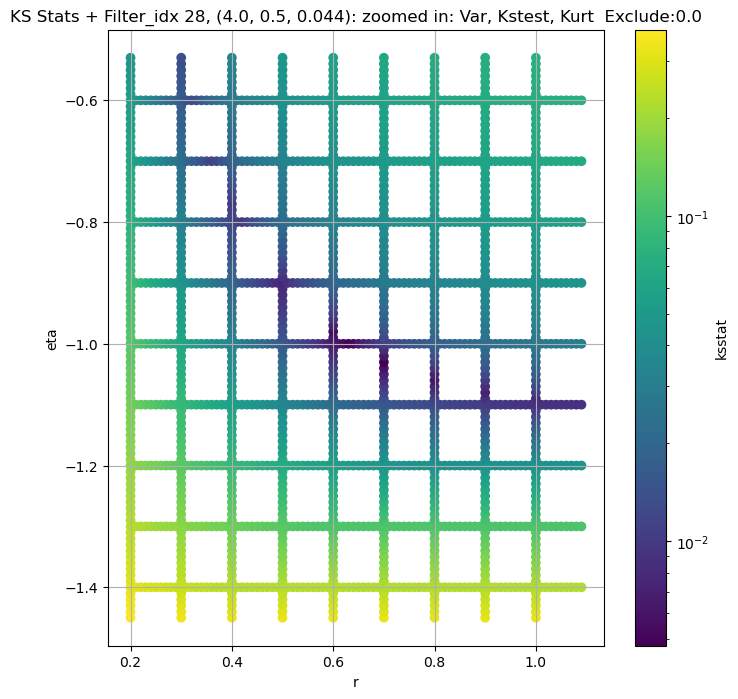

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 29, 50.0 + 100 = 150, ksstat: 0.007752298474481112, var: 12925.7587890625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 29, 50.0 + 75 = 125, ksstat: 0.007599934390535454, var: 13134.4140625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 29, 50.0 + 50 = 100, ksstat: 0.0068949061251680765, var: 13360.783203125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 29, 50.0 + 25 = 75, ksstat: 0.0072118006123778056, var: 13609.2724609375


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 29, 50.0 + 0 = 50, ksstat: 0.006941065400239421, var: 13888.8447265625


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 29, 50.0 + -25 = 25, ksstat: 0.006809930454179838, var: 14220.1767578125


  0%|          | 0/1656 [00:00<?, ?it/s]

Finding Minimum after computing 1656 CDFs
filter_idx 29, 50.0 + -50 = 0, ksstat: 0.0055255363820656545, var: 14740.787109375
Number of samples: 100000, Without approximation : 65536000.0


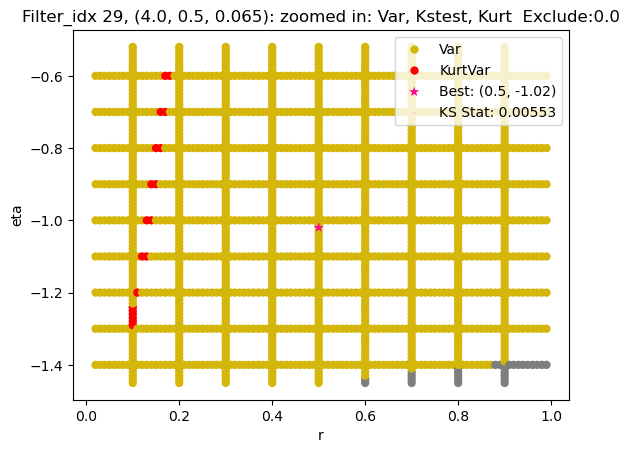

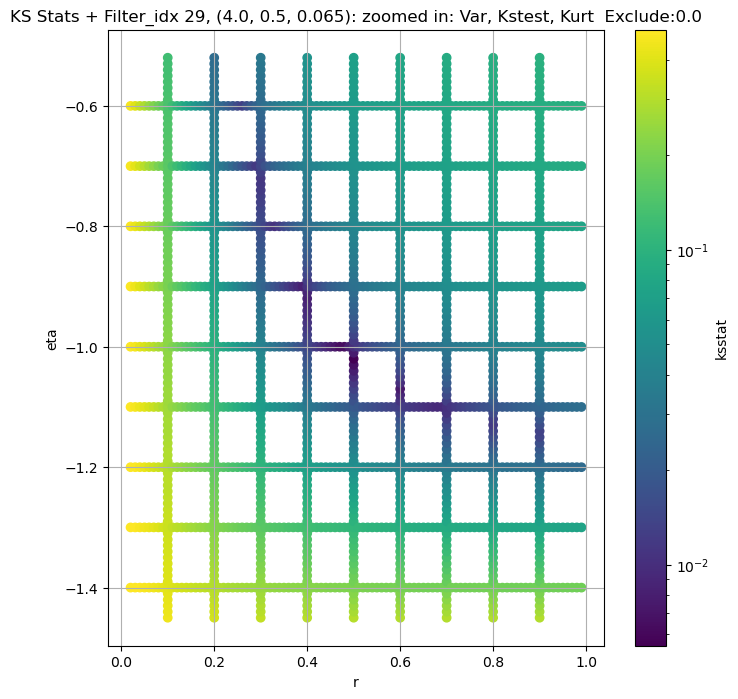

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.00816315299694137, var: 4789.0322265625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.007782471455648365, var: 4892.42919921875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.0074293385388264355, var: 5010.29248046875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.006930404390566081, var: 5153.84228515625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.006808012667578689, var: 5437.47119140625
Number of samples: 100000, Without approximation : 65536000.0


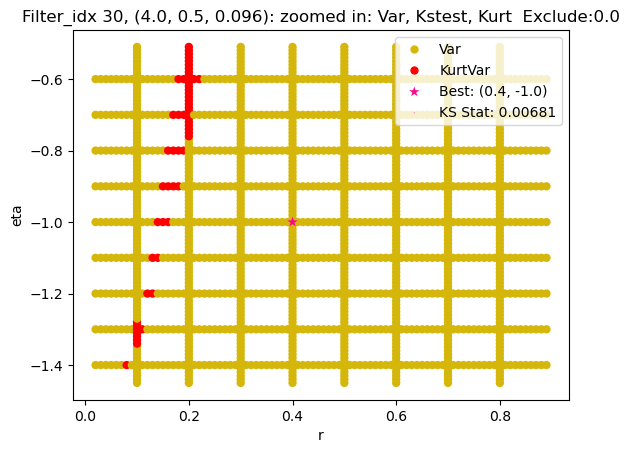

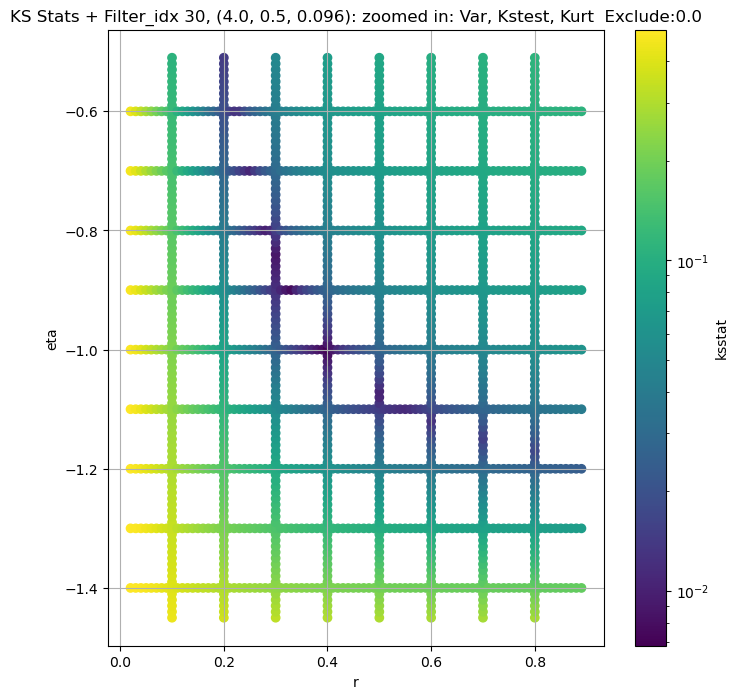

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 50.0 + 100 = 150, ksstat: 0.008740012599497804, var: 1648.4071044921875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 50.0 + 75 = 125, ksstat: 0.009076846142240691, var: 1683.2105712890625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 50.0 + 50 = 100, ksstat: 0.008339487912682464, var: 1721.6328125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 50.0 + 25 = 75, ksstat: 0.009160087186066146, var: 1764.734130859375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 50.0 + 0 = 50, ksstat: 0.008712488866277956, var: 1814.5084228515625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 50.0 + -25 = 25, ksstat: 0.007954564966201283, var: 1875.16064453125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 50.0 + -50 = 0, ksstat: 0.0069315562897340754, var: 1979.1009521484375
Number of samples: 100000, Without approximation : 65536000.0


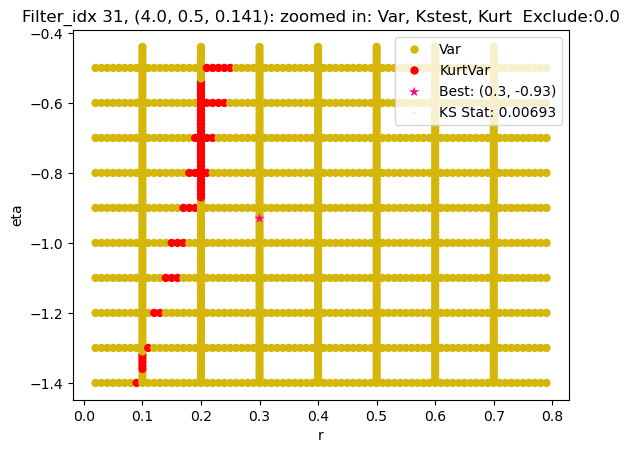

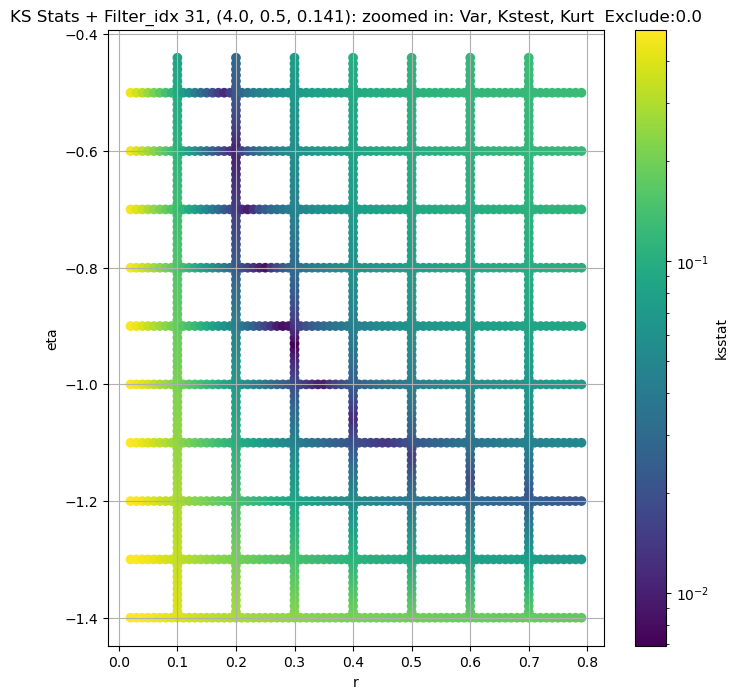

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + 100 = 200, ksstat: 0.008055544145159868, var: 587.8289184570312


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + 75 = 175, ksstat: 0.00746322040142533, var: 599.875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + 50 = 150, ksstat: 0.00777682604322355, var: 612.8439331054688


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + 25 = 125, ksstat: 0.007270634073693993, var: 626.9446411132812


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + 0 = 100, ksstat: 0.007129702590458226, var: 642.4346313476562


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + -25 = 75, ksstat: 0.006670579150293121, var: 659.8098754882812


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + -50 = 50, ksstat: 0.006048252069180457, var: 680.0643920898438


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + -75 = 25, ksstat: 0.005739186142322994, var: 705.3013916015625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 32, 100.0 + -100 = 0, ksstat: 0.006071636402122937, var: 751.44921875
Number of samples: 100000, Without approximation : 65536000.0


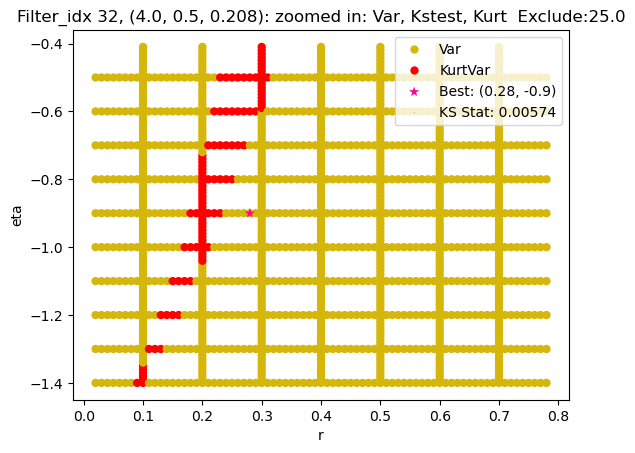

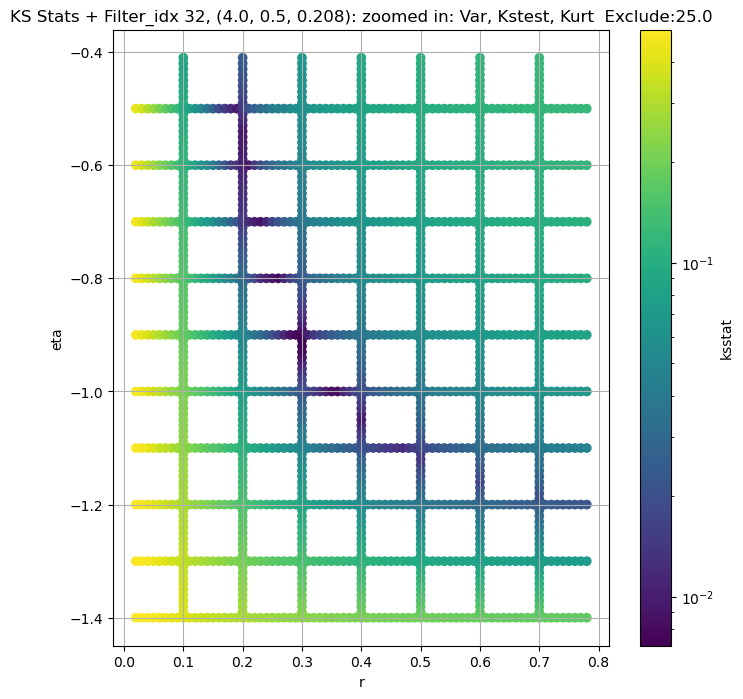

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 33, 50.0 + 100 = 150, ksstat: 0.005989190065499712, var: 246.0518798828125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 33, 50.0 + 75 = 125, ksstat: 0.005640101471639181, var: 252.76318359375


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 33, 50.0 + 50 = 100, ksstat: 0.005101756299236374, var: 260.2536926269531


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 33, 50.0 + 25 = 75, ksstat: 0.0046527605559979895, var: 268.7823486328125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 33, 50.0 + 0 = 50, ksstat: 0.005009974074726253, var: 278.8218688964844


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 33, 50.0 + -25 = 25, ksstat: 0.0045249153185457636, var: 291.4273681640625


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 33, 50.0 + -50 = 0, ksstat: 0.004484345551082736, var: 314.1521911621094
Number of samples: 100000, Without approximation : 65536000.0


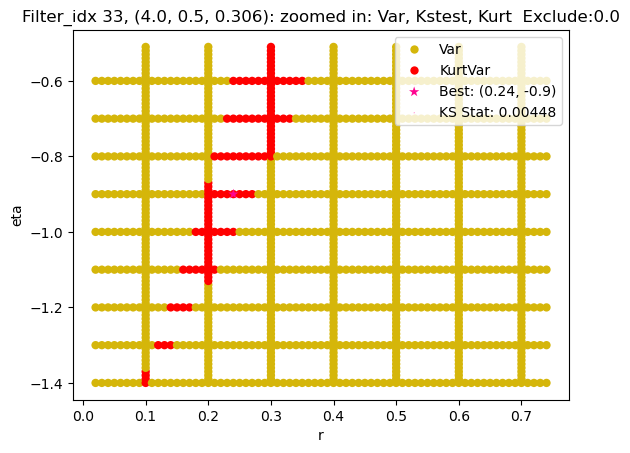

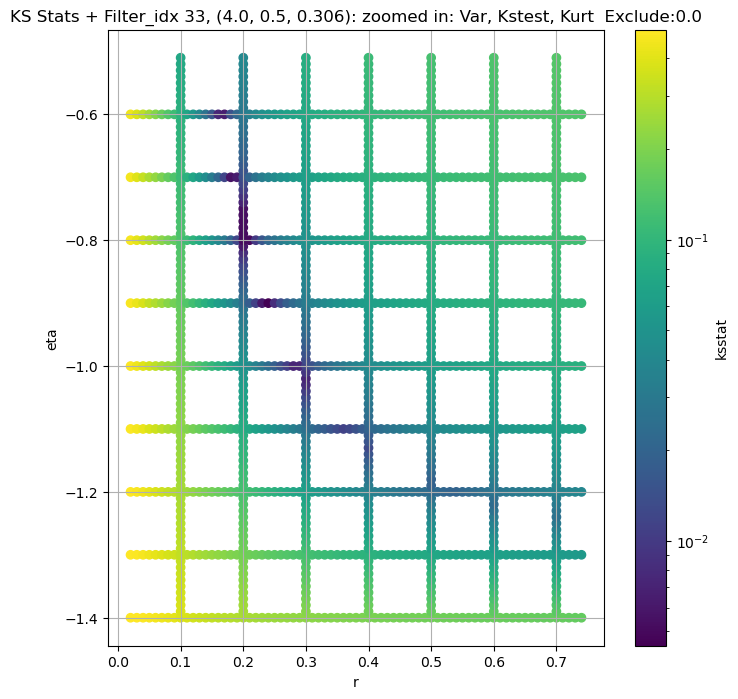

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 50.0 + 100 = 150, ksstat: 0.010922326349411045, var: 106.74423217773438


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 50.0 + 75 = 125, ksstat: 0.011051621643035248, var: 110.13477325439453


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 50.0 + 50 = 100, ksstat: 0.010471340563244835, var: 113.89838409423828


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 50.0 + 25 = 75, ksstat: 0.00980806919498356, var: 118.10271453857422


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 50.0 + 0 = 50, ksstat: 0.010358412346624324, var: 123.08576202392578


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 50.0 + -25 = 25, ksstat: 0.00968735125002372, var: 129.53729248046875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 50.0 + -50 = 0, ksstat: 0.010216991981068957, var: 142.6647491455078
Number of samples: 100000, Without approximation : 65536000.0


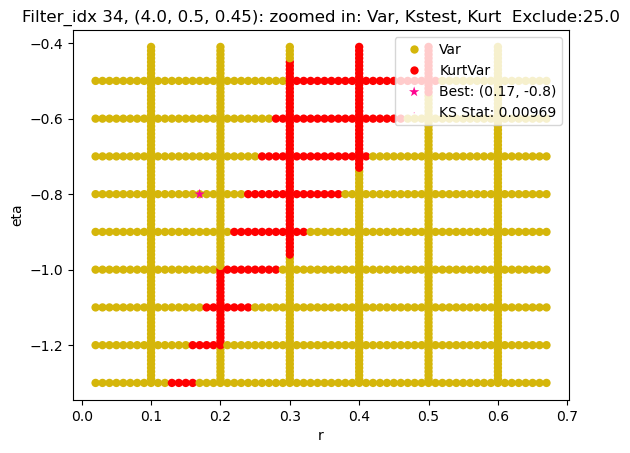

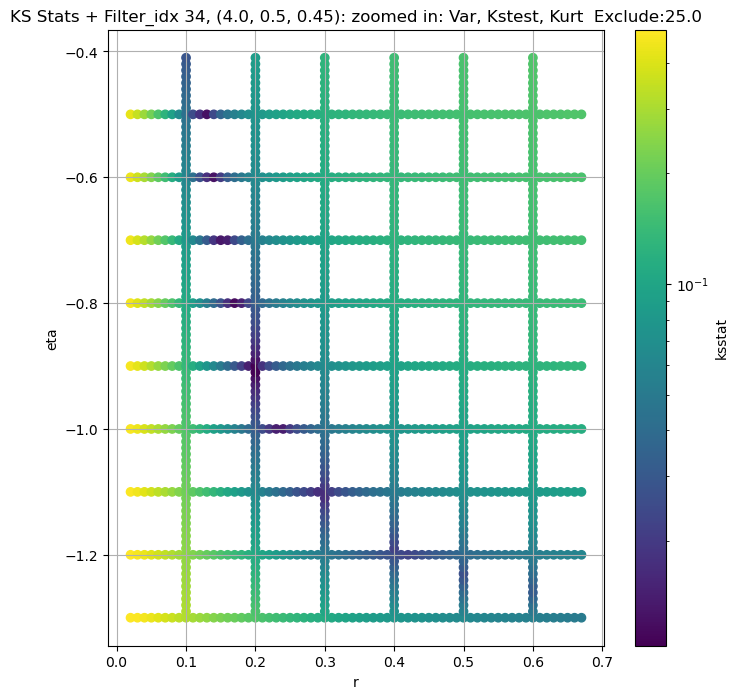

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 100 = 150, ksstat: 0.004447149577109788, var: 39513.25


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 75 = 125, ksstat: 0.004276991815102771, var: 40237.09375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 50 = 100, ksstat: 0.0036223701205600894, var: 41030.640625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 25 = 75, ksstat: 0.0035510205873336975, var: 41909.51953125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 0 = 50, ksstat: 0.003202029417765262, var: 42910.33203125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + -25 = 25, ksstat: 0.003405697983106304, var: 44111.52734375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + -50 = 0, ksstat: 0.0026678339397679385, var: 45943.4296875
Number of samples: 100000, Without approximation : 65536000.0


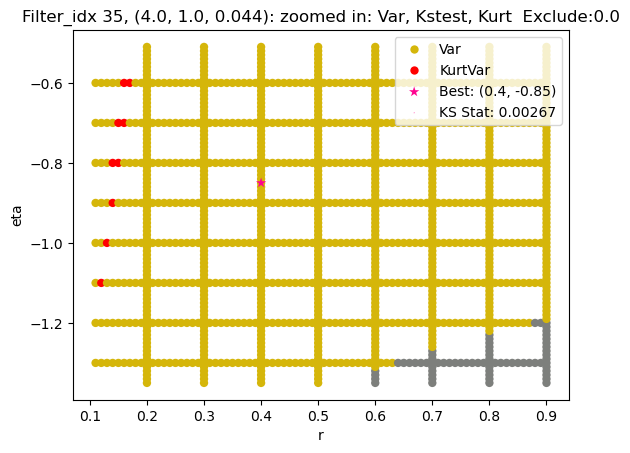

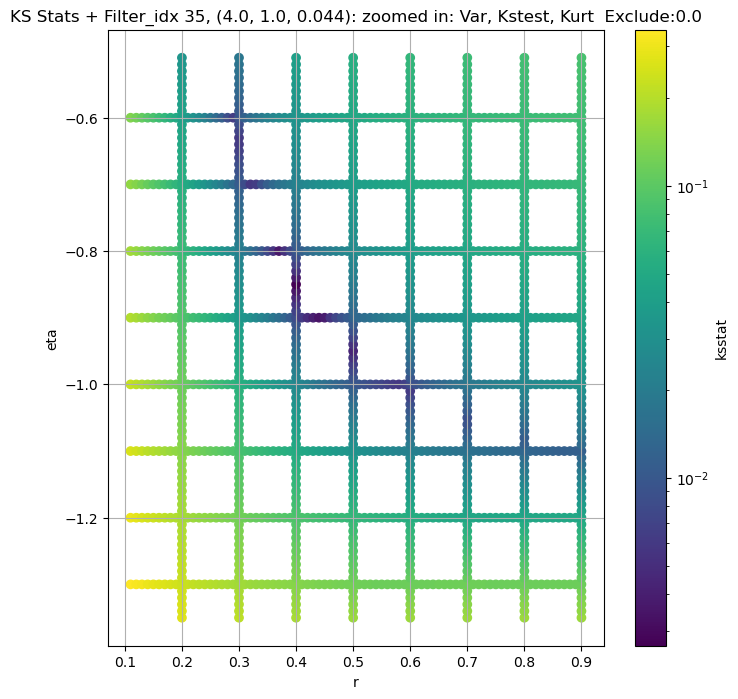

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.004252812577614007, var: 14521.1201171875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.003885232254942639, var: 14892.3037109375


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.003976607395468956, var: 15321.5498046875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.004425218459303659, var: 15840.453125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.0034090336948562616, var: 16675.236328125
Number of samples: 100000, Without approximation : 65536000.0


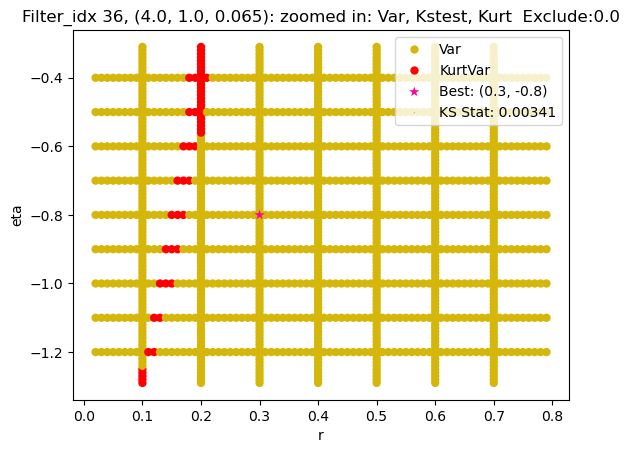

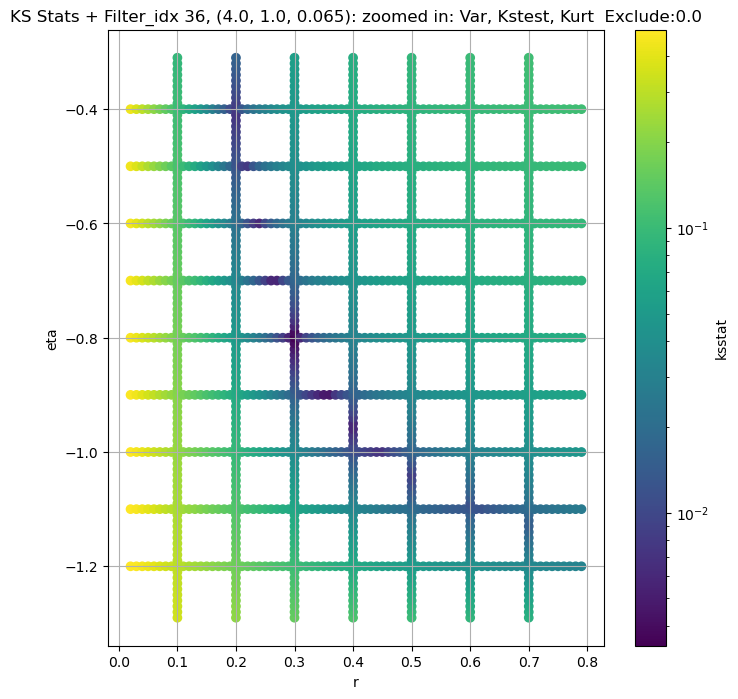

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 0.0 + 100 = 100, ksstat: 0.005383723143293939, var: 5082.98583984375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 0.0 + 75 = 75, ksstat: 0.005573052414917512, var: 5236.1806640625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 0.0 + 50 = 50, ksstat: 0.005045543999428859, var: 5415.9990234375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 0.0 + 25 = 25, ksstat: 0.005387399550573435, var: 5637.30517578125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 0.0 + 0 = 0, ksstat: 0.004958297781716858, var: 6021.7158203125
Number of samples: 100000, Without approximation : 65536000.0


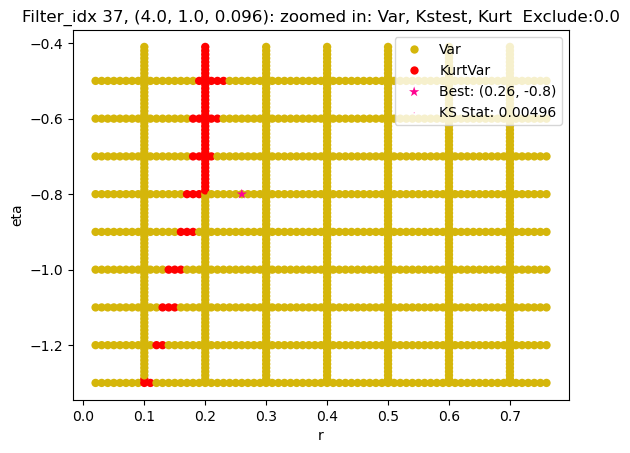

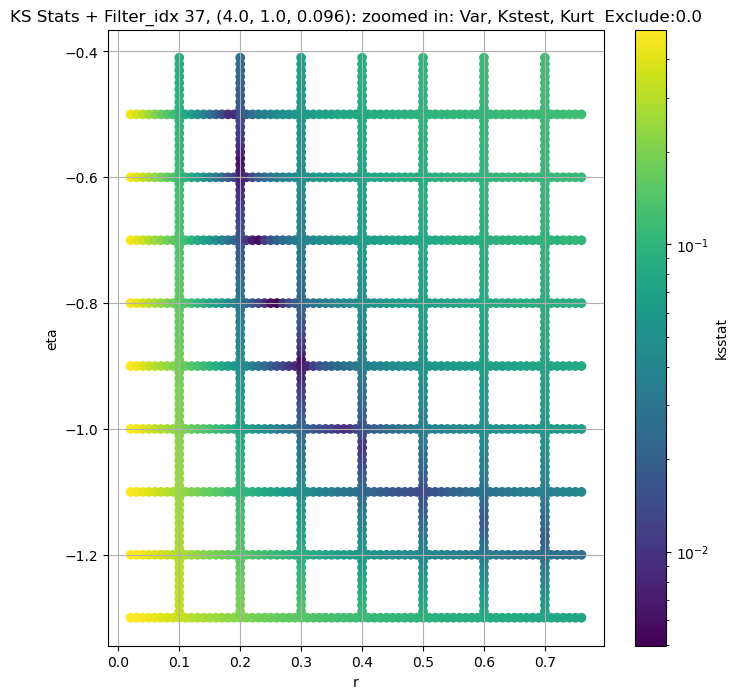

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.006539255160124546, var: 1867.9298095703125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.0065588064184901596, var: 1932.8468017578125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.006299590107117559, var: 2010.3145751953125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.005180436379837783, var: 2108.8935546875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.005033494607705746, var: 2283.294677734375
Number of samples: 100000, Without approximation : 65536000.0


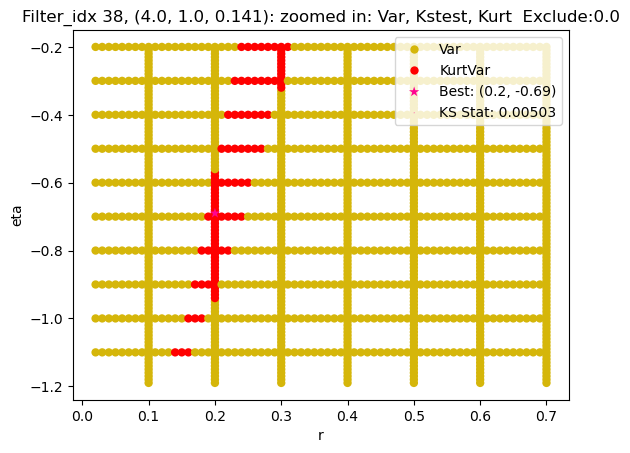

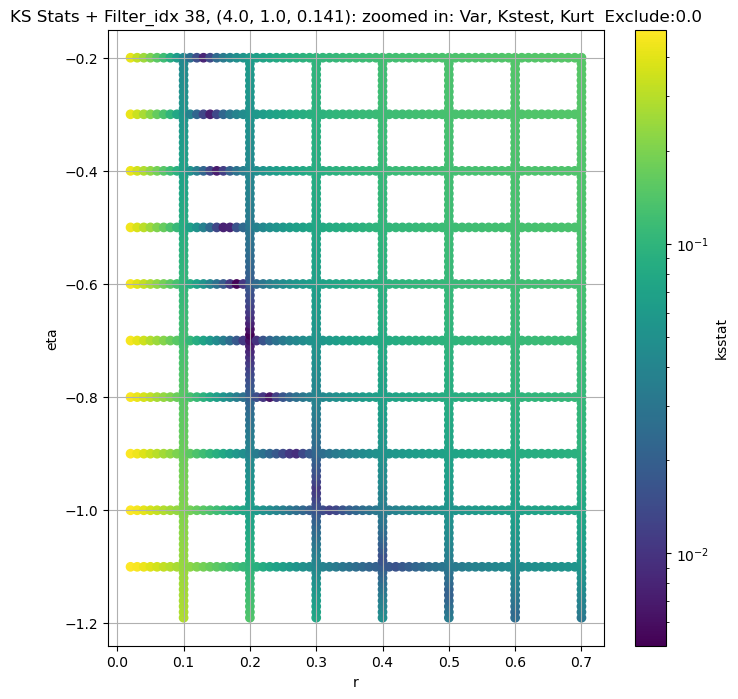

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 39, 50.0 + 100 = 150, ksstat: 0.005669958483667248, var: 677.7684326171875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 39, 50.0 + 75 = 125, ksstat: 0.005702411122333606, var: 699.78369140625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 39, 50.0 + 50 = 100, ksstat: 0.004736151335600569, var: 724.409912109375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 39, 50.0 + 25 = 75, ksstat: 0.004737024791358957, var: 752.51416015625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 39, 50.0 + 0 = 50, ksstat: 0.003953017778530479, var: 785.3289794921875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 39, 50.0 + -25 = 25, ksstat: 0.004224563878381216, var: 827.09765625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 39, 50.0 + -50 = 0, ksstat: 0.0036309732106267756, var: 908.6674194335938
Number of samples: 100000, Without approximation : 65536000.0


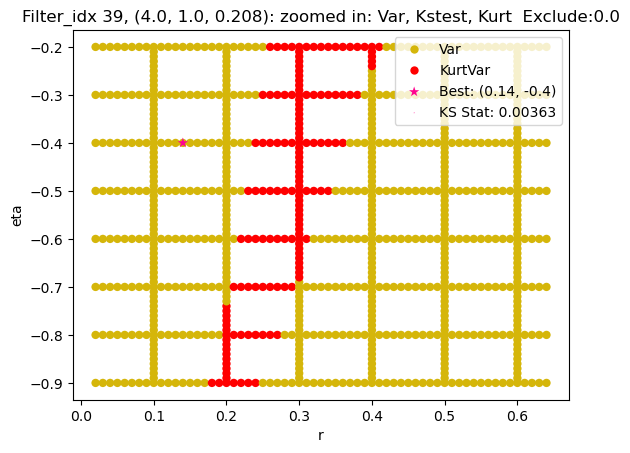

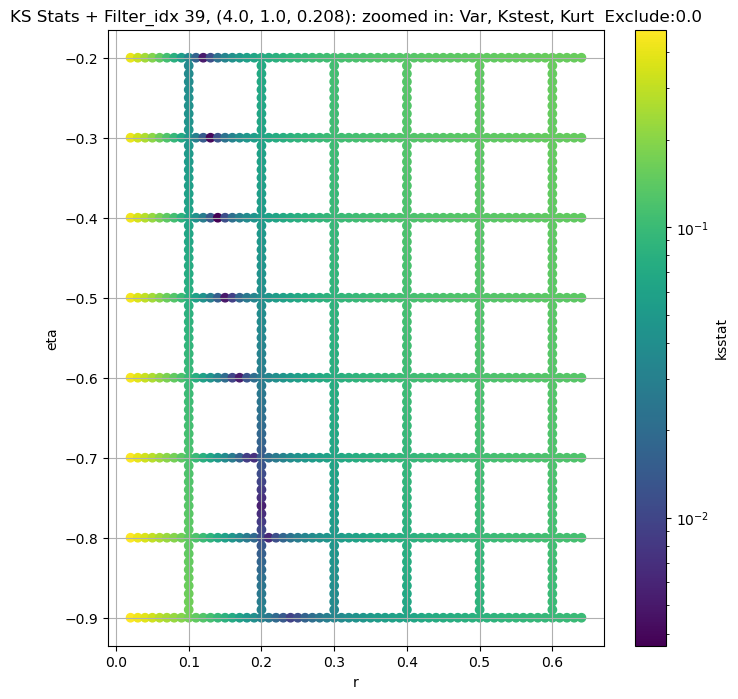

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 100 = 150, ksstat: 0.004695040744683077, var: 254.3758087158203


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 75 = 125, ksstat: 0.004502975004900378, var: 263.7423095703125


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 50 = 100, ksstat: 0.004014899340662126, var: 274.3735046386719


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 25 = 75, ksstat: 0.0036402052825693643, var: 286.6554260253906


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 0 = 50, ksstat: 0.0031256710328313453, var: 301.43316650390625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + -25 = 25, ksstat: 0.0028502648448729406, var: 320.5384216308594


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + -50 = 0, ksstat: 0.002946615562351873, var: 356.08856201171875
Number of samples: 100000, Without approximation : 65536000.0


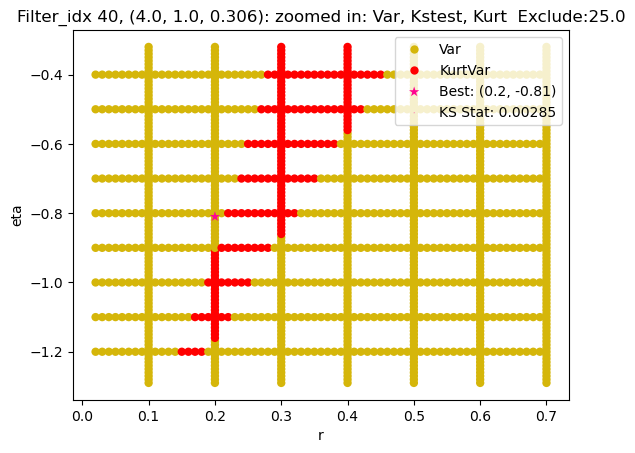

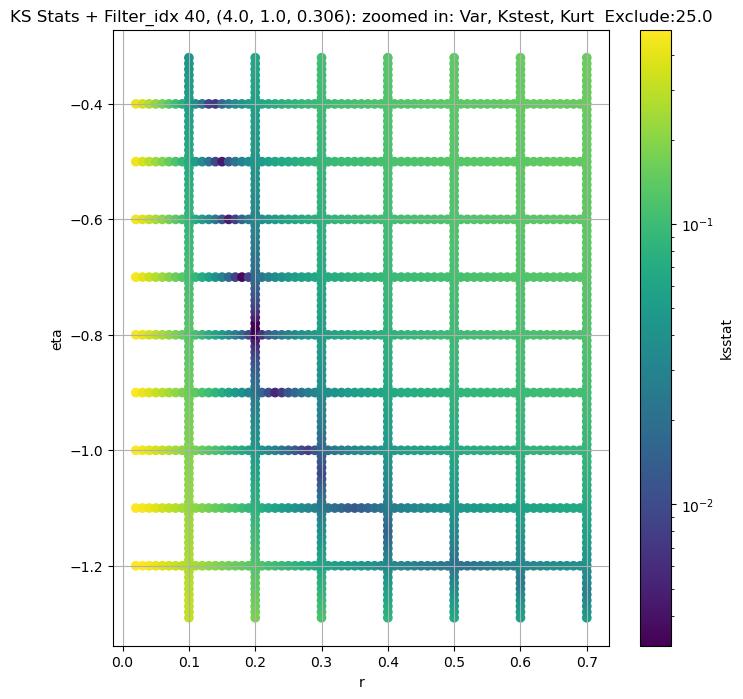

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + 100 = 200, ksstat: 0.009067299522405842, var: 98.70350646972656


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + 75 = 175, ksstat: 0.009324516007334638, var: 102.11637878417969


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + 50 = 150, ksstat: 0.008308385430925602, var: 105.9175033569336


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + 25 = 125, ksstat: 0.009085286521520408, var: 110.20500183105469


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + 0 = 100, ksstat: 0.008185093245105635, var: 115.11125183105469


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + -25 = 75, ksstat: 0.007625066057326449, var: 121.00060272216797


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + -50 = 50, ksstat: 0.007247686794405017, var: 128.3920135498047


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + -75 = 25, ksstat: 0.00837541319764333, var: 138.44992065429688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 41, 100.0 + -100 = 0, ksstat: 0.006417361783004852, var: 158.14862060546875
Number of samples: 100000, Without approximation : 65536000.0


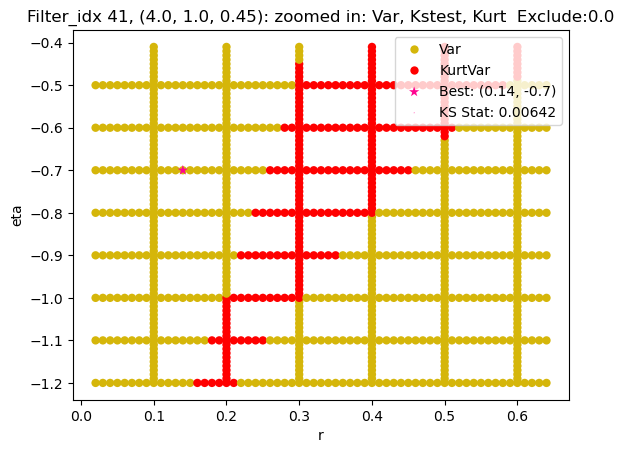

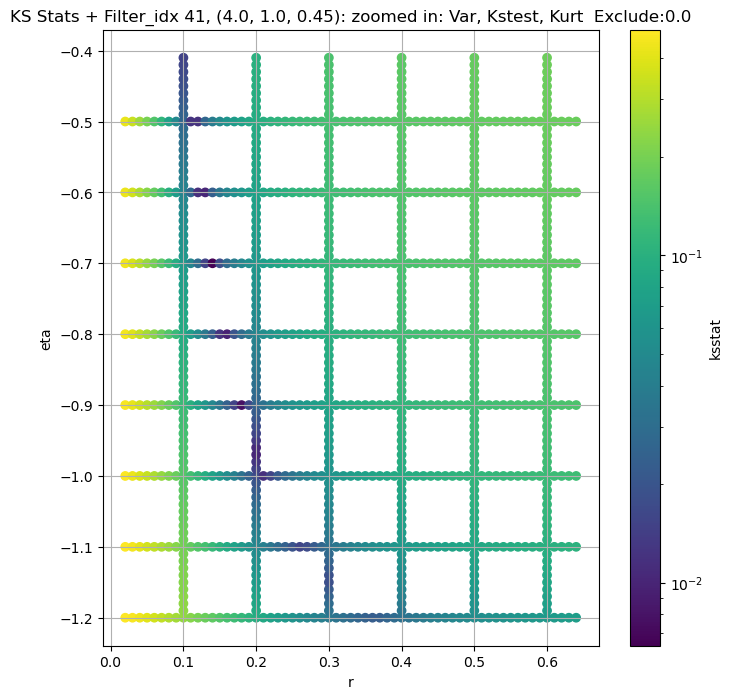

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",45245.52700,35149.957000,55858.81000,5.495759,3.202812,11.596157,65536000.0,"(2.0, 0.5, 0.044)",0.008383,...,5.200671e+04,50.0,44255.621094,0.000168,0.005198,0.90,-1.07,91943.137003,25.0,72000
1,"(2.0, 0.5, 0.065)",16159.34800,12461.857000,20982.10400,7.577845,4.145749,20.689200,65536000.0,"(2.0, 0.5, 0.065)",0.007421,...,2.518565e+04,0.0,16159.347656,0.000168,0.005916,0.60,-1.06,16238.341251,0.0,54000
2,"(2.0, 0.5, 0.096)",5922.31700,4530.947300,7658.35350,9.172287,4.752912,22.550383,65536000.0,"(2.0, 0.5, 0.096)",0.008738,...,7.966054e+03,200.0,5258.366211,0.000168,0.007575,0.60,-1.07,5444.975410,150.0,32000
3,"(2.0, 0.5, 0.141)",2186.18210,1604.981600,2941.15360,11.885174,6.001125,31.736656,65536000.0,"(2.0, 0.5, 0.141)",0.006204,...,4.480140e+02,0.0,2105.972656,0.000168,0.006192,0.40,-0.99,416.743571,25.0,48000
4,"(2.0, 0.5, 0.208)",896.74567,626.061100,1207.41710,14.605139,7.902795,40.446873,65536000.0,"(2.0, 0.5, 0.208)",0.006376,...,2.234660e+01,0.0,896.745667,0.000168,0.005282,0.35,-1.00,91.458439,0.0,64000
5,"(2.0, 0.5, 0.306)",319.77920,214.653400,441.71838,17.831026,8.364756,54.464200,65536000.0,"(2.0, 0.5, 0.306)",0.008145,...,4.758619e-02,0.0,319.779205,0.000168,0.008124,0.31,-1.00,15.160471,0.0,27000
6,"(2.0, 0.5, 0.45)",201.80780,138.282550,288.14822,18.420538,9.052644,56.183180,65536000.0,"(2.0, 0.5, 0.45)",0.009422,...,7.590877e+00,0.0,185.686508,0.000168,0.009419,0.31,-1.00,8.803246,50.0,20250
7,"(2.0, 1.0, 0.044)",62793.04300,49965.652000,79623.72000,6.657730,3.644785,17.155079,65536000.0,"(2.0, 1.0, 0.044)",0.002730,...,7.494678e+04,0.0,62793.042969,0.000168,0.002405,0.72,-1.00,79051.535900,0.0,324000
8,"(2.0, 1.0, 0.065)",22699.83200,17202.203000,29541.35500,8.707811,4.386791,26.468680,65536000.0,"(2.0, 1.0, 0.065)",0.006087,...,1.764909e+04,100.0,22699.832031,0.000168,0.003523,0.54,-1.00,14464.082714,0.0,144000


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

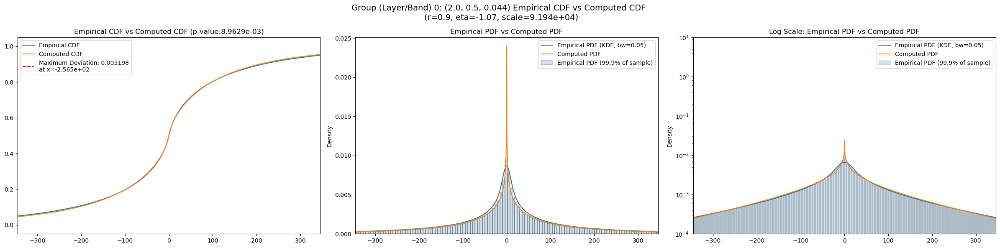

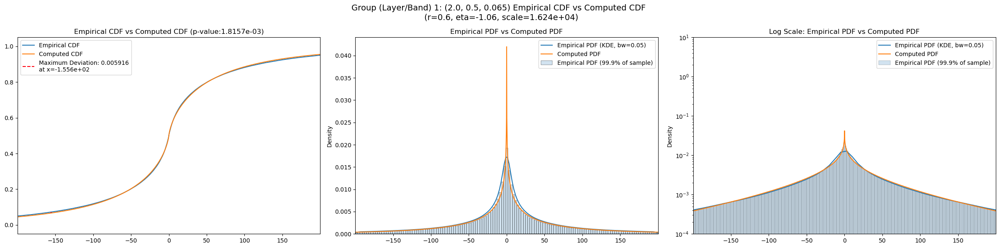

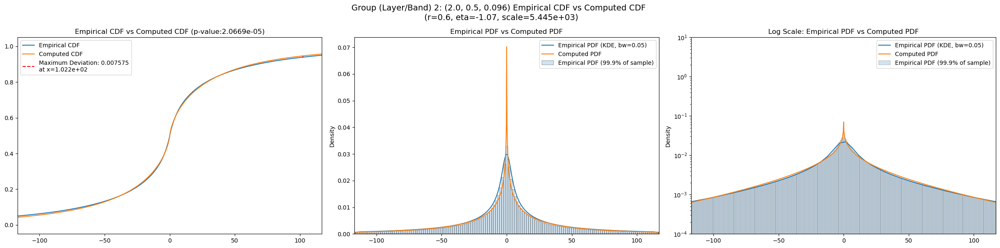

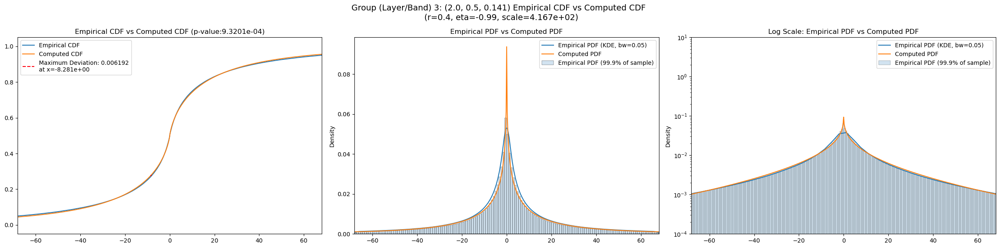

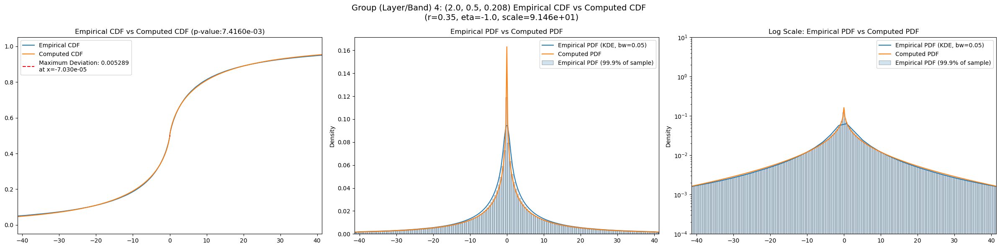

...

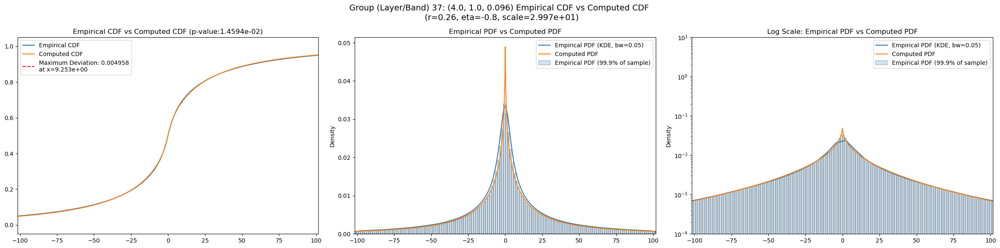

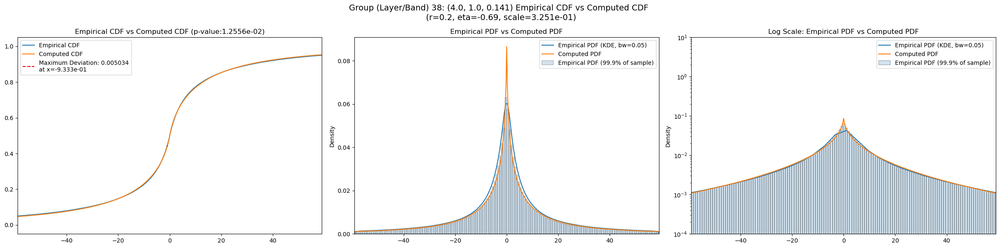

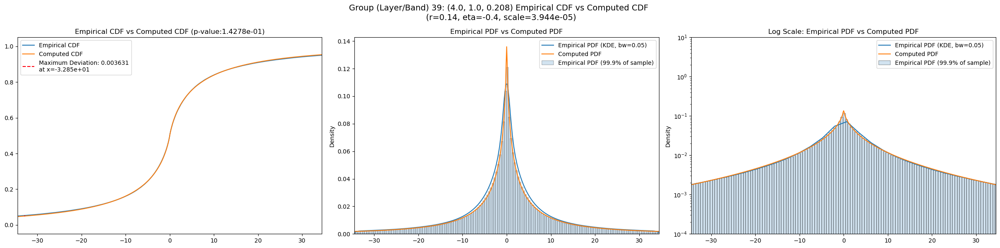

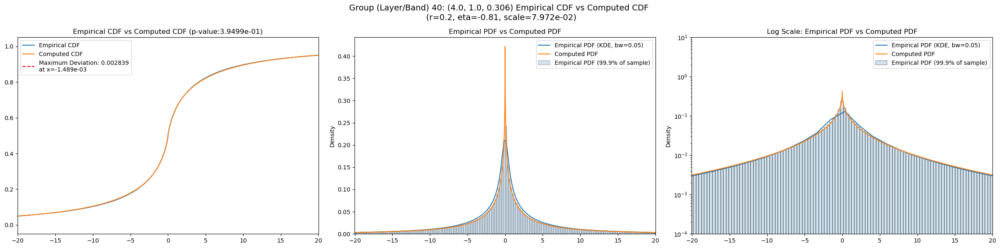

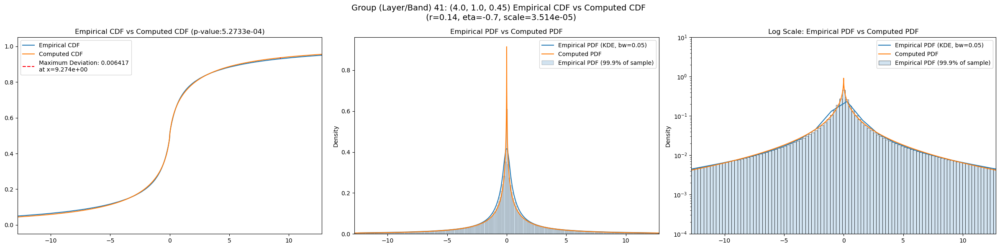

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",45245.52700,35149.957000,55858.81000,5.495759,3.202812,11.596157,65536000.0,"(2.0, 0.5, 0.044)",0.008383,...,120.70000,0.064133,0.0,103.61700,0.038188,0.0,82.46140,0.041306,0.0,0.0
1,"(2.0, 0.5, 0.065)",16159.34800,12461.857000,20982.10400,7.577845,4.145749,20.689200,65536000.0,"(2.0, 0.5, 0.065)",0.007421,...,63.27620,0.070539,0.0,54.50030,0.044651,0.0,42.83690,0.046523,0.0,0.0
2,"(2.0, 0.5, 0.096)",5922.31700,4530.947300,7658.35350,9.172287,4.752912,22.550383,65536000.0,"(2.0, 0.5, 0.096)",0.008738,...,35.61160,0.072258,0.0,30.82910,0.046115,0.0,24.15980,0.047315,0.0,0.0
3,"(2.0, 0.5, 0.141)",2186.18210,1604.981600,2941.15360,11.885174,6.001125,31.736656,65536000.0,"(2.0, 0.5, 0.141)",0.006204,...,19.99490,0.072736,0.0,17.42610,0.046608,0.0,13.56550,0.046823,0.0,0.0
4,"(2.0, 0.5, 0.208)",896.74567,626.061100,1207.41710,14.605139,7.902795,40.446873,65536000.0,"(2.0, 0.5, 0.208)",0.006376,...,11.69130,0.073054,0.0,10.20920,0.047402,0.0,7.88260,0.047190,0.0,0.0
5,"(2.0, 0.5, 0.306)",319.77920,214.653400,441.71838,17.831026,8.364756,54.464200,65536000.0,"(2.0, 0.5, 0.306)",0.008145,...,6.36888,0.075134,0.0,5.55181,0.049649,0.0,4.28128,0.049465,0.0,0.0
6,"(2.0, 0.5, 0.45)",201.80780,138.282550,288.14822,18.420538,9.052644,56.183180,65536000.0,"(2.0, 0.5, 0.45)",0.009422,...,4.82618,0.077797,0.0,4.21752,0.052270,0.0,3.25012,0.051661,0.0,0.0
7,"(2.0, 1.0, 0.044)",62793.04300,49965.652000,79623.72000,6.657730,3.644785,17.155079,65536000.0,"(2.0, 1.0, 0.044)",0.002730,...,145.01200,0.058306,0.0,124.71800,0.032237,0.0,99.25050,0.035381,0.0,0.0
8,"(2.0, 1.0, 0.065)",22699.83200,17202.203000,29541.35500,8.707811,4.386791,26.468680,65536000.0,"(2.0, 1.0, 0.065)",0.006087,...,77.39820,0.065069,0.0,66.65220,0.039051,0.0,52.72210,0.041516,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.008383,0.000168,0.005198,0.064133,0.038188,0.041306
1,0.007421,0.000168,0.005916,0.070539,0.044651,0.046523
2,0.008738,0.000168,0.007575,0.072258,0.046115,0.047315
3,0.006204,0.000168,0.006192,0.072736,0.046608,0.046823
4,0.006376,0.000168,0.005282,0.073054,0.047402,0.047190
5,0.008145,0.000168,0.008124,0.075134,0.049649,0.049465
6,0.009422,0.000168,0.009419,0.077797,0.052270,0.051661
7,0.002730,0.000168,0.002405,0.058306,0.032237,0.035381
8,0.006087,0.000168,0.003523,0.065069,0.039051,0.041516


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,44255.621094,0.005198,0.90,-1.07,91943.137003,25.0
1,16159.347656,0.005916,0.60,-1.06,16238.341251,0.0
2,5258.366211,0.007575,0.60,-1.07,5444.975410,150.0
3,2105.972656,0.006192,0.40,-0.99,416.743571,25.0
4,896.745667,0.005282,0.35,-1.00,91.458439,0.0
5,319.779205,0.008124,0.31,-1.00,15.160471,0.0
6,185.686508,0.009419,0.31,-1.00,8.803246,50.0
7,62793.042969,0.002405,0.72,-1.00,79051.535900,0.0
8,22699.832031,0.003523,0.54,-1.00,14464.082714,0.0
